In [1]:
import torch
import pandas as pd
import numpy as np
import anndata
from scipy.spatial import distance
import scanpy as sc
from collections import OrderedDict
from collections import defaultdict
from collections import Counter
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import tensorflow as tf
import os
import functools
from sklearn import metrics
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error, f1_score, roc_auc_score
from sklearn.model_selection import train_test_split
from sklearn.metrics import silhouette_samples, silhouette_score
from tqdm.notebook import tqdm
import scanpy as sc
from collections import Counter
import matplotlib.cm as cm
from anndata import AnnData
import itertools as it
from sklearn.decomposition import PCA
import seaborn as sns
from scipy.sparse import vstack
import time

### Common function 

In [316]:
import argparse
import torch.utils.data as data
import numpy as np
import torch

def get_parser():
    parser = argparse.ArgumentParser()
    
    parser.add_argument('-pretrain_batch', '--pretrain_batch',
                        type=int,
                        help='Batch size for pretraining. Default: no batch',
                        default=None)
    
    parser.add_argument('-pretrain','--pretrain',
                        type = bool,
                        default = True,
                        help='Pretrain model with autoencoder; otherwise load existing')
    
    parser.add_argument('-nepoch', '--epochs',
                        type=int,
                        help='number of epochs to train for',
                        default=30)

    parser.add_argument('-nepoch_pretrain', '--epochs_pretrain',
                        type=int,
                        help='number of epochs to pretrain for',
                        default=25)

    parser.add_argument('-source_file','--model_file',
                        type = str,
                        default = 'trained_models/source.pt',
                        help='location for storing source model and data')

    parser.add_argument('-lr', '--learning_rate',
                        type=float,
                        help='learning rate for the model, default=0.001',
                        default=0.001)

    parser.add_argument('-lrS', '--lr_scheduler_step',
                        type=int,
                        help='StepLR learning rate scheduler step, default=20',
                        default=20) 

    parser.add_argument('-lrG', '--lr_scheduler_gamma',
                        type=float,
                        help='StepLR learning rate scheduler gamma, default=0.5',
                        default=0.5)
  
    parser.add_argument('-seed', '--manual_seed',
                        type=int,
                        help='input for the manual seeds initializations',
                        default=3)
    
    parser.add_argument('--cuda',
                        action='store_true',
                        help='enables cuda')
    
    return parser


'''
Class representing dataset for an single-cell experiment.
'''

IMG_CACHE = {}


class ExperimentDataset(data.Dataset):
    
    
    def __init__(self, x, cells, genes, metadata, y=[]):
        '''
        x: numpy array of gene expressions of cells (rows are cells)
        cells: cell IDs in the order of appearance
        genes: gene IDs in the order of appearance
        metadata: experiment identifier
        y: numeric labels of cells (empty list if unknown)
        '''
        super(ExperimentDataset, self).__init__()
        
        self.nitems = x.shape[0]
        if len(y)>0:
            print("== Dataset: Found %d items " % x.shape[0])
            print("== Dataset: Found %d classes" % len(np.unique(y)))
                
        if type(x)==torch.Tensor:
            self.x = x
        else:
            shape = x.shape[1]
            self.x = [torch.from_numpy(inst).view(shape).float() for inst in x]
        if len(y)==0:
            y = np.zeros(len(self.x), dtype=np.int64)
        
        self.y = tuple(y.tolist())
        self.xIDs = cells
        self.yIDs = genes
        self.metadata = metadata
            
    def __getitem__(self, idx):
        return self.x[idx].squeeze(), self.y[idx], self.xIDs[idx]
    #, self.yIDs[idx]

    def __len__(self):
        return self.nitems
    
    def get_dim(self):
        return self.x[0].shape[0]

class EpochSampler(object):
    '''
    EpochSampler: yield permuted indexes at each epoch.
   
    __len__ returns the number of episodes per epoch (same as 'self.iterations').
    '''

    def __init__(self, indices):
        '''
        Initialize the EpochSampler object
        Args:
        - labels: an iterable containing all the labels for the current dataset
        samples indexes will be infered from this iterable.
        - iterations: number of epochs
        '''
        super(EpochSampler, self).__init__()
        
        self.indices = indices
        

    def __iter__(self):
        '''
        yield a batch of indexes
        '''
        
    
        while(True):
            shuffled_idx = self.indices[torch.randperm(len(self.indices))]
            
            yield shuffled_idx
            

    def __len__(self):
        '''
        returns the number of iterations (episodes) per epoch
        '''
        return self.iterations
    
import torch
from torch.utils.data import DataLoader ##prefetch by batch
#from model.epoch_sampler import EpochSampler


def init_labeled_loader(data, val_split = 0.8):
    """Initialize loaders for train and validation sets. 
    Class labels are used only
    for stratified sampling between train and validation set.
    
    Validation_split = % keeps in training set 
    
    """
    
    target = torch.tensor(list(data.y))
    uniq = torch.unique(target, sorted=True)
    
    class_idxs = list(map(lambda c: target.eq(c).nonzero(), uniq))
    class_idxs = [idx[torch.randperm(len(idx))] for idx in class_idxs]
    
    train_idx = torch.cat([idx[:int(val_split*len(idx))] for idx in class_idxs])
    val_idx = torch.cat([idx[int(val_split*len(idx)):] for idx in class_idxs])
    
    train_loader = DataLoader(data, 
                              batch_sampler=EpochSampler(train_idx),
                              pin_memory=True)
    
    val_loader = DataLoader(data, 
                            batch_sampler=EpochSampler(val_idx),
                            pin_memory=True)
    
    return train_loader, val_loader


def init_loader(datasets, val_split = 0.8):
    
    train_loader_all = []
    val_loader_all = []
    
    for data in datasets:
        
        curr_load_tr, curr_load_val = init_labeled_loader(data, val_split)
        train_loader_all.append(curr_load_tr)
        val_loader_all.append(curr_load_val)
    
    if val_split==1:
        val_loader_all = None
        
    return train_loader_all, val_loader_all


def init_data_loaders(labeled_data, unlabeled_data, 
                      pretrain_data, pretrain_batch, val_split):
    
    """Initialize loaders for pretraing, 
    training (labeled and unlabeled datasets) and validation. """
    
    train_loader, val_loader = init_loader(labeled_data, val_split)
    
    if not pretrain_data:
        pretrain_data = unlabeled_data
    
    pretrain_loader = torch.utils.data.DataLoader(dataset=pretrain_data,
                                                  shuffle=True,
                                                  batch_size=pretrain_batch if pretrain_batch!=None else len(unlabeled_data.x))        
    test_loader = DataLoader(unlabeled_data, 
                            batch_sampler=EpochSampler(torch.randperm(len(unlabeled_data.x))),
                            pin_memory=True) 
    
    #test_loader,_ = init_loader([unlabeled_data], 1.0) # to reproduce results in the paper
    #test_loader = test_loader[0]
    return train_loader, test_loader, pretrain_loader, val_loader
           
           
def euclidean_dist(x, y):
    '''
    Compute euclidean distance between two tensors
    '''
    # x: N x D
    # y: M x D
    n = x.size(0)
    m = y.size(0)
    d = x.size(1)
    if d != y.size(1):
        raise Exception

    x = x.unsqueeze(1).expand(n, m, d)
    y = y.unsqueeze(0).expand(n, m, d)

    return torch.pow(x - y, 2).sum(2)

import numpy as np
import sklearn.metrics as metrics
from scipy.optimize import linear_sum_assignment 

def compute_scores(y_true, y_pred, scoring={'accuracy','precision','recall','nmi',
                                                'adj_rand','f1_score','adj_mi'}):
    y_true = y_true.cpu().numpy()
    y_pred = y_pred.cpu().numpy()
    
    scores = {}
    y_true, y_pred = hungarian_match(y_true, y_pred)
    set_scores(scores, y_true, y_pred, scoring)
        
    return scores


def set_scores(scores, y_true, y_pred, scoring):
    labels=list(set(y_true))
    
    for metric in scoring:
        if metric=='accuracy':
            scores[metric] = metrics.accuracy_score(y_true, y_pred)
        elif metric=='precision':
            scores[metric] = metrics.precision_score(y_true, y_pred, labels, average='macro')
        elif metric=='recall':
            scores[metric] = metrics.recall_score(y_true, y_pred, labels, average='macro')
        elif metric=='f1_score':
            scores[metric] = metrics.f1_score(y_true, y_pred, labels, average='macro')
        elif metric=='nmi':
            scores[metric] = metrics.normalized_mutual_info_score(y_true, y_pred)
        elif metric=='adj_mi':
            scores[metric] = metrics.adjusted_mutual_info_score(y_true, y_pred)
        elif metric=='adj_rand':
            scores[metric] = metrics.adjusted_rand_score(y_true, y_pred)
                
                
def hungarian_match(y_true, y_pred):
    """Matches predicted labels to original using hungarian algorithm."""
    
    y_true = adjust_range(y_true)
    y_pred = adjust_range(y_pred)
    
    D = max(y_pred.max(), y_true.max()) + 1
    w = np.zeros((D, D), dtype=np.int64)
    # Confusion matrix.
    for i in range(y_pred.size):
        w[y_pred[i], y_true[i]] += 1
    ind = linear_sum_assignment(-w)
    ind = np.asarray(ind)
    ind = np.transpose(ind)
    d = {i:j for i, j in ind}
    y_pred = np.array([d[v] for v in y_pred])
    
    return y_true, y_pred


def adjust_range(y):
    """Assures that the range of indices if from 0 to n-1."""
    y = np.array(y, dtype=np.int64)
    val_set = set(y)
    mapping = {val:i for  i,val in enumerate(val_set)}
    y = np.array([mapping[val] for val in y], dtype=np.int64)
    return y

### AE_MARS

In [317]:
import torch.nn as nn
import numpy as np
import torch
#from sklearn.cluster import k_means_
from sklearn.cluster import KMeans
import torch
from torch.nn import functional as F

#from model.utils import euclidean_dist

class EpochSampler(object):
    '''
    EpochSampler: yield permuted indexes at each epoch.
   
    __len__ returns the number of episodes per epoch (same as 'self.iterations').
    '''

    def __init__(self, indices):
        '''
        Initialize the EpochSampler object
        Args:
        - labels: an iterable containing all the labels for the current dataset
        samples indexes will be infered from this iterable.
        - iterations: number of epochs
        '''
        super(EpochSampler, self).__init__()
        self.indices = indices
        

    def __iter__(self):
        '''
        yield a batch of indexes
        '''
        
        while(True):
            shuffled_idx = self.indices[torch.randperm(len(self.indices))]
            
            yield shuffled_idx
            

    def __len__(self):
        '''
        returns the number of iterations (episodes) per epoch
        '''
        return self.iterations

def init_labeled_loader(data, val_split = 0.8):
    """Initialize loaders for train and validation sets. 
    Class labels are used only
    for stratified sampling between train and validation set."""
    
    target = torch.tensor(list(data.y))
    uniq = torch.unique(target, sorted=True)
    
    class_idxs = list(map(lambda c: target.eq(c).nonzero(), uniq))
    class_idxs = [idx[torch.randperm(len(idx))] for idx in class_idxs]
    
    train_idx = torch.cat([idx[:int(val_split*len(idx))] for idx in class_idxs])
    val_idx = torch.cat([idx[int(val_split*len(idx)):] for idx in class_idxs])
    
    train_loader = DataLoader(data, 
                              batch_sampler=EpochSampler(train_idx),
                              pin_memory=True)
    
    val_loader = DataLoader(data, 
                            batch_sampler=EpochSampler(val_idx),
                            pin_memory=True)
    
    return train_loader, val_loader


def init_loader(datasets, val_split = 0.8):
    
    train_loader_all = []
    val_loader_all = []
    
    for data in datasets:
        
        curr_load_tr, curr_load_val = init_labeled_loader(data, val_split)
        train_loader_all.append(curr_load_tr)
        val_loader_all.append(curr_load_val)
    
    if val_split==1:
        val_loader_all = None
        
    return train_loader_all, val_loader_all


def init_data_loaders(labeled_data, unlabeled_data, 
                      pretrain_data, pretrain_batch, val_split):
    
    """Initialize loaders for pretraing, 
    training (labeled and unlabeled datasets) and validation. """
    
    train_loader, val_loader = init_loader(labeled_data, val_split)
    
    if not pretrain_data:
        pretrain_data = unlabeled_data
    
    pretrain_loader = torch.utils.data.DataLoader(dataset=pretrain_data, shuffle=True,
                                                  batch_size=pretrain_batch if pretrain_batch!=None else len(unlabeled_data.x))        
    test_loader = DataLoader(unlabeled_data, 
                            batch_sampler=EpochSampler(torch.randperm(len(unlabeled_data.x))),
                            pin_memory=True) 
    
    #test_loader,_ = init_loader([unlabeled_data], 1.0) # to reproduce results in the paper
    #test_loader = test_loader[0]
    return train_loader, test_loader, pretrain_loader, val_loader
           
           
def euclidean_dist(x, y):
    '''
    Compute euclidean distance between two tensors
    '''
    # x: N x D
    # y: M x D
    n = x.size(0)
    m = y.size(0)
    d = x.size(1)
    if d != y.size(1):
        raise Exception

    x = x.unsqueeze(1).expand(n, m, d)
    y = y.unsqueeze(0).expand(n, m, d)

    return torch.pow(x - y, 2).sum(2)

def loss_task(encoded, prototypes, target, criterion='dist'):
    """Calculate loss.
    criterion: NNLoss - assign to closest prototype and calculate NNLoss
    dist - loss is distance to prototype that example needs to be assigned to
                and -distance to prototypes from other class
    """
    
    uniq = torch.unique(target, sorted=True)
    
    ###index of samples for each class of labels
    class_idxs = list(map(lambda c: target.eq(c).nonzero(), uniq))
    
    # prepare targets so they start from 0,1
    for idx,v in enumerate(uniq):
        target[target==v]=idx
    
    dists = euclidean_dist(encoded, prototypes)
    
    if criterion=='NNLoss':
       
        loss = torch.nn.NLLLoss()
        log_p_y = F.log_softmax(-dists, dim=1)
        
        loss_val = loss(log_p_y, target)
        _, y_hat = log_p_y.max(1)
        
    
    elif criterion=='dist':
        
        loss_val = torch.stack([dists[idx_example, idx_proto].mean(0) for idx_proto,idx_example in enumerate(class_idxs)]).mean()
        #loss_val1 = loss_val1/len(embeddings) 
        y_hat = torch.max(-dists,1)[1]
        
    acc_val = y_hat.eq(target.squeeze()).float().mean()    
        
    return loss_val, acc_val

def loss_test_nn(encoded, prototypes):
    dists = euclidean_dist(encoded, prototypes)
    min_dist = torch.min(dists, 1)
    
    y_hat = min_dist[1]
    args_uniq = torch.unique(y_hat, sorted=True)
    args_count = torch.stack([(y_hat==x_u).sum() for x_u in args_uniq])
    print(args_count)
    
    loss = torch.nn.NLLLoss()
    log_p_y = F.log_softmax(-dists, dim=1)
    print(log_p_y.shape)
        
    loss_val = loss(log_p_y, y_hat)
    _, y_hat = log_p_y.max(1)
    
    return loss_val, args_count

###Intra cluster distance
def loss_test_basic(encoded, prototypes):
    dists = euclidean_dist(encoded, prototypes)
    min_dist = torch.min(dists, 1)
    
    y_hat = min_dist[1]
    args_uniq = torch.unique(y_hat, sorted=True)
    args_count = torch.stack([(y_hat==x_u).sum() for x_u in args_uniq])
    #print(args_count)
    
    min_dist = min_dist[0] # get_distances
    
    #thr = torch.stack([torch.sort(min_dist[y_hat==idx_class])[0][int(len(min_dist[y_hat==idx_class])*0.9)] for idx_class in args_uniq])
    #loss_val = torch.stack([min_dist[y_hat==idx_class][min_dist[y_hat==idx_class]>=thr[idx_class]].mean(0) for idx_class in args_uniq]).mean()
    
    loss_val = torch.stack([min_dist[y_hat==idx_class].mean(0) for idx_class in args_uniq]).mean()
    
    #loss_val,_ = loss_task(encoded, prototypes, y_hat, criterion='dist') # same
    
    return loss_val, args_count

def loss_test(encoded, prototypes, tau):
    #prototypes = torch.stack(prototypes).squeeze() 
    loss_val_test, args_count = loss_test_basic(encoded, prototypes)
    
    
    ###inter cluster distance 
    if tau>0:
        dists = euclidean_dist(prototypes, prototypes)
        nproto = prototypes.shape[0]
        loss_val2 = - torch.sum(dists)/(nproto*nproto-nproto)
        
        loss_val_test += tau*loss_val2
        
    return loss_val_test, args_count

def reconstruction_loss(decoded, x):
    loss_func = torch.nn.MSELoss()
    loss_rcn = loss_func(decoded, x)
    #print('Reconstruction {}'.format(loss_rcn))
    
    return loss_rcn

#############################################
#############################################
def compute_landmarks_tr(embeddings, target, prev_landmarks=None, tau=0.2):
    
    """Computing landmarks of each class in the labeled meta-dataset. 
    
    Landmark is a closed form solution of 
    minimizing distance to the mean and maximizing distance to other landmarks. 
    
    If tau=0, landmarks are just mean of data points.
    
    embeddings: embeddings of the labeled dataset
    target: labels in the labeled dataset
    prev_landmarks: landmarks from previous iteration
    tau: regularizer for inter- and intra-cluster distance
    """
    
    uniq = torch.unique(target, sorted=True)
    class_idxs = list(map(lambda c: target.eq(c).nonzero(), uniq))
    
    landmarks_mean = torch.stack([embeddings[idx_class].mean(0) for idx_class in class_idxs]).squeeze()
    
    if prev_landmarks is None or tau==0:
        return landmarks_mean
    
    suma = prev_landmarks.sum(0)
    nlndmk = prev_landmarks.shape[0]
    lndmk_dist_part = (tau/(nlndmk-1))*torch.stack([suma-p for p in prev_landmarks])
    landmarks = 1/(1-tau)*(landmarks_mean-lndmk_dist_part)
    
    return landmarks

#############################################
#############################################


def init_landmarks(n_clusters, tr_load, test_load, model, device, mode='kmeans', pretrain=True):
    """Initialization of landmarks of the labeled and unlabeled meta-dataset.
    nclusters: number of expected clusters in the unlabeled meta-dataset
    tr_load: data loader for labeled meta-dataset
    test_load: data loader for unlabeled meta-dataset
    """
    lndmk_tr = [torch.zeros(size=(len(np.unique(dl.dataset.y)), model.z_dim), 
                            requires_grad=True, device=device) for dl in tr_load]
    
    lndmk_test = [torch.zeros(size=(1, model.z_dim), 
                              requires_grad=True, device=device) 
                       for _ in range(n_clusters)]
    
    kmeans_init_tr = [init_step(dl.dataset, model, device, pretrained=pretrain, mode=mode) 
                      for dl in tr_load]
    
    kmeans_init_test = init_step(test_load.dataset, model, device, 
                                 pretrained=pretrain, mode=mode, 
                                 n_clusters=n_clusters)
    
    ##No gradient calculation
    with torch.no_grad():
        [lndmk.copy_(kmeans_init_tr[idx])  for idx,lndmk in enumerate(lndmk_tr)]
        [lndmk_test[i].copy_(kmeans_init_test[i,:]) for i in range(kmeans_init_test.shape[0])]
        
    return lndmk_tr, lndmk_test


def init_step(dataset, model, device, pretrained, mode='kmeans',n_clusters=None):
    """Initialization of landmarks with k-means or k-means++ given dataset."""
    
    if n_clusters==None:
        n_clusters = len(np.unique(dataset.y))
    nexamples = len(dataset.x)
        
    X =  torch.stack([dataset.x[i] for i in range(nexamples)])
    
    if mode=='kmeans++':
        if not pretrained: # find centroids in original space
            landmarks = k_means_._init_centroids(X.cpu().numpy(), n_clusters, 'k-means++')
            landmarks = torch.tensor(landmarks, device=device)
            landmarks = landmarks.to(device)
            lndmk_encoded,_ = model(landmarks)
            
        else:
            X = X.to(device)
            encoded,_ = model(X)
            landmarks = k_means_._init_centroids(encoded.data.cpu().numpy(), n_clusters, 'k-means++')
            lndmk_encoded = torch.tensor(landmarks, device=device)
    
    elif mode=='kmeans': # run kmeans clustering
        if not pretrained: 
            kmeans = KMeans(n_clusters, random_state=0).fit(X.cpu().numpy())
            landmarks = torch.tensor(kmeans.cluster_centers_, device=device)
            landmarks = landmarks.to(device)
            ##Feed forward net on landmarks  (k means cluster)
            ##landmarks are k means cluster centers = coordinates of cluster center
            lndmk_encoded,_ = model(landmarks)
        
        ##cluster on lower embedding space
        else:
            X = X.to(device)
            encoded,_ = model(X)
            kmeans = KMeans(n_clusters, random_state=0).fit(encoded.data.cpu().numpy())
            lndmk_encoded = torch.tensor(kmeans.cluster_centers_, device=device)
    
    return lndmk_encoded


def full_block(in_features, out_features, p_drop):
        return nn.Sequential(
            nn.Linear(in_features, out_features, bias=True),
            nn.LayerNorm(out_features),
            nn.ELU(),
            nn.Dropout(p=p_drop),
        )

class FullNet(nn.Module):
    '''
    '''
    def __init__(self, x_dim, hid_dim=64, z_dim=64, p_drop=0.2):
        super(FullNet, self).__init__()
        
        self.z_dim = z_dim
        
        self.encoder = nn.Sequential(
            full_block(x_dim, hid_dim, p_drop),
            full_block(hid_dim, z_dim, p_drop),
        )
        
        self.decoder = nn.Sequential(
            full_block(z_dim, hid_dim, p_drop),
            full_block(hid_dim, x_dim, p_drop),
        )
      
    def forward(self, x):
        
        encoded = self.encoder(x)
        decoded = self.decoder(encoded)
        
        return encoded, decoded


class AE_MARS:
    def __init__(self, n_clusters, params, 
                 labeled_data, unlabeled_data, 
                 pretrain_data=None, 
                 val_split=1.0, hid_dim_1=1000, hid_dim_2=100, p_drop=0.0, tau=0.2):
        """Initialization of MARS.
        n_clusters: number of clusters in the unlabeled meta-dataset
        params: parameters of the MARS model
        labeled_data: list of labeled datasets. Each dataset needs to be instance of CellDataset.
        unlabeled_data: unlabeled dataset. Instance of CellDataset.
        pretrain_data: dataset for pretraining MARS. Instance of CellDataset. If not specified, unlabeled_data
                        will be used.
        val_split: percentage of data to use for train/val split (default: 1, meaning no validation set)
        hid_dim_1: dimension in the first layer of the network (default: 1000)
        hid_dim_2: dimension in the second layer of the network (default: 100)
        p_drop: dropout probability (default: 0)
        tau: regularizer for inter-cluster distance
        """
        train_load, test_load, pretrain_load, val_load = init_data_loaders(labeled_data, unlabeled_data, 
                                                                           pretrain_data, params.pretrain_batch, 
                                                                           val_split)
        self.train_loader = train_load
        self.test_loader = test_load
        self.pretrain_loader = pretrain_load
        self.val_loader = val_load
        
        ##data file type (string name)
        self.labeled_metadata = [data.metadata for data in labeled_data]
        self.unlabeled_metadata = unlabeled_data.metadata
        
        self.genes = unlabeled_data.yIDs
        
        ##number of genes 
        x_dim = self.test_loader.dataset.get_dim()
        
        ##Feed forward neural net
        self.init_model(x_dim, hid_dim_1, hid_dim_2, p_drop, params.device)
        
        self.n_clusters = n_clusters
        
        self.device = params.device
        self.epochs = params.epochs
        self.epochs_pretrain = params.epochs_pretrain
        self.pretrain_flag = params.pretrain
        self.model_file = params.model_file
        self.lr = params.learning_rate
        self.lr_gamma = params.lr_scheduler_gamma
        self.step_size = params.lr_scheduler_step
        
        self.tau = tau
        
    ###################################################################
    ###################################################################    
    ###### With the fine tuned hyper parameter     
    ###### Change the implementation of AE to VAE     
    def init_model(self, x_dim, hid_dim, z_dim, p_drop, device):
        """
        Initialize the model.
        """
        self.model = FullNet(x_dim, hid_dim, z_dim, p_drop).to(device)
    
    ###################################################################
    ###################################################################
    
    def init_optim(self, param1, param2, learning_rate):
        """Initializing optimizers."""
        
        optim = torch.optim.Adam(params=param1, lr=learning_rate)
        optim_landmk_test = torch.optim.Adam(params=param2, lr=learning_rate)
        
        return optim, optim_landmk_test
    
    ###################################################################
    ###################################################################
    ########Will need to alter this part for VAE (KL + reconstruction loss + regularized)
    def pretrain(self, optim):
        """
        Pretraining model with autoencoder.
        optim: optimizer
        """
        print('Pretraining..')
        
        for e in range(self.epochs_pretrain):
            
            start = time.time()
            epoch_loss = 0
            for _, batch in enumerate(self.pretrain_loader):
                x,_,_ = batch
                x = x.to(self.device)
                _, decoded = self.model(x)
                loss = reconstruction_loss(decoded, x) 
                optim.zero_grad()              
                loss.backward()                    
                optim.step() 
                
                epoch_loss += loss 
                
            print(f"Pretraining Epoch {e}, Loss: {epoch_loss}")
            print("Time: ", time.time()-start)
        
        print("Pretraining done")
            
    ###################################################################
    ###################################################################
    
    
    def train(self, evaluation_mode=True, save_all_embeddings=True):
        """Train model.
        evaluation_mode: if True, validates model on the unlabeled dataset. 
        In the evaluation mode, ground truth labels of the unlabeled dataset must be 
        provided to validate model
        
        save_all_embeddings: if True, MARS embeddings for annotated and unannotated 
        experiments will be saved in an anndata object,
        otherwise only unnanotated will be saved. 
        If naming is called after, all embeddings need to be saved
        
        return: adata: anndata object containing labeled and unlabeled meta-dataset 
        with MARS embeddings and estimated labels on the unlabeled dataset
                landmk_all: landmarks of the labeled and unlabeled meta-dataset in the 
                order given for training. Landmarks on the unlabeled
                            dataset are provided last
                metrics: clustering metrics if evaluation_mode is True
                
        """
        tr_iter = [iter(dl) for dl in self.train_loader]
        
        if self.val_loader is not None:
            val_iter = [iter(dl) for dl in self.val_loader]
        
        ####Pre train step 
        optim_pretrain = torch.optim.Adam(params=list(self.model.parameters()), lr=self.lr)
        if self.pretrain_flag:
            self.pretrain(optim_pretrain)
        else:
            self.model.load_state_dict(torch.load(self.MODEL_FILE))    
        ####
        
        test_iter = iter(self.test_loader)
        
        
        ##initialize training (annotated landmark) and testing (unannotated landmark)
        landmk_tr, landmk_test = init_landmarks(self.n_clusters, 
                                                self.train_loader, 
                                                self.test_loader, 
                                                self.model, self.device)
        
        optim, optim_landmk_test = self.init_optim(list(self.model.encoder.parameters()), 
                                                   landmk_test, self.lr)
        
        lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer=optim,
                                                       gamma=self.lr_gamma,
                                                       step_size=self.step_size)
        
        latent_tracker = []
        training_history = {'Loss':[],'Accuracy':[], 'Loss_tracker':[]}
        
        best_acc = 0
        for epoch in range(1, self.epochs+1):
            
            ##Set model for training
            self.model.train()
            start = time.time()
            ##This is equivalent to train step 
            loss_tr, acc_tr, landmk_tr, landmk_test, latent_history, loss_tracker = self.do_epoch(tr_iter, 
                                                                                    test_iter,
                                                                                    optim, 
                                                                                    optim_landmk_test,
                                                                                    landmk_tr, 
                                                                                    landmk_test)
            ##Loss training includes 2- embedding and landmark distance 
            print(f'Epoch {epoch} Loss training: {loss_tr}, Accuracy training: {acc_tr}')
            
            ###Track model training 
            training_history['Loss'].append(loss_tr)
            training_history['Accuracy'].append(acc_tr)
            training_history['Loss_tracker'].append(loss_tracker)
            
            latent_tracker.append(latent_history)
            
            print('Time: ', time.time()-start)
            
            if epoch==self.epochs: 
                print('\n=== Epoch: {} ==='.format(epoch))
                print('Train acc: {}'.format(acc_tr))
            if self.val_loader is None:
                continue
            self.model.eval()
            ##Stop training 
            
            with torch.no_grad():
                loss_val,acc_val = self.do_val_epoch(val_iter, landmk_tr)
                if acc_val > best_acc:
                    print('Saving model...')
                    best_acc = acc_val
                    best_state = self.model.state_dict()
                    #torch.save(model.state_dict(), self.model_file)
                postfix = ' (Best)' if acc_val >= best_acc else ' (Best: {})'.format(best_acc)
                print('Val loss: {}, acc: {}{}'.format(loss_val, acc_val, postfix))
            lr_scheduler.step()
            
        if self.val_loader is None:
            best_state = self.model.state_dict() # best is last
        
        landmk_all = landmk_tr+[torch.stack(landmk_test).squeeze()]
        
        ##Test time (assign labels to unlabaled data)
        adata_test, eval_results = self.assign_labels(landmk_all[-1], evaluation_mode)
        
        adata = self.save_result(tr_iter, adata_test, save_all_embeddings)
        
        if evaluation_mode:
            return adata, landmk_all, eval_results, training_history, latent_tracker
        
        return adata, landmk_all, training_history, latent_tracker
    
    def save_result(self, tr_iter, adata_test, save_all_embeddings):
        """Saving embeddings from labeled and unlabeled dataset, ground truth labels and 
        predictions to joint anndata object."""
        adata_all = []

        if save_all_embeddings:
            for task in range(len(tr_iter)): # saving embeddings from labeled dataset
                task = int(task)
                x, y, cells = next(tr_iter[task])
                x, y = x.to(self.device), y.to(self.device)
                encoded,_ = self.model(x)
                adata_all.append(self.pack_anndata(x, cells, encoded, gtruth=y))
            
        adata_all.append(adata_test)    
        
        if save_all_embeddings:
            adata = adata_all[0].concatenate(adata_all[1:], 
                                             batch_key='experiment',
                                             batch_categories=self.labeled_metadata+[self.unlabeled_metadata])
        else:
            adata = adata_all[0]

            
        adata.obsm['MARS_embedding'] = np.concatenate([a.uns['MARS_embedding'] for a in adata_all])
        #adata.write('result_adata.h5ad')
        
        return adata
    
    def assign_labels(self, landmk_test, evaluation_mode):
        """Assigning cluster labels to the unlabeled meta-dataset.
        test_iter: iterator over unlabeled dataset
        landmk_test: landmarks in the unlabeled dataset
        evaluation mode: computes clustering metrics if True
        """
        #test_iter = iter(self.test_loader)
            
        torch.no_grad()
        self.model.eval() # eval mode
        
        test_iter = iter(self.test_loader)
        
        x_test, y_true, cells = next(test_iter) # cells are needed because dataset is in random order
        x_test = x_test.to(self.device)
        
        encoded_test,_ = self.model(x_test)
        
        ###Embedding space eucledian distance 
        dists = euclidean_dist(encoded_test, landmk_test)
        
        ###Prediction based on the minimal distance to learned landmark
        y_pred = torch.min(dists, 1)[1]
        
        adata = self.pack_anndata(x_test, cells, encoded_test, y_true, y_pred)
        
        eval_results = None
        if evaluation_mode:
            eval_results = compute_scores(y_true, y_pred)
            
        return adata, eval_results
    
    
    def pack_anndata(self, x_input, cells, embedding, gtruth=[], estimated=[]):
        """Pack results in anndata object.
        x_input: gene expressions in the input space
        cells: cell identifiers
        embedding: resulting embedding of x_test using MARS
        landmk: MARS estimated landmarks
        gtruth: ground truth labels if available (default: empty list)
        estimated: MARS estimated clusters if available (default: empty list)
        """
        adata = anndata.AnnData(x_input.data.cpu().numpy())
        adata.obs_names = cells
        adata.var_names = self.genes
        if len(estimated)!=0:
            adata.obs['MARS_labels'] = pd.Categorical(values=estimated.cpu().numpy())
        if len(gtruth)!=0:
            adata.obs['truth_labels'] = pd.Categorical(values=gtruth.cpu().numpy())
        adata.uns['MARS_embedding'] = embedding.data.cpu().numpy()
        
        return adata
    
    
    def do_epoch(self, tr_iter, test_iter, optim, optim_landmk_test, landmk_tr, landmk_test):
        """
        One training epoch.
        tr_iter: iterator over labeled meta-data
        test_iter: iterator over unlabeled meta-data
        
        optim: optimizer for embedding
        optim_landmk_test: optimizer for test landmarks
        
        landmk_tr: landmarks of labeled meta-data from previous epoch
        landmk_test: landmarks of unlabeled meta-data from previous epoch
        """
        
        latent_history = {'Train_latent':[], 'Train_label':[],
                          'Test_latent':[], 'Test_label':[], 
                          'Train_landmark':[], 'Test_landmark':[]}
        
        loss_tracker = {'Test_anno':0,
                        'Train_latent_loss':0, 'Train_reconstr_loss': 0, 
                        'Test_latent_loss':0, 'Test_reconstr_loss': 0}
        
        
        self.set_requires_grad(False)
        
        for landmk in landmk_test:
            landmk.requires_grad=False
        
        optim_landmk_test.zero_grad()
        
        # update centroids    
        task_idx = torch.randperm(len(tr_iter)) ##shuffle per epoch
        
        ###Annotated landmark 
        for task in task_idx:
            
            task = int(task)
            x, y, _ = next(tr_iter[task])
            x, y = x.to(self.device), y.to(self.device)
            encoded,_ = self.model(x)
            
            curr_landmk_tr = compute_landmarks_tr(encoded, y, landmk_tr[task], tau=self.tau)
            landmk_tr[task] = curr_landmk_tr.data # save landmarks
            
            latent_history['Train_landmark'].append(encoded)
            latent_history['Train_label'].append(y)
            
        ###Unannotated landmark
        for landmk in landmk_test:
            landmk.requires_grad=True
            
        x,y_test,_ = next(test_iter)
        x = x.to(self.device)
        encoded,_ = self.model(x)
        loss, args_count = loss_test(encoded, 
                                     torch.stack(landmk_test).squeeze(), 
                                     self.tau)
        loss.backward()
        optim_landmk_test.step()
        
        latent_history['Test_landmark'].append(encoded)
        latent_history['Test_label'].append(y_test)
        loss_tracker['Test_anno'] = loss
        
        # update embedding
        self.set_requires_grad(True)
        for landmk in landmk_test:
            landmk.requires_grad=False
            
        optim.zero_grad()
        total_accuracy = 0
        total_loss = 0
        ntasks = 0
        mean_accuracy = 0
        
        ###Annotated set
        task_idx = torch.randperm(len(tr_iter))
        for task in task_idx:
            task = int(task)
            x, y, _ = next(tr_iter[task])
            x, y = x.to(self.device), y.to(self.device)
            encoded, decoded = self.model(x)
            ###Eucledian distance between embedding and landmark
            loss, acc = loss_task(encoded, landmk_tr[task], y, criterion='dist')
            total_loss += loss
            total_accuracy += acc.item()
            ntasks += 1
            latent_history['Train_latent'].append(encoded)
            
            loss_tracker['Train_latent_loss'] = loss
            loss_tracker['Train_reconstr_loss'] = reconstruction_loss(decoded, x)
            
        if ntasks>0:
            mean_accuracy = total_accuracy / ntasks
        
        ##Un-Annotated
        # test part
        x,y,_ = next(test_iter)
        x = x.to(self.device)
        encoded, decoded = self.model(x)
        loss,_ = loss_test(encoded, torch.stack(landmk_test).squeeze(), self.tau)
        latent_history['Test_latent'].append(encoded)
        
        loss_tracker['Test_latent_loss'] = loss
        loss_tracker['Test_reconstr_loss'] = reconstruction_loss(decoded, x)
        
        total_loss += loss
        ntasks += 1
    
        mean_loss = total_loss / ntasks
        
        mean_loss.backward()
        optim.step()
        
        return mean_loss, mean_accuracy, landmk_tr, landmk_test, latent_history, loss_tracker
    
    def do_val_epoch(self, val_iter, prev_landmk):
        """One epoch of validation.
        val_iter: iterator over validation set
        prev_landmk: landmarks from previous epoch
        """
        ntasks = len(val_iter)
        task_idx = torch.randperm(ntasks)
        
        total_loss = 0
        total_accuracy = 0
        
        for task in task_idx:
            x, y, _ = next(val_iter[task])
            x, y = x.to(self.device), y.to(self.device)
            encoded = self.model(x)
            loss, acc = loss_task(encoded, prev_landmk[task], y, criterion='dist')
            total_loss += loss
            total_accuracy += acc.item()
        mean_accuracy = total_accuracy / ntasks
        mean_loss = total_loss / ntasks
        
        return mean_loss, mean_accuracy
    
    
    def set_requires_grad(self, requires_grad):
        for param in self.model.parameters():
            param.requires_grad = requires_grad
    
    def name_cell_types(self, adata, landmk_all, cell_name_mappings, 
                        top_match=5, umap_reduce_dim=True, ndim=10):
        """For each test cluster, estimate sigma and mean. 
        Fit Gaussian distribution with that mean and sigma
        and calculate the probability of each of the train landmarks 
        to be the neighbor to the mean data point.
        Normalization is performed with regards to all other landmarks in train."""
        
        experiments = list(OrderedDict.fromkeys(list(adata.obs['experiment'])))
        
        encoded_tr = []
        landmk_tr = []
        landmk_tr_labels = []
        for idx, exp in enumerate(experiments[:-1]):
            tiss = adata[adata.obs['experiment'] == exp,:]
            
            if exp==self.unlabeled_metadata: 
                raise ValueError("Error: Unlabeled dataset needs to be last one in the input anndata object.")
                
            encoded_tr.append(tiss.obsm['MARS_embedding'])
            landmk_tr.append(landmk_all[idx])
            landmk_tr_labels.append(np.unique(tiss.obs['truth_labels']))
            
        tiss = adata[adata.obs['experiment'] == self.unlabeled_metadata,:]
        ypred_test = tiss.obs['MARS_labels']
        uniq_ytest = np.unique(ypred_test)
        encoded_test = tiss.obsm['MARS_embedding']
        
        landmk_tr_labels = np.concatenate(landmk_tr_labels)
        encoded_tr = np.concatenate(encoded_tr)
        landmk_tr = np.concatenate([p.cpu() for p in landmk_tr])
        if  umap_reduce_dim:
            encoded_extend = np.concatenate((encoded_tr, encoded_test, landmk_tr))
            adata = anndata.AnnData(encoded_extend)
            sc.pp.neighbors(adata, n_neighbors=15, use_rep='X')
            sc.tl.umap(adata, n_components=ndim)
            encoded_extend = adata.obsm['X_umap']
            n1 = len(encoded_tr)
            n2 = n1 + len(encoded_test)
            encoded_tr = encoded_extend[:n1,:]
            encoded_test = encoded_extend[n1:n2,:]
            landmk_tr = encoded_extend[n2:,:]
        
        interp_names = defaultdict(list)
        for ytest in uniq_ytest:
            print('\nCluster label: {}'.format(str(ytest)))
            idx = np.where(ypred_test==ytest)
            subset_encoded = encoded_test[idx[0],:]
            mean = np.expand_dims(np.mean(subset_encoded, axis=0),0)
            
            sigma  = self.estimate_sigma(subset_encoded)
            
            prob = np.exp(-np.power(distance.cdist(mean, landmk_tr, metric='euclidean'),2)/(2*sigma*sigma))
            prob = np.squeeze(prob, 0)
            normalizat = np.sum(prob)
            if normalizat==0:
                print('Unassigned')
                interp_names[ytest].append("unassigned")
                continue
            
            prob = np.divide(prob, normalizat)
            
            uniq_tr = np.unique(landmk_tr_labels)
            prob_unique = []
            for cell_type in uniq_tr: # sum probabilities of same landmarks
                prob_unique.append(np.sum(prob[np.where(landmk_tr_labels==cell_type)]))
            
            sorted = np.argsort(prob_unique, axis=0)
            best = uniq_tr[sorted[-top_match:]]
            sortedv = np.sort(prob_unique, axis=0)
            sortedv = sortedv[-top_match:]
            for idx, b in enumerate(best):
                interp_names[ytest].append((cell_name_mappings[b], sortedv[idx]))
                print('{}: {}'.format(cell_name_mappings[b], sortedv[idx]))
                
        return interp_names
    
    
    def estimate_sigma(self, dataset):
        nex = dataset.shape[0]
        dst = []
        for i in range(nex):
            for j in range(i+1, nex):
                dst.append(distance.euclidean(dataset[i,:],dataset[j,:]))
        return np.std(dst)

In [324]:
def MARS_loss_tracker (training_history, save):
    
    loss = pd.DataFrame.from_dict(training_history['Loss_tracker'])
    epochs = loss.shape[0]
    
    fig, ax = plt.subplots(1,2, figsize=(11, 6.5)) 
    
    ax[0].plot(np.arange(epochs), loss['Test_anno'].values, label = "Unannotated landmark loss")
    ax[0].plot(np.arange(epochs), loss['Train_latent_loss'].values, label = "Train latent loss")
    ax[0].plot(np.arange(epochs), loss['Test_latent_loss'].values, label = "Test latent loss")
    ax[0].set_title("MARS original loss")
    ax[0].set_xlabel("Epochs")
    ax[0].set_ylabel("Loss")
    ax[0].legend()
    

    ax[1].plot(np.arange(epochs), loss['Train_reconstr_loss'].values, label = "Train reconstruction loss")
    ax[1].plot(np.arange(epochs), loss['Test_reconstr_loss'].values, label = "Test reconstruction loss")
    ax[1].set_title("Reconstruction loss")
    ax[1].set_xlabel("Epochs")
    ax[1].legend()
    
    
    fig.suptitle("MARS loss across epochs",fontsize=16,y=1)
    plt.tight_layout()
    plt.show()
    
    if save == True:
        fig.savefig("MARS_loss_tracker.png")


def MARS_history(history_train, save):
    
    ###Loss function trajectory
    loss = []
    for l in history_train['Loss']:
        loss.append(l.detach().numpy())
    
    accuracy = history_train['Accuracy']
    
    ##Line plot visuzlie loss per epoch 
    fig, ax = plt.subplots(1,2, figsize=(11, 6.5)) 
    ax[0].scatter(np.arange(len(loss)),loss)
    ax[0].plot(np.arange(len(loss)),loss)
    ax[0].set_xlabel("Epochs", fontsize=12)
    ax[0].set_ylabel("Training loss", fontsize=12)
    ax[0].set_title("Training loss", fontsize=14)
    
    ax[1].scatter(np.arange(len(accuracy)),accuracy)
    ax[1].plot(np.arange(len(accuracy)),accuracy)
    ax[1].set_xlabel("Epochs", fontsize=12)
    ax[1].set_ylabel("Training accuracy", fontsize=12)
    ax[1].set_title("Training accuracy", fontsize=14)
    
    fig.suptitle("Visualization of MARS metrics across epochs",fontsize=16,y=1)
    plt.tight_layout()
    plt.show()    
    
    if save == True:
        fig.savefig("MARS_history.png")

    
def MARS_latent_pca(latent_tracker , epoch_num):
    ###Latent space 
    
    train_latent = latent_tracker[epoch_num]['Train_latent'][0].detach().numpy()
    train_label = latent_tracker[epoch_num]['Train_label'][0].detach().numpy()
    
    test_latent = latent_tracker[epoch_num]['Test_latent'][0].detach().numpy()
    test_label = latent_tracker[epoch_num]['Test_label'][0].detach().numpy()
    
    ###Validation PCA visualization 
    
    pca = PCA(n_components=2)
    pca.fit(train_latent)
    pca_df=pd.DataFrame(pca.transform(train_latent))
    pca_df.columns=['PC1','PC2']
    pca_df=pca_df.copy()
    pca_df['dbscan']=train_label
    
    plt.subplots(1, figsize=(10,8))
    sns.scatterplot(data=pca_df, x="PC1", y="PC2", hue="dbscan", palette="deep")
    plt.title("Training latent space")
    plt.show()  
    
    ###Validation PCA visualization 
    pca = PCA(n_components=2)
    pca.fit(test_latent)
    pca_df=pd.DataFrame(pca.transform(test_latent))
    pca_df.columns=['PC1','PC2']
    pca_df=pca_df.copy()
    pca_df['dbscan']=test_label
    
    plt.subplots(1, figsize=(10,8))
    sns.scatterplot(data=pca_df, x="PC1", y="PC2", hue="dbscan", palette="deep")
    plt.title("Testing latent space")
    plt.show()

    
def MARS_latent_umap(adata,save, plot_gene_list = ['MARS_labels','experiment',
                                              'CST3','CCL5','FCGR3A','NKG7','MS4A1','CD79A','CD8A']  ):
    
    sc.pp.neighbors(adata, n_neighbors=30, use_rep='MARS_embedding')
    sc.tl.umap(adata)
    sc.pl.umap(adata, color=plot_gene_list, ncols=2 )

    sub_data = adata[adata.obs['experiment']=='Unannotated',]
    if save == True:
        sc.pl.umap(sub_data, color=plot_gene_list, ncols=2, save = '.png' )
    else: 
        sc.pl.umap(sub_data, color=plot_gene_list, ncols=2 )
        
        
def cell_type_assign(adata, save):

    num2name={1:'Malignant',2:'Endothelial',3:'T cell', 4:'Macrophage',
              5:'B cell',6:'CAF',7:'Dendritic',8:'Plasma B', 9:'NK'}

    adata.obs['label_name']=adata.obs['truth_labels'].map(num2name)  
    untable = adata.obs.loc[adata.obs['experiment']=='Unannotated',:]
    
    groundtruth_sum = pd.crosstab(untable['truth_labels'], untable['MARS_labels']).sum(axis=1)
    plot = pd.crosstab(untable['truth_labels'], untable['MARS_labels']).div(groundtruth_sum/100, axis=0).plot.bar(figsize=(17,5), width=1)
    plot.set_xticklabels(['Malignant','Endothelial', 'T cell', 'Macrophage', 'B cell',  'CAF', 'Dendritic', 'Plasma B', 'NK' ])
    plot.legend(title="MARS labels")
    plot.set_xlabel("Ground truth labels", fontsize=18)
    plot.set_title("Distribution of MARS labels and Ground Truths", fontsize=24)
    plot.set_ylabel("% Truth labels in MARS labels", fontsize=18)
    plt.show()
    
    
    if save==True:
        plot.get_figure().savefig("cell_type_groundtruth.png")
    
    groundtruth_sum = pd.crosstab(untable['MARS_labels'], untable['label_name']).sum(axis=1)
    plot = pd.crosstab(untable['MARS_labels'], untable['label_name']).div(groundtruth_sum/100, axis=0).plot.bar(figsize=(17,5), width=1)
    plot.legend(title="Ground truth")
    plot.set_xlabel("MARS labels", fontsize=18)
    plot.set_ylabel("% MARS labels in Truth labels", fontsize=18)
    plt.show()
    
    if save==True:
        plot.get_figure().savefig("cell_type_MARS.png")

        
def MARS_silhouette(adata, save):
    
    
    anno_data = adata[adata.obs['experiment'] == "Annotated", :]
    unanno_data = adata[adata.obs['experiment'] == "Unannotated", :]
    
    anno_obs = anno_data.obs
    unanno_obs = unanno_data.obs
    
    ###Silhouette
    train_latent = anno_data.obsm['MARS_embedding']
    train_sil=silhouette_samples(train_latent, anno_obs['truth_labels'].values)
    
    val_latent = unanno_data.obsm['MARS_embedding']
    val_sil=silhouette_samples(val_latent, unanno_obs['truth_labels'].values)
    
    n_clusters=len(Counter(adata.obs['truth_labels'].values).keys())
    
    ###Plot silhouette score for train and test 
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 10)
        
    ax1.set_xlim([-0.1, 1])
    ax1.set_ylim([0, len(train_latent) + (n_clusters + 1) * 10])
    
    ax2.set_xlim([-0.1, 1])
    ax2.set_ylim([0, len(val_latent) + (n_clusters + 1) * 10])
         
    y_lower = 10
    val_y_lower = 10
    
    
    name2num={'Malignant':1, 'Endothelial':2, 'T cell':3, 
          'Macrophage':4, 'B cell':5,'CAF':6, 
          'Dendritic':7 ,'Plasma B':8, 'NK':9}

    cluster_list = list(name2num.keys())
    
    for i in range(n_clusters):
        
        
        #cluster_label = list(Counter(adata.obs['truth_labels']).keys())[i]
        cluster_label = cluster_list[i]
        
        #############################################################
        ###############Training 
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        train_ith_cluster_silhouette_values = train_sil[anno_obs['label_name'] == cluster_label]
        train_ith_cluster_silhouette_values.sort()
        
        size_cluster_i = train_ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        #color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, train_ith_cluster_silhouette_values) 
        #edgecolor=color, facecolor=color

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(0.8, y_lower + 0.5 * size_cluster_i, str(cluster_label))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples
        
        #############################################################
        ###############Validation 
        val_ith_cluster_silhouette_values = val_sil[unanno_obs['label_name'] == cluster_label]
        val_ith_cluster_silhouette_values.sort()
        
        val_size_cluster_i = val_ith_cluster_silhouette_values.shape[0]
        val_y_upper = val_y_lower + val_size_cluster_i

        #color = cm.nipy_spectral(float(i) / n_clusters)
        ax2.fill_betweenx(np.arange(val_y_lower, val_y_upper),
                          0, val_ith_cluster_silhouette_values)
        # edgecolor=color, facecolor=color

        # Label the silhouette plots with their cluster numbers at the middle
        ax2.text(0.8, val_y_lower + 0.5 * val_size_cluster_i, str(cluster_label))

        # Compute the new y_lower for next plot
        val_y_lower = val_y_upper + 10  # 10 for the 0 samples
     
    ax1.set_title("Training silhouette plot for known labels")
    ax1.set_xlabel("Silhouette coefficient values")
    ax1.set_ylabel("Cluster label")
    
    ax2.set_title("Validation silhouette plot for known labels")
    ax2.set_xlabel("Silhouette coefficient values")
    ax2.set_ylabel("Cluster label")
    
    # The vertical line for average silhouette score of all the values
    train_avg=silhouette_score(train_latent, anno_obs['truth_labels'].values)
    val_avg=silhouette_score(val_latent, unanno_obs['truth_labels'].values)
    
    ax1.axvline(x=train_avg, color="red", linestyle="--")
    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])
    
    ax2.axvline(x=val_avg, color="red", linestyle="--")
    ax2.set_yticks([])  # Clear the yaxis labels / ticks
    ax2.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])
    
    plt.suptitle("Silhouette scores for MARS latent space", fontsize=14, fontweight='bold')
    plt.show()  
    
    if save ==True:
        fig.savefig("MARS_silhouette.png")
        
    return train_sil, val_sil, train_avg, val_avg

In [4]:
scatac=sc.read_h5ad("/home/estelle860530/Getz_lab/data/scAtac_label_mit.h5ad")

sample2response={'620':'PD', 
                 '776':'PD',
                 '856_A':'PD',
                 '856_B':'PD',
                 '1224_post_Ft':'PD', 
                 '1224_post_Cln':'PD',
                 '509_2':'R',
                 '509_post':'R',
                 '1227':'R',
                 '1009':'R',
                 '1130':'R'}

scatac.obs['response']=scatac.obs['orig.ident'].map(sample2response)

In [5]:
scatac.obs['dbscan']=np.zeros(scatac.X.shape[0])

for ind, name in enumerate(Counter(scatac.obs['predicted.id'])):
    if name == "malignant":
        scatac.obs.loc[scatac.obs['predicted.id']==name,'dbscan']=1
    if name == "Endothelial":
        scatac.obs.loc[scatac.obs['predicted.id']==name,'dbscan']=2
    if name == "T":
        scatac.obs.loc[scatac.obs['predicted.id']==name,'dbscan']=3
    if name == "Macrophage":
        scatac.obs.loc[scatac.obs['predicted.id']==name,'dbscan']=4
    if name == "B":
        scatac.obs.loc[scatac.obs['predicted.id']==name,'dbscan']=5
    if name == "CAF":
        scatac.obs.loc[scatac.obs['predicted.id']==name,'dbscan']=6
    if name == "Dendritic":
        scatac.obs.loc[scatac.obs['predicted.id']==name,'dbscan']=7
    if name == "Plasma B":
        scatac.obs.loc[scatac.obs['predicted.id']==name,'dbscan']=8
    if name == "NK":
        scatac.obs.loc[scatac.obs['predicted.id']==name,'dbscan']=9

scatac.obs['dbscan'] = scatac.obs['dbscan'].astype('int32')

num2name={1:'Malignant',2:'Endothelial',3:'T cell', 4:'Macrophage',
          5:'B cell',6:'CAF',7:'Dendritic',8:'Plasma B', 9:'NK'}

scatac.obs['annotated_celltype']=scatac.obs['dbscan'].map(num2name)

... storing 'orig.ident' as categorical
... storing 'cell_id' as categorical
... storing 'tech' as categorical
... storing 'predicted.id' as categorical
... storing 'response' as categorical
... storing 'annotated_celltype' as categorical


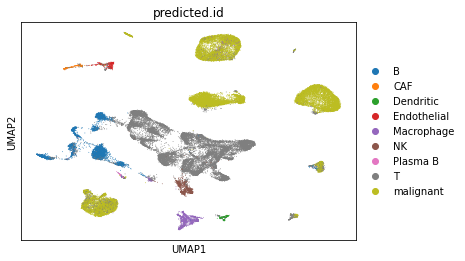

In [6]:
sc.pl.umap(scatac, color=['predicted.id'])

In [7]:
mit_data = sc.read_h5ad("/home/estelle860530/Getz_lab/data/scRNA_mit.h5ad")

In [8]:
sample2response={'620':'PD', '776_on':'PD','856_A':'PD','856_B':'PD',
                 '1224_post-FT':'PD', '1224_post-Cln':'PD',
                 '509_2':'R',
                 '509_post':'R',
                 '1227_pre':'R',
                 '1009_on':'R',
                 '1130':'R'}

mit_data.obs['response']=mit_data.obs['orig.ident'].map(sample2response)

... storing 'orig.ident' as categorical
... storing 'response' as categorical


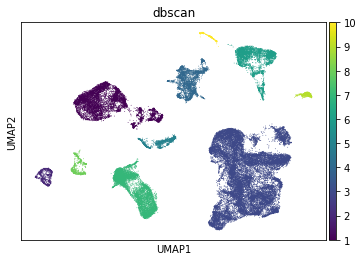

In [9]:
##Missing NK cells
sc.pl.umap(mit_data, color=['dbscan'], legend_loc="on data")

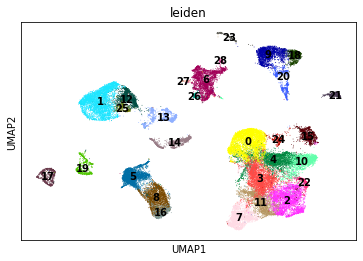

In [10]:
sc.pp.neighbors(mit_data, n_neighbors=20, n_pcs=40)
sc.tl.leiden(mit_data,resolution=1)
sc.pl.umap(mit_data, color=['leiden'], legend_loc="on data")

In [11]:
mit_data.obs.loc[mit_data.obs['leiden'] == '7' , 'dbscan'] = 11

In [13]:
num2name={1:'Malignant',2:'Endothelial',3:'T cell', 4:'Macrophage',5:'Malignant',
          6:'B cell', 7: 'Malignant', 8:'CAF',9:'Dendritic',10:'Plasma B', 11:'NK'}

mit_data.obs['annotated_celltype']=mit_data.obs['dbscan'].map(num2name)

In [14]:
name2num={'Malignant':1, 'Endothelial':2, 'T cell':3, 
          'Macrophage':4, 'B cell':5,'CAF':6, 
          'Dendritic':7 ,'Plasma B':8, 'NK':9}

mit_data.obs['new_dbscan']=mit_data.obs['annotated_celltype'].map(name2num)

In [16]:
Counter(mit_data.obs['new_dbscan']), Counter(mit_data.obs['annotated_celltype'])

(Counter({1: 14152,
          2: 826,
          3: 20395,
          4: 3187,
          5: 3570,
          6: 810,
          7: 597,
          8: 332,
          9: 2220}),
 Counter({'Malignant': 14152,
          'Endothelial': 826,
          'T cell': 20395,
          'Macrophage': 3187,
          'B cell': 3570,
          'CAF': 810,
          'Dendritic': 597,
          'Plasma B': 332,
          'NK': 2220}))

In [17]:
xy, x_ind, y_ind = np.intersect1d(scatac.var_names,  mit_data.var_names, return_indices=True)

In [18]:
rna_y = mit_data.obs[['new_dbscan','response','annotated_celltype']]
rna_y.columns=['dbscan','response','annotated_celltype']
rna_y = rna_y.copy()
rna_y['omic'] = 'RNA'

atac_y = scatac.obs[['dbscan','response','annotated_celltype']]
atac_y = atac_y.copy()
atac_y['omic'] = 'ATAC'

common_y = rna_y.append(atac_y)

common_y = common_y.copy()
common_y['annotation'] = common_y['annotated_celltype']+"_"+common_y['omic']

In [19]:
raw_rna = mit_data.X[:,y_ind]
raw_atac = scatac.X[:,x_ind]

In [20]:
common_matrix = np.concatenate((raw_rna, raw_atac), axis=0)

In [21]:
annotated = ExperimentDataset(raw_rna, 
                              mit_data.obs.index, 
                              xy, 
                              'Annotated', rna_y['dbscan'])

unannotated = ExperimentDataset(raw_atac, 
                                scatac.obs.index, 
                                xy, 
                                'Unannotated', atac_y['dbscan'])

pretrain = ExperimentDataset(raw_atac, 
                             scatac.obs.index, 
                             xy,
                             'Unannotated')

n_clusters= len(np.unique(unannotated.y))

params, unknown= get_parser().parse_known_args()
if torch.cuda.is_available() and not params.cuda:
        print("WARNING: You have a CUDA device, so you should probably run with --cuda")
device = 'cuda:0' if torch.cuda.is_available() and params.cuda else 'cpu'

params.device = device
params.epochs_pretrain = 30
params.pretrain_batch = 128
params.epochs = 30

== Dataset: Found 46089 items 
== Dataset: Found 9 classes
== Dataset: Found 43956 items 
== Dataset: Found 9 classes


In [25]:
ae_merge_mars = AE_MARS(n_clusters, params, [annotated] , unannotated, pretrain, 
                ##These are roll over parametesr form original model 
                hid_dim_1=1000, hid_dim_2=100, p_drop=0.0, tau=0.2)

ae_merge_adata, ae_merge_landmarks, ae_merge_scores , ae_merge_training_history, ae_merge_latent_tracker = ae_merge_mars.train(evaluation_mode=True,
                                                                                                                               save_all_embeddings=True)

Pretraining..
Pretraining Epoch 0, Loss: 245.7764129638672
Time:  6.116303205490112
Pretraining Epoch 1, Loss: 206.6793975830078
Time:  4.721380233764648
Pretraining Epoch 2, Loss: 192.0977783203125
Time:  4.902520418167114
Pretraining Epoch 3, Loss: 179.9062957763672
Time:  4.983854532241821
Pretraining Epoch 4, Loss: 172.1393585205078
Time:  5.3818981647491455
Pretraining Epoch 5, Loss: 166.8778533935547
Time:  5.127008438110352
Pretraining Epoch 6, Loss: 163.2394561767578
Time:  5.128190279006958
Pretraining Epoch 7, Loss: 160.38046264648438
Time:  5.178874492645264
Pretraining Epoch 8, Loss: 158.05154418945312
Time:  5.447915554046631
Pretraining Epoch 9, Loss: 155.98780822753906
Time:  4.837060928344727
Pretraining Epoch 10, Loss: 154.25408935546875
Time:  5.002079725265503
Pretraining Epoch 11, Loss: 152.7371826171875
Time:  4.831948280334473
Pretraining Epoch 12, Loss: 151.1507110595703
Time:  4.54541802406311
Pretraining Epoch 13, Loss: 149.84246826171875
Time:  4.6794116497039

/home/estelle860530/anaconda3/lib/python3.8/site-packages/sklearn/utils/validation.py:67: FutureWarning: Pass labels=[0, 1, 2, 3, 4, 5, 6, 7, 8] as keyword args. From version 0.25 passing these as positional arguments will result in an error
  warnings.warn("Pass {} as keyword args. From version 0.25 "
/home/estelle860530/anaconda3/lib/python3.8/site-packages/sklearn/utils/validation.py:67: FutureWarning: Pass labels=[0, 1, 2, 3, 4, 5, 6, 7, 8] as keyword args. From version 0.25 passing these as positional arguments will result in an error
  warnings.warn("Pass {} as keyword args. From version 0.25 "


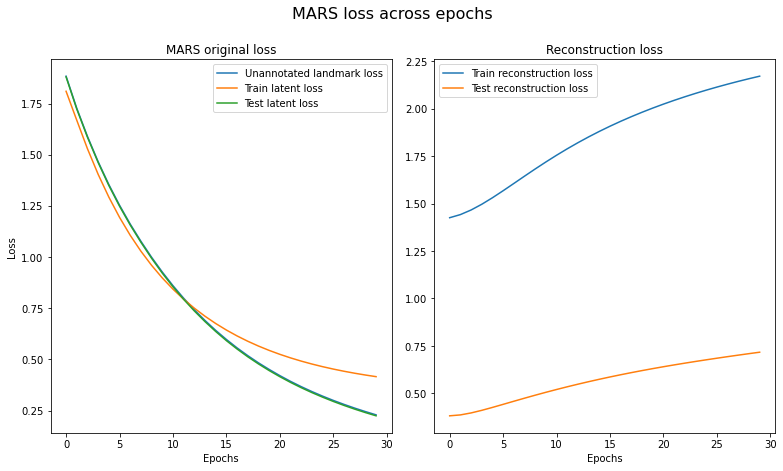

In [26]:
###Unannoatted landmark loss is the same as test latent loss(distance between embedding and landmarks)
MARS_loss_tracker (ae_merge_training_history, save=True)

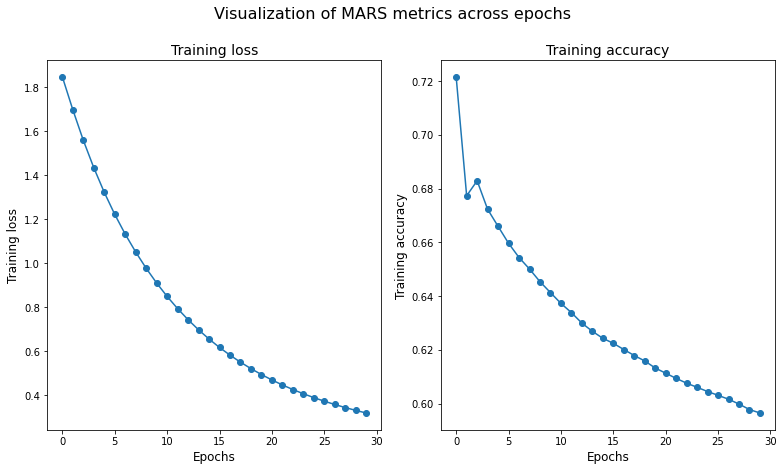

In [27]:
MARS_history(ae_merge_training_history, save=True)

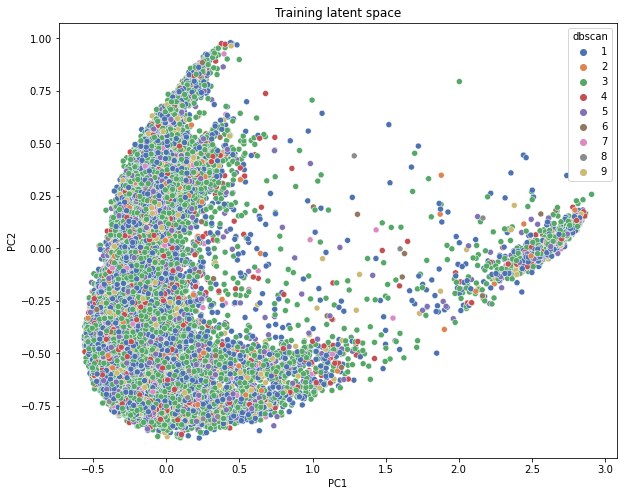

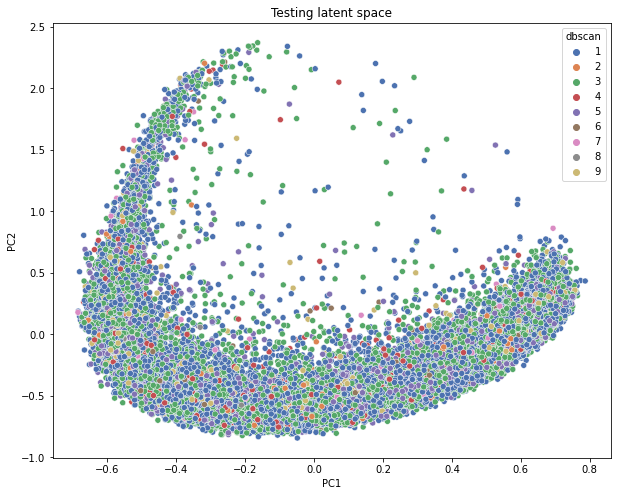

In [100]:
MARS_latent_pca(ae_merge_latent_tracker , 29)

... storing 'MARS_labels' as categorical


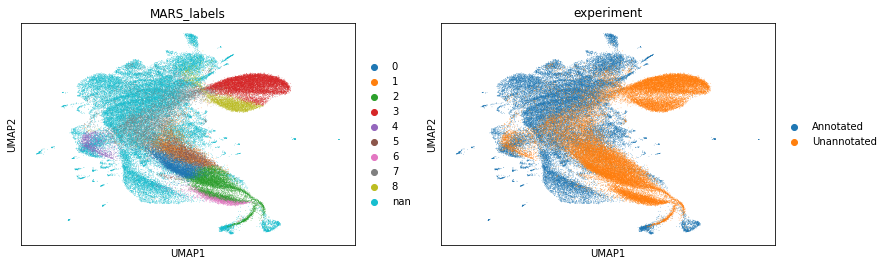

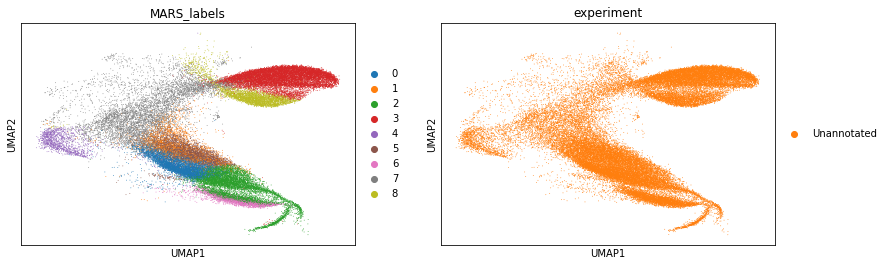

In [31]:
MARS_latent_umap(ae_merge_adata, plot_gene_list = ['MARS_labels','experiment'], save =True)

In [44]:
def cell_type_assign(adata, save):

    num2name={1:'Malignant',2:'Endothelial',3:'T cell', 4:'Macrophage',
              5:'B cell',6:'CAF',7:'Dendritic',8:'Plasma B', 9:'NK'}

    adata.obs['label_name']=adata.obs['truth_labels'].map(num2name)  
    untable = adata.obs.loc[adata.obs['experiment']=='Unannotated',:]
    
    groundtruth_sum = pd.crosstab(untable['truth_labels'], untable['MARS_labels']).sum(axis=1)
    plot = pd.crosstab(untable['truth_labels'], untable['MARS_labels']).div(groundtruth_sum/100, axis=0).plot.bar(figsize=(17,5), width=1)
    plot.set_xticklabels(['Malignant','Endothelial', 'T cell', 'Macrophage', 'B cell',  'CAF', 'Dendritic', 'Plasma B', 'NK' ])
    plot.legend(title="MARS labels")
    plot.set_xlabel("Ground truth labels", fontsize=18)
    plot.set_title("Distribution of MARS labels and Ground Truths", fontsize=24)
    plot.set_ylabel("% Truth labels in MARS labels", fontsize=18)
    plt.show()
    
    
    if save==True:
        plot.get_figure().savefig("cell_type_groundtruth.png")
    
    groundtruth_sum = pd.crosstab(untable['MARS_labels'], untable['label_name']).sum(axis=1)
    plot = pd.crosstab(untable['MARS_labels'], untable['label_name']).div(groundtruth_sum/100, axis=0).plot.bar(figsize=(17,5), width=1)
    plot.legend(title="Ground truth")
    plot.set_xlabel("MARS labels", fontsize=18)
    plot.set_ylabel("% MARS labels in Truth labels", fontsize=18)
    plt.show()
    
    if save==True:
        plot.get_figure().savefig("cell_type_MARS.png")

        
def MARS_silhouette(adata, save):
    
    
    anno_data = adata[adata.obs['experiment'] == "Annotated", :]
    unanno_data = adata[adata.obs['experiment'] == "Unannotated", :]
    
    anno_obs = anno_data.obs
    unanno_obs = unanno_data.obs
    
    ###Silhouette
    train_latent = anno_data.obsm['MARS_embedding']
    train_sil=silhouette_samples(train_latent, anno_obs['truth_labels'].values)
    
    val_latent = unanno_data.obsm['MARS_embedding']
    val_sil=silhouette_samples(val_latent, unanno_obs['truth_labels'].values)
    
    n_clusters=len(Counter(adata.obs['truth_labels'].values).keys())
    
    ###Plot silhouette score for train and test 
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 10)
        
    ax1.set_xlim([-0.1, 1])
    ax1.set_ylim([0, len(train_latent) + (n_clusters + 1) * 10])
    
    ax2.set_xlim([-0.1, 1])
    ax2.set_ylim([0, len(val_latent) + (n_clusters + 1) * 10])
         
    y_lower = 10
    val_y_lower = 10
    
    
    name2num={'Malignant':1, 'Endothelial':2, 'T cell':3, 
          'Macrophage':4, 'B cell':5,'CAF':6, 
          'Dendritic':7 ,'Plasma B':8, 'NK':9}

    cluster_list = list(name2num.keys())
    
    for i in range(n_clusters):
        
        
        #cluster_label = list(Counter(adata.obs['truth_labels']).keys())[i]
        cluster_label = cluster_list[i]
        
        #############################################################
        ###############Training 
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        train_ith_cluster_silhouette_values = train_sil[anno_obs['label_name'] == cluster_label]
        train_ith_cluster_silhouette_values.sort()
        
        size_cluster_i = train_ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        #color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, train_ith_cluster_silhouette_values) 
        #edgecolor=color, facecolor=color

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(0.8, y_lower + 0.5 * size_cluster_i, str(cluster_label))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples
        
        #############################################################
        ###############Validation 
        val_ith_cluster_silhouette_values = val_sil[unanno_obs['label_name'] == cluster_label]
        val_ith_cluster_silhouette_values.sort()
        
        val_size_cluster_i = val_ith_cluster_silhouette_values.shape[0]
        val_y_upper = val_y_lower + val_size_cluster_i

        #color = cm.nipy_spectral(float(i) / n_clusters)
        ax2.fill_betweenx(np.arange(val_y_lower, val_y_upper),
                          0, val_ith_cluster_silhouette_values)
        # edgecolor=color, facecolor=color

        # Label the silhouette plots with their cluster numbers at the middle
        ax2.text(0.8, val_y_lower + 0.5 * val_size_cluster_i, str(cluster_label))

        # Compute the new y_lower for next plot
        val_y_lower = val_y_upper + 10  # 10 for the 0 samples
     
    ax1.set_title("Training silhouette plot for known labels")
    ax1.set_xlabel("Silhouette coefficient values")
    ax1.set_ylabel("Cluster label")
    
    ax2.set_title("Validation silhouette plot for known labels")
    ax2.set_xlabel("Silhouette coefficient values")
    ax2.set_ylabel("Cluster label")
    
    # The vertical line for average silhouette score of all the values
    train_avg=silhouette_score(train_latent, anno_obs['truth_labels'].values)
    val_avg=silhouette_score(val_latent, unanno_obs['truth_labels'].values)
    
    ax1.axvline(x=train_avg, color="red", linestyle="--")
    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])
    
    ax2.axvline(x=val_avg, color="red", linestyle="--")
    ax2.set_yticks([])  # Clear the yaxis labels / ticks
    ax2.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])
    
    plt.suptitle("Silhouette scores for MARS latent space", fontsize=14, fontweight='bold')
    plt.show()  
    
    if save ==True:
        fig.savefig("MARS_silhouette.png")

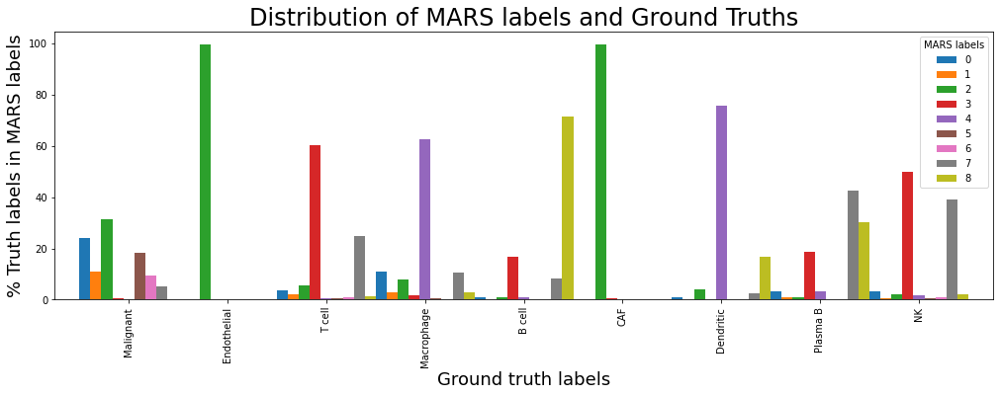

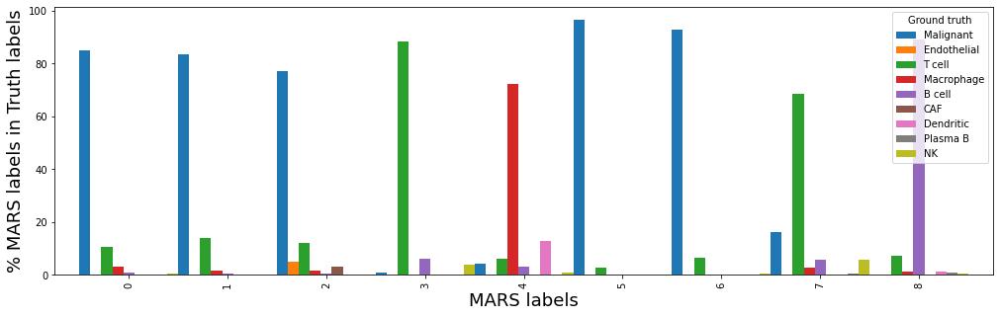

In [45]:
cell_type_assign(ae_merge_adata, save=True)

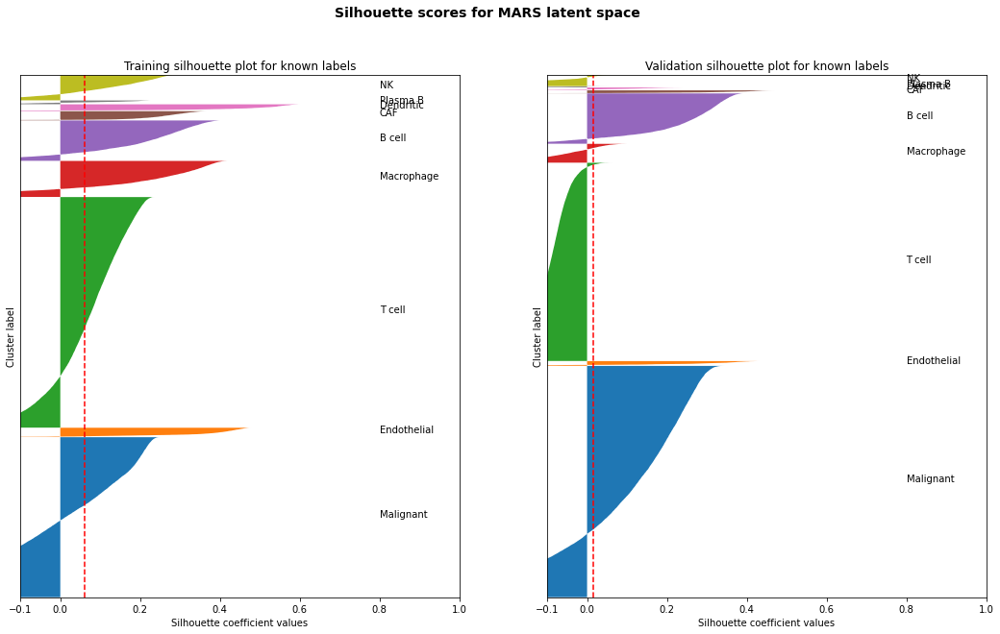

In [46]:
MARS_silhouette(ae_merge_adata, save = True)

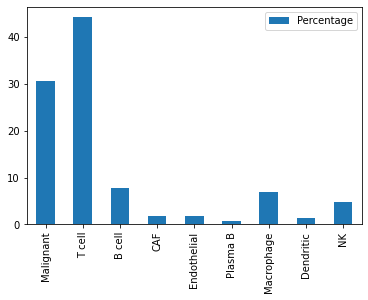

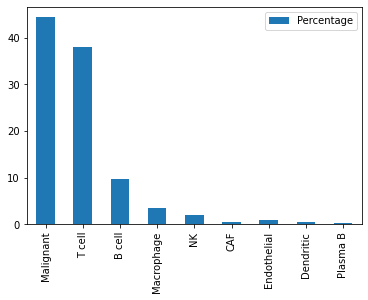

In [241]:
pd.DataFrame.from_dict(Counter(anno_obs.label_name),orient="index", columns=["Percentage"]).div(anno_obs.shape[0]/100).plot.bar()
pd.DataFrame.from_dict(Counter(unanno_obs.label_name),orient="index", columns=["Percentage"]).div(unanno_obs.shape[0]/100).plot.bar()
plt.show()

In [242]:
def MARS_silhouette(adata):
    
    
    anno_data = adata[adata.obs['experiment'] == "Annotated", :]
    unanno_data = adata[adata.obs['experiment'] == "Unannotated", :]
    
    anno_obs = anno_data.obs
    unanno_obs = unanno_data.obs
    
    ###Silhouette
    train_latent = anno_data.obsm['MARS_embedding']
    train_sil=silhouette_samples(train_latent, anno_obs['truth_labels'].values)
    
    val_latent = unanno_data.obsm['MARS_embedding']
    val_sil=silhouette_samples(val_latent, unanno_obs['truth_labels'].values)
    
    n_clusters=len(Counter(adata.obs['truth_labels'].values).keys())
    
    ###Plot silhouette score for train and test 
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 10)
        
    ax1.set_xlim([-0.1, 1])
    ax1.set_ylim([0, len(train_latent) + (n_clusters + 1) * 10])
    
    ax2.set_xlim([-0.1, 1])
    ax2.set_ylim([0, len(val_latent) + (n_clusters + 1) * 10])
         
    y_lower = 10
    val_y_lower = 10
    
    
    name2num={'Malignant':1, 'Endothelial':2, 'T cell':3, 
          'Macrophage':4, 'B cell':5,'CAF':6, 
          'Dendritic':7 ,'Plasma B':8, 'NK':9}

    cluster_list = list(name2num.keys())
    
    for i in range(n_clusters):
        
        
        #cluster_label = list(Counter(adata.obs['truth_labels']).keys())[i]
        cluster_label = cluster_list[i]
        
        #############################################################
        ###############Training 
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        train_ith_cluster_silhouette_values = train_sil[anno_obs['label_name'] == cluster_label]
        train_ith_cluster_silhouette_values.sort()
        
        size_cluster_i = train_ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        #color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, train_ith_cluster_silhouette_values) 
        #edgecolor=color, facecolor=color

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(cluster_label))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples
        
        #############################################################
        ###############Validation 
        val_ith_cluster_silhouette_values = val_sil[unanno_obs['label_name'] == cluster_label]
        val_ith_cluster_silhouette_values.sort()
        
        val_size_cluster_i = val_ith_cluster_silhouette_values.shape[0]
        val_y_upper = val_y_lower + val_size_cluster_i

        #color = cm.nipy_spectral(float(i) / n_clusters)
        ax2.fill_betweenx(np.arange(val_y_lower, val_y_upper),
                          0, val_ith_cluster_silhouette_values)
        # edgecolor=color, facecolor=color

        # Label the silhouette plots with their cluster numbers at the middle
        ax2.text(-0.05, val_y_lower + 0.5 * val_size_cluster_i, str(cluster_label))

        # Compute the new y_lower for next plot
        val_y_lower = val_y_upper + 10  # 10 for the 0 samples
     
    ax1.set_title("Training silhouette plot for known labels")
    ax1.set_xlabel("Silhouette coefficient values")
    ax1.set_ylabel("Cluster label")
    
    ax2.set_title("Validation silhouette plot for known labels")
    ax2.set_xlabel("Silhouette coefficient values")
    ax2.set_ylabel("Cluster label")
    
    # The vertical line for average silhouette score of all the values
    train_avg=silhouette_score(train_latent, anno_obs['truth_labels'].values)
    val_avg=silhouette_score(val_latent, unanno_obs['truth_labels'].values)
    
    ax1.axvline(x=train_avg, color="red", linestyle="--")
    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])
    
    ax2.axvline(x=val_avg, color="red", linestyle="--")
    ax2.set_yticks([])  # Clear the yaxis labels / ticks
    ax2.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])
    
    plt.suptitle("Silhouette scores for MARS latent space", fontsize=14, fontweight='bold')
    plt.show()           

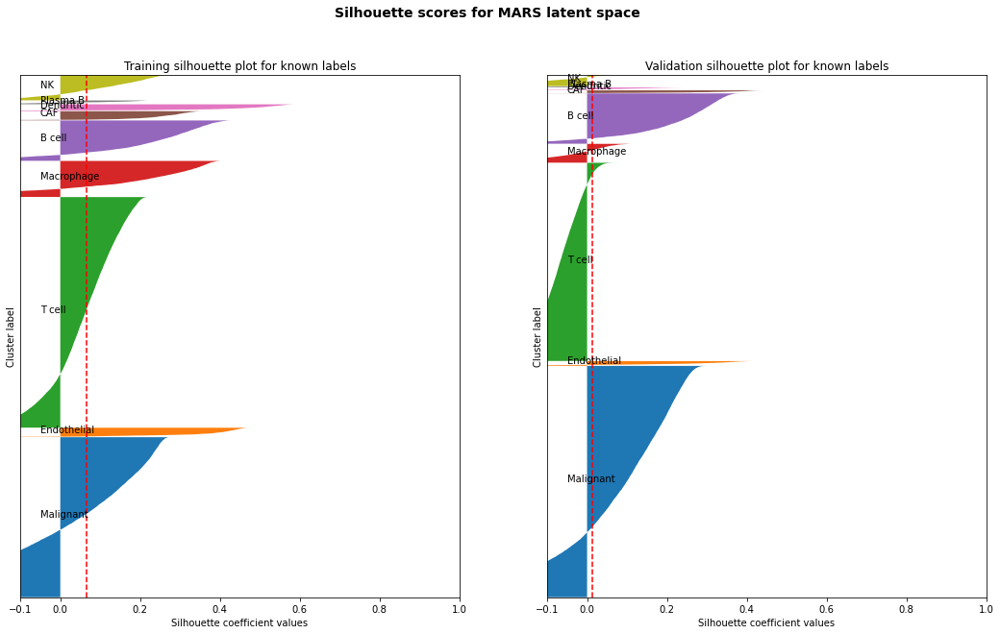

In [243]:
MARS_silhouette(ae_merge_adata)

In [ ]:
pretrain = ExperimentDataset(common_matrix, 
                             [mit_data.obs.index, scatac.obs.index], 
                             xy,
                             'Unannotated')

n_clusters= len(np.unique(unannotated.y))

params, unknown= get_parser().parse_known_args()
if torch.cuda.is_available() and not params.cuda:
        print("WARNING: You have a CUDA device, so you should probably run with --cuda")
device = 'cuda:0' if torch.cuda.is_available() and params.cuda else 'cpu'

params.device = device
params.epochs_pretrain = 30
params.pretrain_batch = 128
params.epochs = 30

In [ ]:
ae_merge_mars = AE_MARS(n_clusters, params, [annotated] , unannotated, pretrain, 
                ##These are roll over parametesr form original model 
                hid_dim_1=1000, hid_dim_2=100, p_drop=0.0, tau=0.2)

ae_merge_adata, ae_merge_landmarks, ae_merge_scores , ae_merge_training_history, ae_merge_latent_tracker = ae_merge_mars.train(evaluation_mode=True,
                                                                                                                               save_all_embeddings=True)

### MARS on scRNA data alone

In [6]:
validation_percent = 0.3
x_train, test_x, y_train, test_y  = train_test_split(mit_data.X, 
                                                     mit_data.obs,
                                                     test_size=validation_percent,
                                                     stratify = mit_data.obs['dbscan'])

annotated = ExperimentDataset(x_train, 
                              y_train.index, 
                              mit_data.var_names, 
                              'Annotated', y_train['dbscan'])
unannotated = ExperimentDataset(test_x, 
                                test_y.index, 
                                mit_data.var_names, 
                                'Unannotated', test_y['dbscan'])

pretrain = ExperimentDataset(test_x, 
                             test_y.index,
                             mit_data.var_names,
                             'Unannotated')

n_clusters= len(np.unique(unannotated.y))

params, unknown= get_parser().parse_known_args()
if torch.cuda.is_available() and not params.cuda:
        print("WARNING: You have a CUDA device, so you should probably run with --cuda")
device = 'cuda:0' if torch.cuda.is_available() and params.cuda else 'cpu'

params.device = device
params.epochs_pretrain = 30
params.pretrain_batch = 128
params.epochs = 30

== Dataset: Found 32262 items 
== Dataset: Found 10 classes
== Dataset: Found 13827 items 
== Dataset: Found 10 classes


In [6]:
ae_mars = AE_MARS(n_clusters, params, [annotated] , unannotated, pretrain, 
                ##These are roll over parametesr form original model 
                hid_dim_1=1000, hid_dim_2=100, p_drop=0.0, tau=0.2)
ae_adata, ae_landmarks, ae_scores , ae_training_history, ae_latent_tracker = ae_mars.train(evaluation_mode=True,
                                                                                           save_all_embeddings=True)

Pretraining..
Pretraining Epoch 0, Loss: 240.9716796875
Time:  2.9764111042022705
Pretraining Epoch 1, Loss: 203.87991333007812
Time:  2.737849473953247
Pretraining Epoch 2, Loss: 193.73800659179688
Time:  2.6661813259124756
Pretraining Epoch 3, Loss: 189.483154296875
Time:  2.560917615890503
Pretraining Epoch 4, Loss: 183.8294219970703
Time:  2.590622663497925
Pretraining Epoch 5, Loss: 177.07855224609375
Time:  2.553696632385254
Pretraining Epoch 6, Loss: 171.3245391845703
Time:  2.560091257095337
Pretraining Epoch 7, Loss: 169.27154541015625
Time:  2.5698139667510986
Pretraining Epoch 8, Loss: 163.48001098632812
Time:  2.605104446411133
Pretraining Epoch 9, Loss: 159.12689208984375
Time:  2.6596949100494385
Pretraining Epoch 10, Loss: 158.501708984375
Time:  2.6377787590026855
Pretraining Epoch 11, Loss: 153.75123596191406
Time:  2.607372283935547
Pretraining Epoch 12, Loss: 149.45639038085938
Time:  2.620786190032959
Pretraining Epoch 13, Loss: 147.4131622314453
Time:  2.6456820964

/home/estelle860530/anaconda3/lib/python3.8/site-packages/sklearn/utils/validation.py:67: FutureWarning: Pass labels=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9] as keyword args. From version 0.25 passing these as positional arguments will result in an error
  warnings.warn("Pass {} as keyword args. From version 0.25 "
/home/estelle860530/anaconda3/lib/python3.8/site-packages/sklearn/utils/validation.py:67: FutureWarning: Pass labels=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9] as keyword args. From version 0.25 passing these as positional arguments will result in an error
  warnings.warn("Pass {} as keyword args. From version 0.25 "
/home/estelle860530/anaconda3/lib/python3.8/site-packages/sklearn/utils/validation.py:67: FutureWarning: Pass labels=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9] as keyword args. From version 0.25 passing these as positional arguments will result in an error
  warnings.warn("Pass {} as keyword args. From version 0.25 "


In [319]:
class VAE(nn.Module):
    '''
    '''
    def __init__(self, latent_dim , n_feature , network_architecture , 
                 lambda_reconstruct, lambda_kl ,
                 p_drop=0.2):
        
        super(VAE, self).__init__()
        
        self.lambda_reconstruct = lambda_reconstruct
        self.lambda_kl = lambda_kl
        
        self.hidden_encode1=network_architecture['n_hidden_recog_1']
        self.hidden_encode2=network_architecture['n_hidden_recog_2']
        self.hidden_encode3=network_architecture['n_hidden_recog_3']
        
        self.hidden_decode1=network_architecture['n_hidden_gener_1']
        self.hidden_decode2=network_architecture['n_hidden_gener_2']
        self.hidden_decode3=network_architecture['n_hidden_gener_3']
        
        self.latent_dim = latent_dim
        self.n_feature = n_feature
        
        self.encoder = nn.Sequential(
            
            nn.Linear(self.n_feature, self.hidden_encode1, bias=True),
            nn.ELU(alpha=0.2),
            nn.Dropout(p=p_drop),
            nn.Linear(self.hidden_encode1, self.hidden_encode2, bias=True),
            nn.ELU(alpha=0.2),
            nn.Linear(self.hidden_encode2, self.hidden_encode3, bias=True),
            nn.ELU(alpha=0.2)
        )
        
        self.mu = nn.Linear(self.hidden_encode3, self.latent_dim, bias=True)
        self.logvar = nn.Linear(self.hidden_encode3, self.latent_dim, bias=True)
        
        self.decoder = nn.Sequential(
            
            nn.Linear(self.latent_dim, self.hidden_decode1, bias=True),
            nn.ELU(alpha=0.2),
            nn.Dropout(p=p_drop),
            nn.Linear(self.hidden_decode1, self.hidden_decode2, bias=True),
            nn.ELU(alpha=0.2),
            nn.Linear(self.hidden_decode2, self.hidden_decode3, bias=True),
            nn.ELU(alpha=0.2),
            nn.Linear(self.hidden_decode3, self.n_feature, bias=True)
        )
    
    
    def encode(self, x):
        '''
        Return latent parameters
        '''
        encoded = self.encoder(x)
        
        mu = self.mu(encoded)
        logvar = self.logvar(encoded)
        
        return [mu, logvar]
        
    
    def decode(self, z):
        '''
        Reconstruct
        '''
        decoded = self.decoder(z)
        return decoded
    
    
    def reparameterize(self, mu , logvar):
        ''' 
        Reparametraization sample N(mu, var) from N(0,1) noise
        '''
        std = torch.exp(0.5 * logvar)
        eps = torch.randn_like(std) #std represents the size of the tensor
        
        return eps*std + mu                
      
    def forward(self, x):
        
        mu, logvar = self.encode(x)
        
        z = self.reparameterize(mu, logvar)
        
        decoded = self.decode(z)
        
        return decoded, mu, logvar
    
import torch
from torch.nn import functional as F

#from model.utils import euclidean_dist

##training set encoded distance to landmarks 
def loss_task(encoded, prototypes, target, criterion='dist'):
    """Calculate loss.
    criterion: NNLoss - assign to closest prototype and calculate NNLoss
    dist - loss is distance to prototype that example needs to be assigned to
                and -distance to prototypes from other class
    """
    
    uniq = torch.unique(target, sorted=True)
    
    ###index of samples for each class of labels
    class_idxs = list(map(lambda c: target.eq(c).nonzero(), uniq))
    
    # prepare targets so they start from 0,1
    for idx,v in enumerate(uniq):
        target[target==v]=idx
    
    dists = euclidean_dist(encoded, prototypes)
    
    if criterion=='NNLoss':
       
        loss = torch.nn.NLLLoss()
        log_p_y = F.log_softmax(-dists, dim=1)
        
        loss_val = loss(log_p_y, target)
        _, y_hat = log_p_y.max(1)
        
    
    elif criterion=='dist':
        
        loss_val = torch.stack([dists[idx_example, idx_proto].mean(0) for idx_proto,idx_example in enumerate(class_idxs)]).mean()
        #loss_val1 = loss_val1/len(embeddings) 
        y_hat = torch.max(-dists,1)[1]
        
    acc_val = y_hat.eq(target.squeeze()).float().mean()    
        
    return loss_val, acc_val

def loss_test_nn(encoded, prototypes):
    dists = euclidean_dist(encoded, prototypes)
    min_dist = torch.min(dists, 1)
    
    y_hat = min_dist[1]
    args_uniq = torch.unique(y_hat, sorted=True)
    args_count = torch.stack([(y_hat==x_u).sum() for x_u in args_uniq])
    print(args_count)
    
    loss = torch.nn.NLLLoss()
    log_p_y = F.log_softmax(-dists, dim=1)
    print(log_p_y.shape)
        
    loss_val = loss(log_p_y, y_hat)
    _, y_hat = log_p_y.max(1)
    
    return loss_val, args_count

###Intra cluster distance
def loss_test_basic(encoded, prototypes):
    
    dists = euclidean_dist(encoded, prototypes)
    min_dist = torch.min(dists, 1)
    
    y_hat = min_dist[1]
    args_uniq = torch.unique(y_hat, sorted=True)
    args_count = torch.stack([(y_hat==x_u).sum() for x_u in args_uniq])
    #print(args_count)
    
    min_dist = min_dist[0] # get_distances
    
    #thr = torch.stack([torch.sort(min_dist[y_hat==idx_class])[0][int(len(min_dist[y_hat==idx_class])*0.9)] for idx_class in args_uniq])
    #loss_val = torch.stack([min_dist[y_hat==idx_class][min_dist[y_hat==idx_class]>=thr[idx_class]].mean(0) for idx_class in args_uniq]).mean()
    
    loss_val = torch.stack([min_dist[y_hat==idx_class].mean(0) for idx_class in args_uniq]).mean()
    
    #loss_val,_ = loss_task(encoded, prototypes, y_hat, criterion='dist') # same
    
    return loss_val, args_count

##For unannotated set 
def loss_test(encoded, prototypes, tau):
    
    #prototypes = torch.stack(prototypes).squeeze() 
    loss_val_test, args_count = loss_test_basic(encoded, prototypes)
    
    ###inter cluster distance 
    if tau>0:
        dists = euclidean_dist(prototypes, prototypes)
        nproto = prototypes.shape[0]
        loss_val2 = - torch.sum(dists)/(nproto*nproto-nproto)
        loss_val_test += tau*loss_val2
        
    return loss_val_test, args_count

def reconstruction_loss(decoded, x):
    
    loss_func = torch.nn.MSELoss()
    loss_rcn = loss_func(decoded, x)
    #print('Reconstruction {}'.format(loss_rcn))
    
    return loss_rcn


def vae_loss(model, decoded, x, mu, logvar):
    
#     loss_func = torch.nn.MSELoss()
#     loss_rcn = loss_func(decoded, x)
    #KL =  torch.mean(-0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp()))
    
    loss_rcn = torch.mean(torch.sum((x - decoded).pow(2),1))
    
    KL_loss = (-0.5)*(1 + logvar - mu.pow(2) - logvar.exp())
    KL = torch.mean(torch.sum(KL_loss, axis=1))
    
    #print(model.lambda_reconstruct, model.lambda_kl)
    total_loss = model.lambda_reconstruct*loss_rcn + model.lambda_kl * KL 
    
    
    #print(f"Reconstruction Loss: {loss_rcn} KL Loss: {KL}")
    
    return total_loss 


import numpy as np
import torch
#from sklearn.cluster import k_means_
from sklearn.cluster import KMeans

## Training set (annotated landmarks)
def compute_landmarks_tr(embeddings, target, prev_landmarks=None, tau=0.2):
    
    """Computing landmarks of each class in the labeled meta-dataset. 
    
    Landmark is a closed form solution of 
    minimizing distance to the mean and maximizing distance to other landmarks. 
    
    If tau=0, landmarks are just mean of data points.
    
    embeddings: embeddings of the labeled dataset
    target: labels in the labeled dataset
    prev_landmarks: landmarks from previous iteration
    tau: regularizer for inter- and intra-cluster distance
    """
    
    uniq = torch.unique(target, sorted=True)
    class_idxs = list(map(lambda c: target.eq(c).nonzero(), uniq))
    
    landmarks_mean = torch.stack([embeddings[idx_class].mean(0) for idx_class in class_idxs]).squeeze()
    
    if prev_landmarks is None or tau==0:
        return landmarks_mean
    
    suma = prev_landmarks.sum(0)
    nlndmk = prev_landmarks.shape[0]
    lndmk_dist_part = (tau/(nlndmk-1))*torch.stack([suma-p for p in prev_landmarks])
    landmarks = 1/(1-tau)*(landmarks_mean-lndmk_dist_part)
    
    return landmarks



def init_landmarks(n_clusters, tr_load, test_load, model, device, mode='kmeans', pretrain=True):
    """Initialization of landmarks of the labeled and unlabeled meta-dataset.
    nclusters: number of expected clusters in the unlabeled meta-dataset
    tr_load: data loader for labeled meta-dataset
    test_load: data loader for unlabeled meta-dataset
    """
    lndmk_tr = [torch.zeros(size=(len(np.unique(dl.dataset.y)), 
                                  model.latent_dim), 
                            requires_grad=True, device=device) for dl in tr_load]
    
    lndmk_test = [torch.zeros(size=(1, model.latent_dim), 
                              requires_grad=True, device=device) 
                       for _ in range(n_clusters)]
    
    kmeans_init_tr = [init_step(dl.dataset, model, device, pretrained=pretrain, mode=mode) 
                      for dl in tr_load]
    
    kmeans_init_test = init_step(test_load.dataset, model, device, 
                                 pretrained=pretrain, mode=mode, 
                                 n_clusters=n_clusters)
    
    ##No gradient calculation
    with torch.no_grad():
        [lndmk.copy_(kmeans_init_tr[idx])  for idx,lndmk in enumerate(lndmk_tr)]
        [lndmk_test[i].copy_(kmeans_init_test[i,:]) for i in range(kmeans_init_test.shape[0])]
        
    return lndmk_tr, lndmk_test


def init_step(dataset, model, device, pretrained, mode='kmeans',n_clusters=None):
    """Initialization of landmarks with k-means or k-means++ given dataset."""
    
    if n_clusters==None:
        n_clusters = len(np.unique(dataset.y))
    
    nexamples = len(dataset.x)
        
    X =  torch.stack([dataset.x[i] for i in range(nexamples)])
    
    if mode=='kmeans++':
        if not pretrained: # find centroids in original space
            landmarks = k_means_._init_centroids(X.cpu().numpy(), n_clusters, 'k-means++')
            landmarks = torch.tensor(landmarks, device=device)
            landmarks = landmarks.to(device)
            lndmk_encoded,_ = model(landmarks)
            
        else:
            X = X.to(device)
            encoded,_ = model(X)
            landmarks = k_means_._init_centroids(encoded.data.cpu().numpy(), n_clusters, 'k-means++')
            lndmk_encoded = torch.tensor(landmarks, device=device)
    
    elif mode=='kmeans': # run kmeans clustering
        if not pretrained: 
            kmeans = KMeans(n_clusters, random_state=0).fit(X.cpu().numpy())
            landmarks = torch.tensor(kmeans.cluster_centers_, device=device)
            landmarks = landmarks.to(device)
            ##Feed forward net on landmarks  (k means cluster)
            ##landmarks are k means cluster centers = coordinates of cluster center
            #lndmk_encoded,_ = model(landmarks)
            _ , lndmk_encoded, _ = model(landmarks)
        
        ##cluster on lower embedding space
        else:
            X = X.to(device)
            #encoded,_ = model(X)
            decode , encoded, logvar = model(X)
            kmeans = KMeans(n_clusters, random_state=0).fit(encoded.data.cpu().numpy())
            lndmk_encoded = torch.tensor(kmeans.cluster_centers_, device=device)
    
    return lndmk_encoded


class VAE_MARS:
    def __init__(self, n_clusters, params, 
                 labeled_data, unlabeled_data, 
                 pretrain_data=None, 
                 
                 val_split=1.0, hid_dim_1=1000, hid_dim_2=100, p_drop=0.0, tau=0.2,
                 
                 latent_dim = 50, 
                 n_feature = 10, 
                 
                 network_architecture={"n_hidden_recog_1": 250, "n_hidden_recog_2": 100,
                                       "n_hidden_recog_3": 100, "n_hidden_gener_1": 100,
                                       "n_hidden_gener_2": 100, "n_hidden_gener_3": 100},
                 
                 lambda_reconstruct = 1e-4, lambda_kl = 1e-3
                ):
        
        """Initialization of MARS.
        n_clusters: number of clusters in the unlabeled meta-dataset
        params: parameters of the MARS model
        labeled_data: list of labeled datasets. Each dataset needs to be instance of CellDataset.
        unlabeled_data: unlabeled dataset. Instance of CellDataset.
        pretrain_data: dataset for pretraining MARS. Instance of CellDataset. If not specified, unlabeled_data
                        will be used.
        val_split: percentage of data to use for train/val split (default: 1, meaning no validation set)
        hid_dim_1: dimension in the first layer of the network (default: 1000)
        hid_dim_2: dimension in the second layer of the network (default: 100)
        p_drop: dropout probability (default: 0)
        tau: regularizer for inter-cluster distance
        """
        train_load, test_load, pretrain_load, val_load = init_data_loaders(labeled_data, unlabeled_data, 
                                                                           pretrain_data, params.pretrain_batch, 
                                                                           val_split)
        self.train_loader = train_load
        self.test_loader = test_load
        self.pretrain_loader = pretrain_load
        self.val_loader = val_load
        
        ##data file type (string name)
        self.labeled_metadata = [data.metadata for data in labeled_data]
        self.unlabeled_metadata = unlabeled_data.metadata
        
        self.genes = unlabeled_data.yIDs
        
        ##number of genes 
        x_dim = self.test_loader.dataset.get_dim()
        
        ##KNN clusters
        self.n_clusters = n_clusters
        
        ##General Parameters
        self.device = params.device
        self.epochs = params.epochs
        self.epochs_pretrain = params.epochs_pretrain
        self.pretrain_flag = params.pretrain
        self.model_file = params.model_file
        self.lr = params.learning_rate
        self.lr_gamma = params.lr_scheduler_gamma
        self.step_size = params.lr_scheduler_step
        
        self.tau = tau
        
        ##VAE parameter
        self.lambda_reconstruct = lambda_reconstruct
        self.lambda_kl = lambda_kl
        
#         self.hidden_encode1=network_architecture['n_hidden_recog_1']
#         self.hidden_encode2=network_architecture['n_hidden_recog_2']
#         self.hidden_encode3=network_architecture['n_hidden_recog_3']
        
#         self.hidden_decode1=network_architecture['n_hidden_gener_1']
#         self.hidden_decode2=network_architecture['n_hidden_gener_2']
#         self.hidden_decode3=network_architecture['n_hidden_gener_3']
        
        self.latent_dim = latent_dim
        self.n_feature = n_feature
        
        self.init_model(self.latent_dim, self.n_feature, network_architecture, 
                        self.lambda_reconstruct, self.lambda_kl, params.device)
        
        
    ###################################################################
    ###################################################################    
    ###### With the fine tuned hyper parameter     
    ###### Change the implementation of AE to VAE     
    def init_model(self, 
                   latent_dim , 
                   n_feature, 
                   network_architecture, 
                   lambda_reconstruct, lambda_kl,
                   device
                  ):
        """
        Initialize the model.
        """
        #self.model = FullNet(x_dim, hid_dim, z_dim, p_drop).to(device)
        self.model = VAE(latent_dim = latent_dim, 
                         n_feature = n_feature, 
                         network_architecture= network_architecture,
                         lambda_reconstruct = lambda_reconstruct, 
                         lambda_kl = lambda_kl).to(device)
        
    ###################################################################
    ###################################################################
    
    def init_optim(self, param1, param2, learning_rate):
        """Initializing optimizers."""
        
        optim = torch.optim.Adam(params=param1, lr=learning_rate)
        optim_landmk_test = torch.optim.Adam(params=param2, lr=learning_rate)
        
        return optim, optim_landmk_test
    
    ###################################################################
    ###################################################################
    ########VAE (KL + reconstruction loss + regularized)
    def pretrain(self, optim):
        """
        Pretraining model with variational autoencoder.
        only on unannotated dataset 
        optim: optimizer
        """
        print('Pretraining..')
        
        pretrain_loss =[]
        
        for e in range(self.epochs_pretrain):
            
            start = time.time()
            
            
            for _, batch in enumerate(self.pretrain_loader):
                
                x,_,_ = batch
                x = x.to(self.device)
                
                #_, decoded = self.model(x)
                decoded, mu, logvar = self.model(x)
                
                #loss = reconstruction_loss(decoded, x) 
                loss = vae_loss(self.model, decoded, x, mu, logvar)
                
                optim.zero_grad()              
                loss.backward()                    
                optim.step() 
                
                
            pretrain_loss.append(loss) 
            
            print(f"Pretraining Epoch {e}, Loss: {loss}")
            print("Time: ", time.time()-start)
        
        print("Pretraining done")
        return mu, pretrain_loss
    ###################################################################
    ###################################################################
    
    
    def train(self, evaluation_mode=True, save_all_embeddings=True):
        """Train model.
        evaluation_mode: if True, validates model on the unlabeled dataset. 
        In the evaluation mode, ground truth labels of the unlabeled dataset must be 
        provided to validate model
        
        save_all_embeddings: if True, MARS embeddings for annotated and unannotated 
        experiments will be saved in an anndata object,
        otherwise only unnanotated will be saved. 
        If naming is called after, all embeddings need to be saved
        
        return: adata: anndata object containing labeled and unlabeled meta-dataset 
        with MARS embeddings and estimated labels on the unlabeled dataset
                landmk_all: landmarks of the labeled and unlabeled meta-dataset in the 
                order given for training. Landmarks on the unlabeled
                            dataset are provided last
                metrics: clustering metrics if evaluation_mode is True
                
        """
        tr_iter = [iter(dl) for dl in self.train_loader]
        
        if self.val_loader is not None:
            val_iter = [iter(dl) for dl in self.val_loader]
        
        ##############################
        ####Pre train step 
        ##############################
        optim_pretrain = torch.optim.Adam(params=list(self.model.parameters()), lr=self.lr)
        
        if self.pretrain_flag:
            pretrain_latent , pretrain_loss = self.pretrain(optim_pretrain)
        else:
            self.model.load_state_dict(torch.load(self.MODEL_FILE))    
        ##############################
        
        
        test_iter = iter(self.test_loader)
        
        
        ##initialize training (annotated landmark) and testing (unannotated landmark)
        landmk_tr, landmk_test = init_landmarks(self.n_clusters, 
                                                self.train_loader, 
                                                self.test_loader, 
                                                self.model, self.device)
        
        optim, optim_landmk_test = self.init_optim(list(self.model.encoder.parameters()), 
                                                   landmk_test, self.lr)
        
        lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer=optim,
                                                       gamma=self.lr_gamma,
                                                       step_size=self.step_size)
        
        latent_tracker = []
        training_history = {'Loss':[],'Accuracy':[],'Loss_tracker':[]}
        best_acc = 0
        
        for epoch in range(1, self.epochs+1):
            
            start = time.time()
            
            #########################
            #####   Model training 
            #########################
            self.model.train()
            
            ##Do_epoch train over each minibatch return
            ##training loss, accuracy, updated landmarks (annoated and unannotated)
            ##latent_history returns latents space for 1) training 2) testing 3) training landmark 4) testing landmark
            loss_tr, acc_tr, landmk_tr, landmk_test, latent_history, loss_tracker = self.do_epoch(tr_iter, test_iter,
                                                                                    optim, 
                                                                                    optim_landmk_test,
                                                                                    landmk_tr, 
                                                                                    landmk_test)
            
            ##Loss training includes 1 - VAE loss 2- embedding and landmark distance 
            print(f'Epoch {epoch} Loss training: {loss_tr}, Accuracy training: {acc_tr}')
            
            print("Time: ", time.time()-start)
        
            ###Track model training 
            training_history['Loss'].append(loss_tr)
            training_history['Accuracy'].append(acc_tr)
            training_history['Loss_tracker'].append(loss_tracker)
            latent_tracker.append(latent_history)
            
            ##only print out the last epoch result indicating end of training
            if epoch==self.epochs: 
                print('\n=== Epoch: {} ==='.format(epoch))
                print('Train acc: {}'.format(acc_tr))
            
            if self.val_loader is None:
                continue
            
            #########################
            #####   Model evaluation 
            #########################
            self.model.eval()
            
            with torch.no_grad():
                
                loss_val, acc_val = self.do_val_epoch(val_iter, landmk_tr)
                
                if acc_val > best_acc:
                    print('Saving model...')
                    best_acc = acc_val
                    best_state = self.model.state_dict()
                    #torch.save(model.state_dict(), self.model_file)
                postfix = ' (Best)' if acc_val >= best_acc else ' (Best: {})'.format(best_acc)
                print('Val loss: {}, acc: {}{}'.format(loss_val, acc_val, postfix))
            lr_scheduler.step()
            
           
            
            
        if self.val_loader is None:
            best_state = self.model.state_dict() # best is last
        
        landmk_all = landmk_tr + [torch.stack(landmk_test).squeeze()]
        
        ##Test time (assign labels to unlabaled data)
        adata_test, eval_results = self.assign_labels(landmk_all[-1], evaluation_mode)
        
        adata = self.save_result(tr_iter, adata_test, save_all_embeddings)
        
        if evaluation_mode:
            return adata, landmk_all, eval_results, training_history, latent_tracker, pretrain_latent , pretrain_loss
        
        return adata, landmk_all, training_history, latent_tracker, pretrain_latent , pretrain_loss
    
    def save_result(self, tr_iter, adata_test, save_all_embeddings):
        """Saving embeddings from labeled and unlabeled dataset, ground truth labels and 
        predictions to joint anndata object."""
        
        adata_all = []

        if save_all_embeddings:
            for task in range(len(tr_iter)): # saving embeddings from labeled dataset
                
                task = int(task)
                x, y, cells = next(tr_iter[task])
                x, y = x.to(self.device), y.to(self.device)
                
                #encoded,_ = self.model(x)
                decoded, mu, logvar = self.model(x)
                #adata_all.append(self.pack_anndata(x, cells, encoded, gtruth=y))
                adata_all.append(self.pack_anndata(x, cells, mu, gtruth=y))
            
        adata_all.append(adata_test)    
        
        if save_all_embeddings:
            adata = adata_all[0].concatenate(adata_all[1:], 
                                             batch_key='experiment',
                                             batch_categories=self.labeled_metadata+[self.unlabeled_metadata])
        else:
            adata = adata_all[0]

        adata.obsm['MARS_embedding'] = np.concatenate([a.uns['MARS_embedding'] for a in adata_all])
        #adata.write('result_adata.h5ad')
        
        return adata
    
    def assign_labels(self, landmk_test, evaluation_mode):
        """Assigning cluster labels to the unlabeled meta-dataset.
        test_iter: iterator over unlabeled dataset
        landmk_test: landmarks in the unlabeled dataset
        evaluation mode: computes clustering metrics if True
        """
          
        torch.no_grad()
        self.model.eval() # eval mode
        
        test_iter = iter(self.test_loader)
        
        x_test, y_true, cells = next(test_iter) # cells are needed because dataset is in random order
        x_test = x_test.to(self.device)
        
        #encoded_test,_ = self.model(x_test)
        decoded, encoded_test, logvar = self.model(x_test)
        
        ###Embedding space eucledian distance 
        dists = euclidean_dist(encoded_test, landmk_test)
        
        ###Prediction based on the minimal distance to learned landmark
        y_pred = torch.min(dists, 1)[1]
        
        adata = self.pack_anndata(x_test, cells, encoded_test, y_true, y_pred)
        
        eval_results = None
        if evaluation_mode:
            eval_results = compute_scores(y_true, y_pred)
            
        return adata, eval_results
    
    
    def pack_anndata(self, x_input, cells, embedding, gtruth=[], estimated=[]):
        """Pack results in anndata object.
        x_input: gene expressions in the input space
        cells: cell identifiers
        embedding: resulting embedding of x_test using MARS
        landmk: MARS estimated landmarks
        gtruth: ground truth labels if available (default: empty list)
        estimated: MARS estimated clusters if available (default: empty list)
        """
        adata = anndata.AnnData(x_input.data.cpu().numpy())
        adata.obs_names = cells
        adata.var_names = self.genes
        if len(estimated)!=0:
            adata.obs['MARS_labels'] = pd.Categorical(values=estimated.cpu().numpy())
        if len(gtruth)!=0:
            adata.obs['truth_labels'] = pd.Categorical(values=gtruth.cpu().numpy())
        adata.uns['MARS_embedding'] = embedding.data.cpu().numpy()
        
        return adata
    
    
    ####Originally, MARS does not care about reconstruction loss, it only minimizes embedding to landmark distances
    ####We can alter this by adding reconstruction and KL term to the total loss being regularized 
    
    def do_epoch(self, tr_iter, test_iter, optim, optim_landmk_test, landmk_tr, landmk_test):
        """
        One training epoch.
        tr_iter: iterator over labeled meta-data
        test_iter: iterator over unlabeled meta-data
        
        optim: optimizer for embedding
        optim_landmk_test: optimizer for test landmarks
        
        landmk_tr: landmarks of labeled meta-data from previous epoch
        landmk_test: landmarks of unlabeled meta-data from previous epoch
        """
        
        latent_history = {'Train_latent':[], 'Train_label':[],
                          'Test_latent':[], 'Test_label':[], 
                          'Train_landmark':[], 'Test_landmark':[]
                         }
        loss_tracker = {'Test_anno':0,
                        'Train_latent_loss':0, 'Train_reconstr_loss': 0, 
                        'Test_latent_loss':0, 'Test_reconstr_loss': 0}
        
        self.set_requires_grad(False)
        
        ##Partially freeze landmark_test
        for landmk in landmk_test:
            landmk.requires_grad=False
            
        ##Initialize gradient of landmakr_test
        optim_landmk_test.zero_grad()
        
        ##########################################################################
        ##########################################################################
        # Update centroids    
        ##########################################################################
        ##########################################################################
        
        task_idx = torch.randperm(len(tr_iter)) ##shuffle per epoch
        ###Annotated landmark (No gradient descent needed)
        for task in task_idx:
            
            ##Training set through the VAE to generate latent space
            task = int(task)
            x, y, _ = next(tr_iter[task])
            x, y = x.to(self.device), y.to(self.device)
            #encoded,_ = self.model(x)
            decoded, encoded, logvar = self.model(x)
            
            curr_landmk_tr = compute_landmarks_tr(encoded, y, landmk_tr[task], tau=self.tau)
            landmk_tr[task] = curr_landmk_tr.data # save landmarks
            
            latent_history['Train_landmark'].append(encoded)
            latent_history['Train_label'].append(y)
        
        ###Unannotated landmark (Use gradient descent to minimize)
        
        ##Unfreeze landmark_test --> autograd update centroids
        for landmk in landmk_test:
            landmk.requires_grad=True
            
        x, y_test,_ = next(test_iter)
        x = x.to(self.device)
        #encoded,_ = self.model(x)
        decoded, encoded, logvar = self.model(x)
        
        ###minimize intra cluster difference and maximize inter cluster difference 
        loss, args_count = loss_test(encoded, 
                                     torch.stack(landmk_test).squeeze(), 
                                     self.tau)
        loss.backward()
        optim_landmk_test.step()
        
        latent_history['Test_landmark'].append(encoded)
        latent_history['Test_label'].append(y_test)
        loss_tracker['Test_anno']=loss
        
        ##########################################################################
        ##########################################################################
        # Update embedding
        ##########################################################################
        ##########################################################################
        
        self.set_requires_grad(True)
        for landmk in landmk_test:
            landmk.requires_grad=False
            
        optim.zero_grad()
        total_accuracy = 0
        total_loss = 0
        ntasks = 0
        mean_accuracy = 0
        
        ###Annotated set
        task_idx = torch.randperm(len(tr_iter))
        
        for task in task_idx:
            task = int(task)
            x, y, _ = next(tr_iter[task])
            x, y = x.to(self.device), y.to(self.device)
            #encoded,_ = self.model(x)
            decoded, encoded, logvar = self.model(x)
            
            ###Eucledian distance between embedding and landmark
            loss, acc = loss_task(encoded, landmk_tr[task], y, criterion='dist')
            
            ##Add VAE reconstruction loss to the model 
            annotated_vae_loss = vae_loss(self.model, decoded, x, encoded, logvar)
            
            ##Record latent space
            latent_history['Train_latent'].append(encoded)
            
            loss_tracker['Train_latent_loss']=loss
            loss_tracker['Train_reconstr_loss']=annotated_vae_loss
            
            total_loss += loss
            #total_loss += annotated_vae_loss
            
            total_accuracy += acc.item()
            
            ntasks += 1
        
        if ntasks>0:
            mean_accuracy = total_accuracy / ntasks
        
        ##Un-Annotated
        # test part
        x,y,_ = next(test_iter)
        x = x.to(self.device)
        #encoded,_ = self.model(x)
        decoded, encoded, logvar = self.model(x)
        
        loss,_ = loss_test(encoded, torch.stack(landmk_test).squeeze(), self.tau)
        
        ##Add VAE reconstruction loss to the model 
        unannotated_vae_loss = vae_loss(self.model, decoded, x, encoded, logvar)
        latent_history['Test_latent'].append(encoded)
        
        loss_tracker['Test_latent_loss']=(loss)
        loss_tracker['Test_reconstr_loss']=(unannotated_vae_loss)
            
        total_loss += loss
        #total_loss += unannotated_vae_loss
        ntasks += 1
    
        mean_loss = total_loss / ntasks
        
        mean_loss.backward()
        optim.step()
        
        return mean_loss, mean_accuracy, landmk_tr, landmk_test, latent_history, loss_tracker
    
    def do_val_epoch(self, val_iter, prev_landmk):
        """One epoch of validation.
        val_iter: iterator over validation set
        prev_landmk: landmarks from previous epoch
        """
        ntasks = len(val_iter)
        task_idx = torch.randperm(ntasks)
        
        total_loss = 0
        total_accuracy = 0
        
        for task in task_idx:
            x, y, _ = next(val_iter[task])
            x, y = x.to(self.device), y.to(self.device)
            #encoded = self.model(x)
            decoded, encoded, logvar = self.model(x)
            
            ###Eucledian distance between embedding and landmark
            loss, acc = loss_task(encoded, prev_landmk[task], y, criterion='dist')
            val_vae_loss = vae_loss(self.model, decoded, x, encoded, logvar)
            
            #total_loss += val_vae_loss
            total_loss += loss
            total_accuracy += acc.item()
        
        mean_accuracy = total_accuracy / ntasks
        mean_loss = total_loss / ntasks
        
        return mean_loss, mean_accuracy
    
    
    def set_requires_grad(self, requires_grad):
        for param in self.model.parameters():
            param.requires_grad = requires_grad
    
    def name_cell_types(self, adata, landmk_all, cell_name_mappings, 
                        top_match=5, umap_reduce_dim=True, ndim=10):
        """For each test cluster, estimate sigma and mean. 
        Fit Gaussian distribution with that mean and sigma
        and calculate the probability of each of the train landmarks 
        to be the neighbor to the mean data point.
        Normalization is performed with regards to all other landmarks in train."""
        
        experiments = list(OrderedDict.fromkeys(list(adata.obs['experiment'])))
        
        ###only get labels from labeled data
        encoded_tr = []
        landmk_tr = []
        landmk_tr_labels = []
        for idx, exp in enumerate(experiments[:-1]):
            tiss = adata[adata.obs['experiment'] == exp,:]
            
            if exp==self.unlabeled_metadata: 
                raise ValueError("Error: Unlabeled dataset needs to be last one in the input anndata object.")
                
            encoded_tr.append(tiss.obsm['MARS_embedding'])
            landmk_tr.append(landmk_all[idx])
            landmk_tr_labels.append(np.unique(tiss.obs['truth_labels']))
            
        tiss = adata[adata.obs['experiment'] == self.unlabeled_metadata,:]
        ypred_test = tiss.obs['MARS_labels']
        uniq_ytest = np.unique(ypred_test)
        encoded_test = tiss.obsm['MARS_embedding']
        
        landmk_tr_labels = np.concatenate(landmk_tr_labels)
        encoded_tr = np.concatenate(encoded_tr)
        landmk_tr = np.concatenate([p.cpu() for p in landmk_tr])
        
        if  umap_reduce_dim:
            encoded_extend = np.concatenate((encoded_tr, encoded_test, landmk_tr))
            adata = anndata.AnnData(encoded_extend)
            sc.pp.neighbors(adata, n_neighbors=15, use_rep='X')
            sc.tl.umap(adata, n_components=ndim)
            encoded_extend = adata.obsm['X_umap']
            n1 = len(encoded_tr)
            n2 = n1 + len(encoded_test)
            
            ##UMAP embedding space
            encoded_tr = encoded_extend[:n1,:]
            encoded_test = encoded_extend[n1:n2,:]
            landmk_tr = encoded_extend[n2:,:]
        
        interp_names = defaultdict(list)
        for ytest in uniq_ytest:
            print('\nCluster label: {}'.format(str(ytest)))
            idx = np.where(ypred_test==ytest)
            subset_encoded = encoded_test[idx[0],:]
            
            mean = np.expand_dims(np.mean(subset_encoded, axis=0),0)
            
            sigma  = self.estimate_sigma(subset_encoded)
            
            prob = np.exp(-np.power(distance.cdist(mean, landmk_tr, metric='euclidean'),2)/(2*sigma*sigma))
            prob = np.squeeze(prob, 0)
            normalizat = np.sum(prob)
            
            if normalizat==0:
                print('Unassigned')
                interp_names[ytest].append("unassigned")
                continue
            
            prob = np.divide(prob, normalizat)
            
            uniq_tr = np.unique(landmk_tr_labels)
            prob_unique = []
            
            for cell_type in uniq_tr: # sum probabilities of same landmarks
                prob_unique.append(np.sum(prob[np.where(landmk_tr_labels==cell_type)]))
            
            sorted = np.argsort(prob_unique, axis=0)
            best = uniq_tr[sorted[-top_match:]]
            sortedv = np.sort(prob_unique, axis=0)
            sortedv = sortedv[-top_match:]
            for idx, b in enumerate(best):
                interp_names[ytest].append((cell_name_mappings[b], sortedv[idx]))
                print('{}: {}'.format(cell_name_mappings[b], sortedv[idx]))
                
        return interp_names
    
    
    def estimate_sigma(self, dataset):
        nex = dataset.shape[0]
        dst = []
        for i in range(nex):
            for j in range(i+1, nex):
                dst.append(distance.euclidean(dataset[i,:],dataset[j,:]))
        return np.std(dst)

In [48]:
vae_merge_mars = VAE_MARS(n_clusters, params, [annotated] , unannotated, pretrain, 
                
                ##These are roll over parametesr form original model 
                hid_dim_1=1000, hid_dim_2=100, p_drop=0.0, tau=1e-3,
                
                ##VAE MARS specific parameters
                latent_dim = 50 , n_feature = len(xy), 
                
                network_architecture={"n_hidden_recog_1": 250, "n_hidden_recog_2": 100,
                           "n_hidden_recog_3": 100, "n_hidden_gener_1": 100,
                           "n_hidden_gener_2": 100, "n_hidden_gener_3": 100},
                
                lambda_reconstruct = 1, lambda_kl = 4)

vae_merge_adata, vae_merge_landmarks, vae_merge_scores , vae_merge_training_history, vae_merge_latent_tracker, pretrainlatent, pretrainloss = vae_merge_mars.train(evaluation_mode=True,
                                                                                                                               save_all_embeddings=True)

Pretraining..
Pretraining Epoch 0, Loss: 383.65069580078125
Time:  2.963747262954712
Pretraining Epoch 1, Loss: 352.4450378417969
Time:  2.8188207149505615
Pretraining Epoch 2, Loss: 363.1100158691406
Time:  2.838003396987915
Pretraining Epoch 3, Loss: 375.2630920410156
Time:  2.761395215988159
Pretraining Epoch 4, Loss: 362.9898376464844
Time:  2.7589097023010254
Pretraining Epoch 5, Loss: 349.5954895019531
Time:  2.6702218055725098
Pretraining Epoch 6, Loss: 328.0614318847656
Time:  2.6886813640594482
Pretraining Epoch 7, Loss: 360.6976318359375
Time:  2.654907464981079
Pretraining Epoch 8, Loss: 334.39471435546875
Time:  2.7516555786132812
Pretraining Epoch 9, Loss: 308.0568542480469
Time:  2.780421495437622
Pretraining Epoch 10, Loss: 352.9853515625
Time:  2.7657172679901123
Pretraining Epoch 11, Loss: 339.2411804199219
Time:  2.9480631351470947
Pretraining Epoch 12, Loss: 342.50372314453125
Time:  2.7547144889831543
Pretraining Epoch 13, Loss: 370.5945129394531
Time:  2.7986726760

/home/estelle860530/anaconda3/lib/python3.8/site-packages/sklearn/utils/validation.py:67: FutureWarning: Pass labels=[0, 1, 2, 3, 4, 5, 6, 7, 8] as keyword args. From version 0.25 passing these as positional arguments will result in an error
  warnings.warn("Pass {} as keyword args. From version 0.25 "
/home/estelle860530/anaconda3/lib/python3.8/site-packages/sklearn/utils/validation.py:67: FutureWarning: Pass labels=[0, 1, 2, 3, 4, 5, 6, 7, 8] as keyword args. From version 0.25 passing these as positional arguments will result in an error
  warnings.warn("Pass {} as keyword args. From version 0.25 "


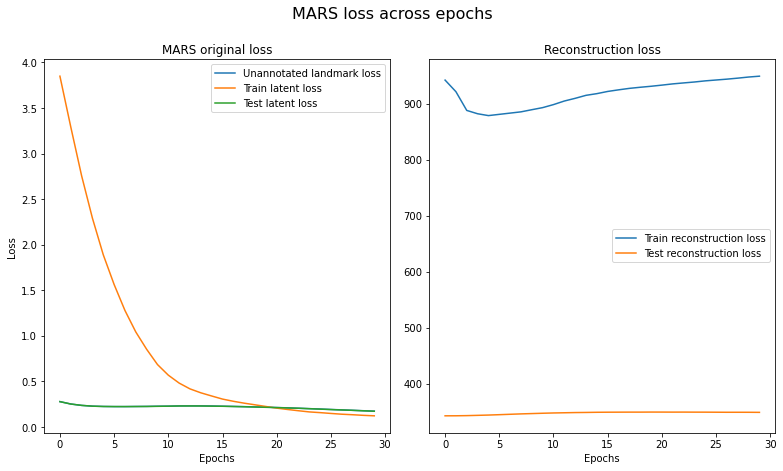

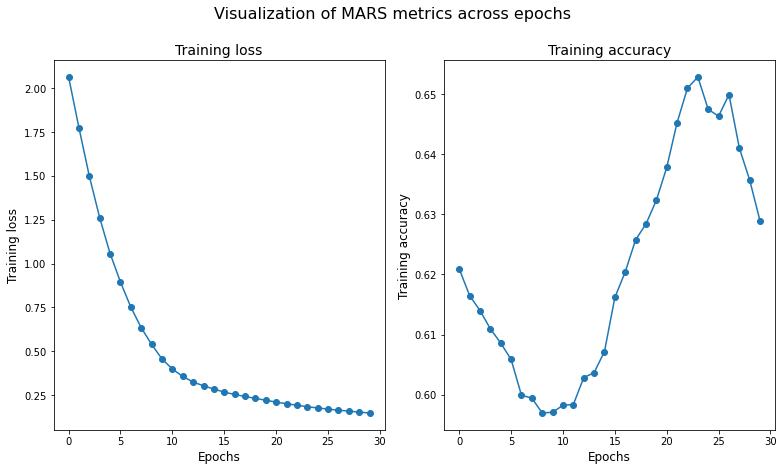

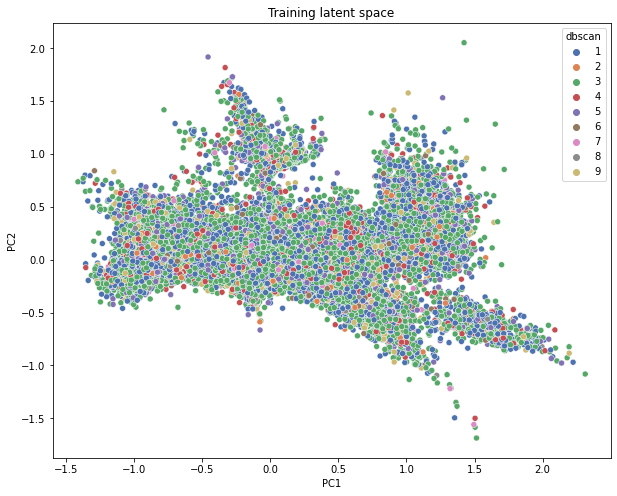

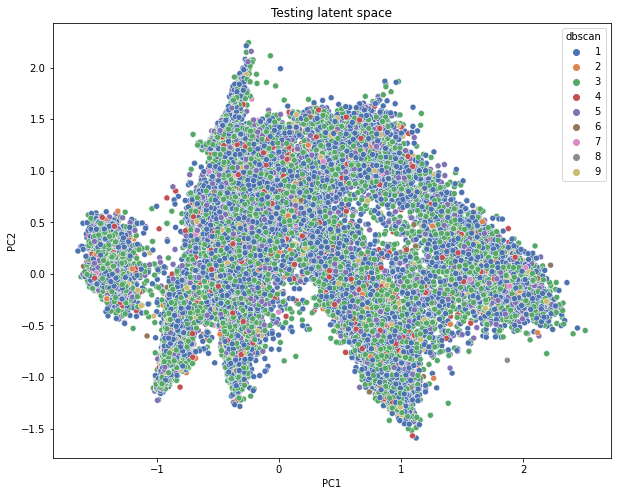

In [49]:
MARS_loss_tracker (vae_merge_training_history, save =True)
MARS_history(vae_merge_training_history, save=True)
MARS_latent_pca(vae_merge_latent_tracker , 29)

... storing 'MARS_labels' as categorical


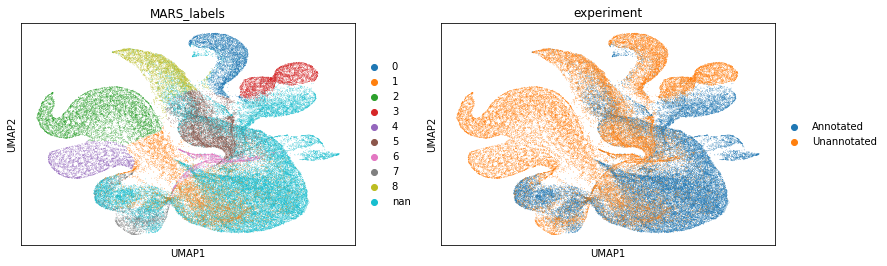

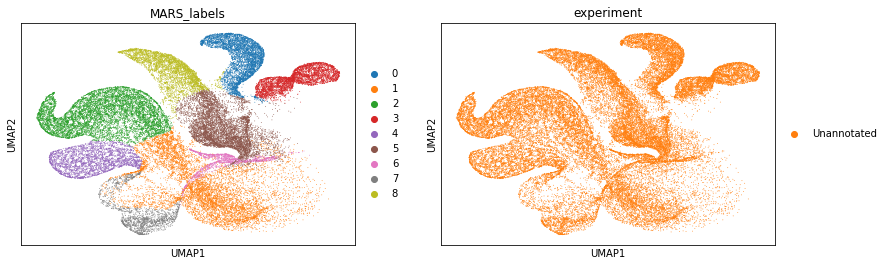

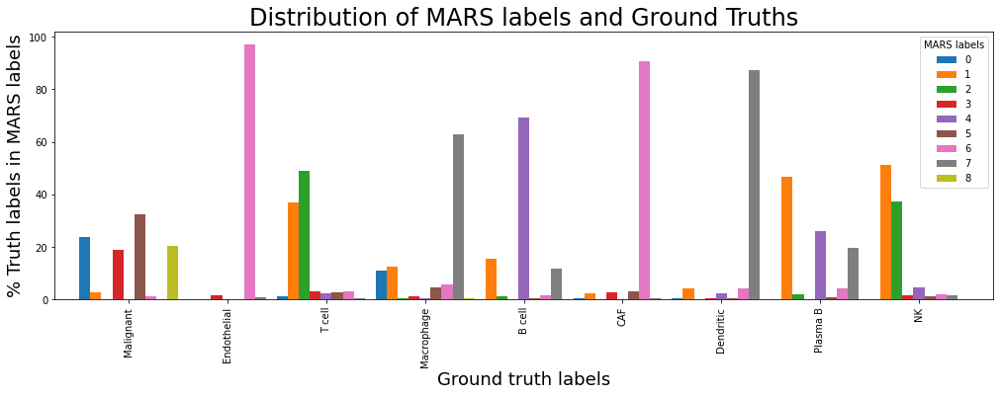

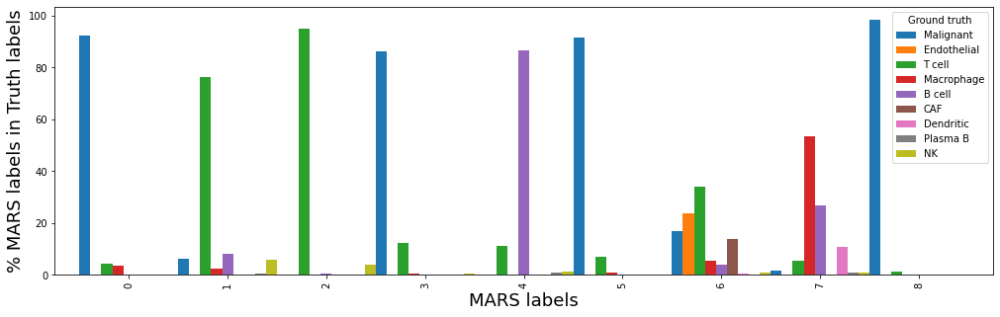

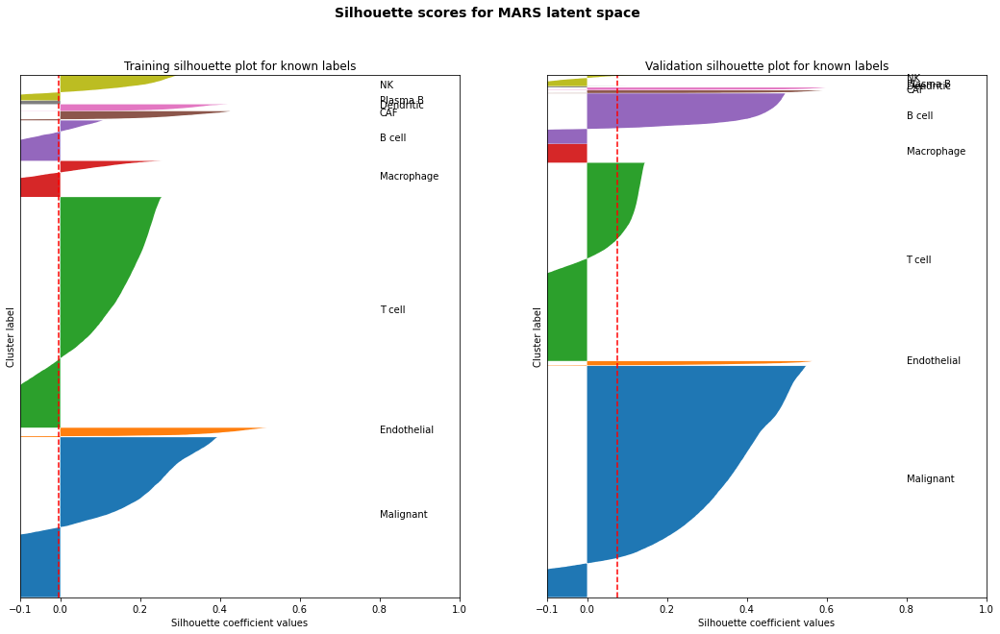

In [50]:
MARS_loss_tracker (vae_merge_training_history, save =True)
MARS_history(vae_merge_training_history, save=True)
MARS_latent_pca(vae_merge_latent_tracker , 29)
MARS_latent_umap( vae_merge_adata, plot_gene_list = ['MARS_labels','experiment'], save=True)
cell_type_assign(vae_merge_adata, save=True)
MARS_silhouette(vae_merge_adata, save=True)

In [322]:
vae_merge_mars11 = VAE_MARS(11 , params, [annotated] , unannotated, pretrain, 
                
                ##These are roll over parametesr form original model 
                hid_dim_1=1000, hid_dim_2=100, p_drop=0.0, tau=1e-3,
                
                ##VAE MARS specific parameters
                latent_dim = 50 , n_feature = len(xy), 
                
                network_architecture={"n_hidden_recog_1": 250, "n_hidden_recog_2": 100,
                           "n_hidden_recog_3": 100, "n_hidden_gener_1": 100,
                           "n_hidden_gener_2": 100, "n_hidden_gener_3": 100},
                
                lambda_reconstruct = 1, lambda_kl = 4)

vae_merge_adata11, vae_merge_landmarks11, vae_merge_scores11 , vae_merge_training_history11, vae_merge_latent_tracker11, pretrainlatent11, pretrainloss11 = vae_merge_mars11.train(evaluation_mode=True,                                                                                                                              save_all_embeddings=True)

Pretraining..
Pretraining Epoch 0, Loss: 360.4928283691406
Time:  2.884570598602295
Pretraining Epoch 1, Loss: 388.8116149902344
Time:  2.8545050621032715
Pretraining Epoch 2, Loss: 347.08038330078125
Time:  2.839343786239624
Pretraining Epoch 3, Loss: 339.4409484863281
Time:  3.580357551574707
Pretraining Epoch 4, Loss: 351.0651550292969
Time:  2.79378080368042
Pretraining Epoch 5, Loss: 354.0928039550781
Time:  2.8272061347961426
Pretraining Epoch 6, Loss: 325.27239990234375
Time:  2.776134729385376
Pretraining Epoch 7, Loss: 360.36651611328125
Time:  2.9173641204833984
Pretraining Epoch 8, Loss: 360.39739990234375
Time:  2.7318131923675537
Pretraining Epoch 9, Loss: 357.2463073730469
Time:  2.7239861488342285
Pretraining Epoch 10, Loss: 332.9481201171875
Time:  2.769845485687256
Pretraining Epoch 11, Loss: 327.1461181640625
Time:  2.991358757019043
Pretraining Epoch 12, Loss: 339.626953125
Time:  2.7376339435577393
Pretraining Epoch 13, Loss: 363.7155456542969
Time:  2.7548761367797

/home/estelle860530/anaconda3/lib/python3.8/site-packages/sklearn/utils/validation.py:67: FutureWarning: Pass labels=[0, 1, 2, 3, 4, 5, 6, 7, 8] as keyword args. From version 0.25 passing these as positional arguments will result in an error
  warnings.warn("Pass {} as keyword args. From version 0.25 "
/home/estelle860530/anaconda3/lib/python3.8/site-packages/sklearn/utils/validation.py:67: FutureWarning: Pass labels=[0, 1, 2, 3, 4, 5, 6, 7, 8] as keyword args. From version 0.25 passing these as positional arguments will result in an error
  warnings.warn("Pass {} as keyword args. From version 0.25 "


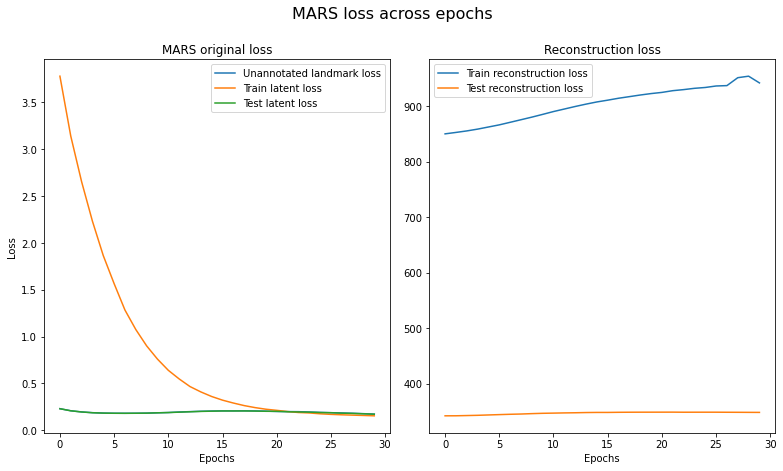

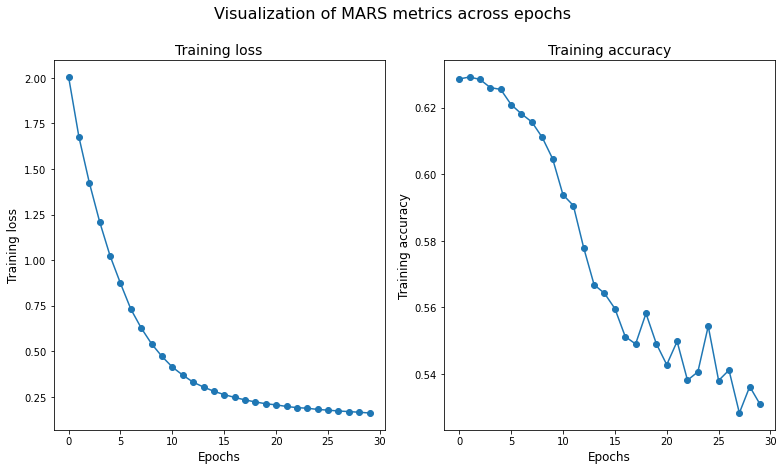

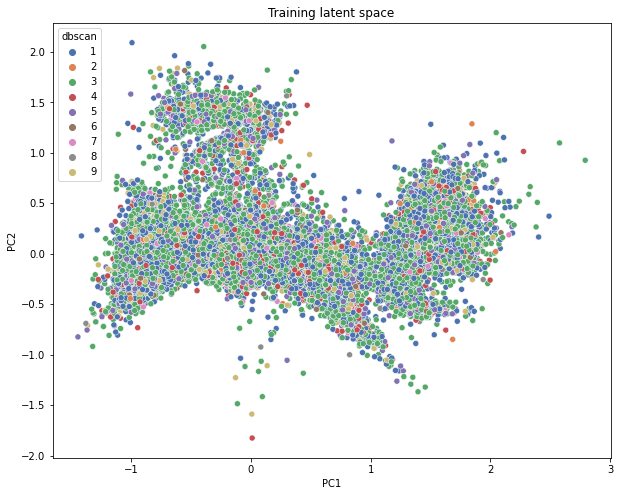

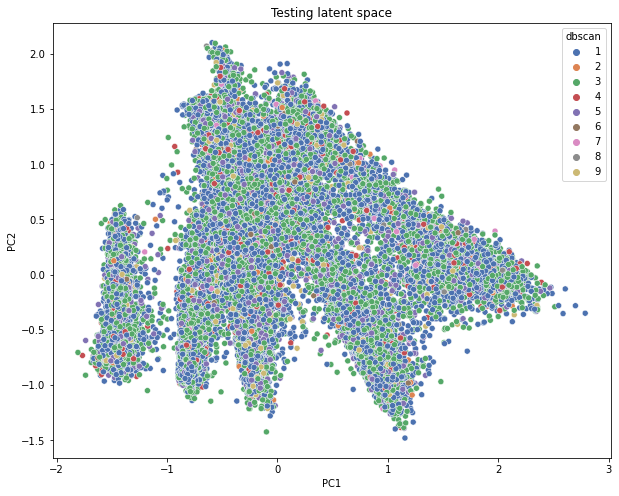

In [323]:
MARS_loss_tracker (vae_merge_training_history11, save =True)
MARS_history(vae_merge_training_history11, save=True)
MARS_latent_pca(vae_merge_latent_tracker11 , 29)

... storing 'MARS_labels' as categorical


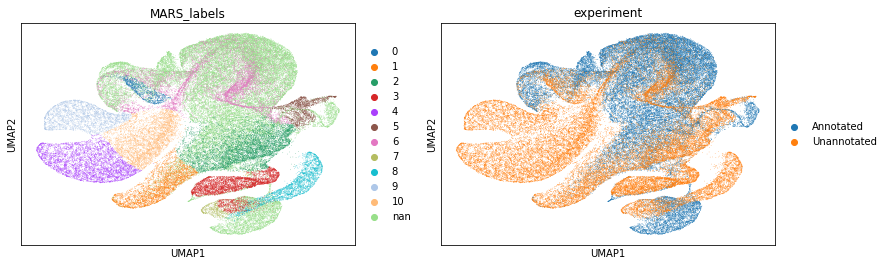

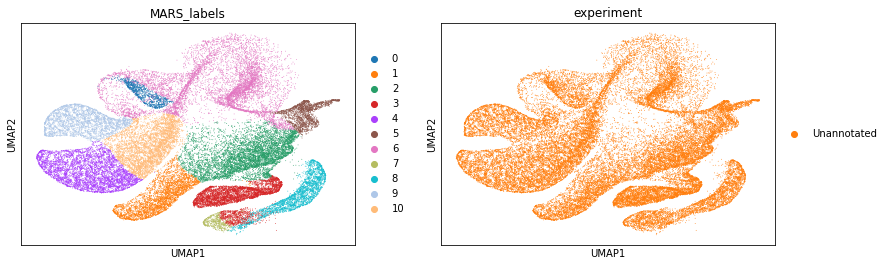

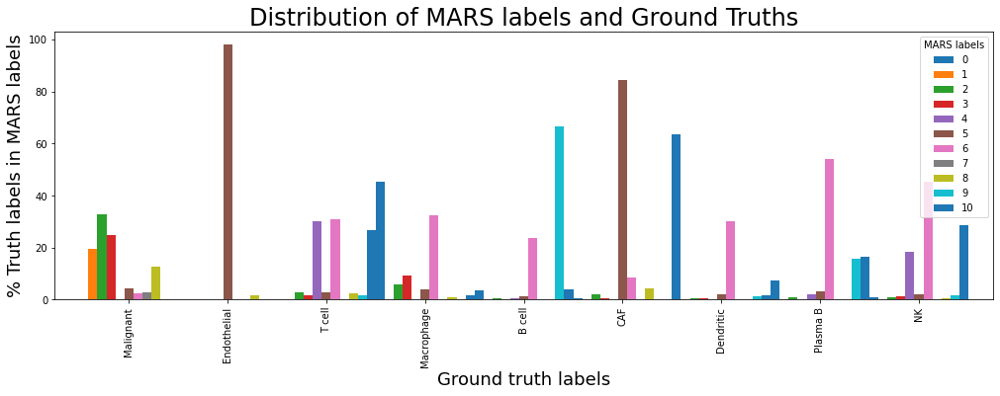

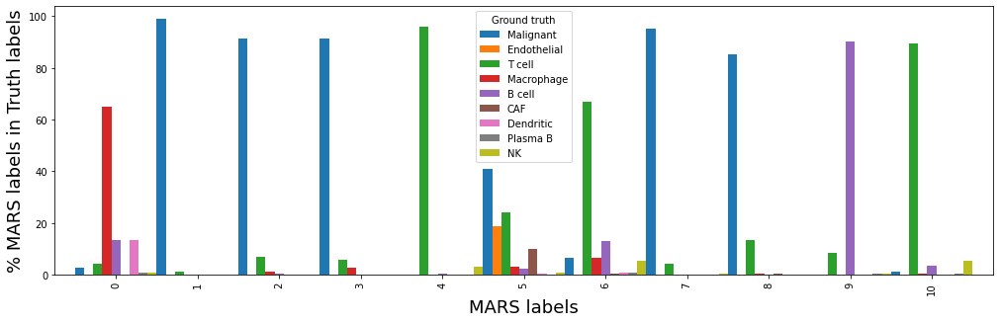

In [325]:
MARS_latent_umap(vae_merge_adata11, plot_gene_list = ['MARS_labels','experiment'], save=True)
cell_type_assign(vae_merge_adata11, save=True)
#MARS_silhouette(vae_merge_adata11, save=True)

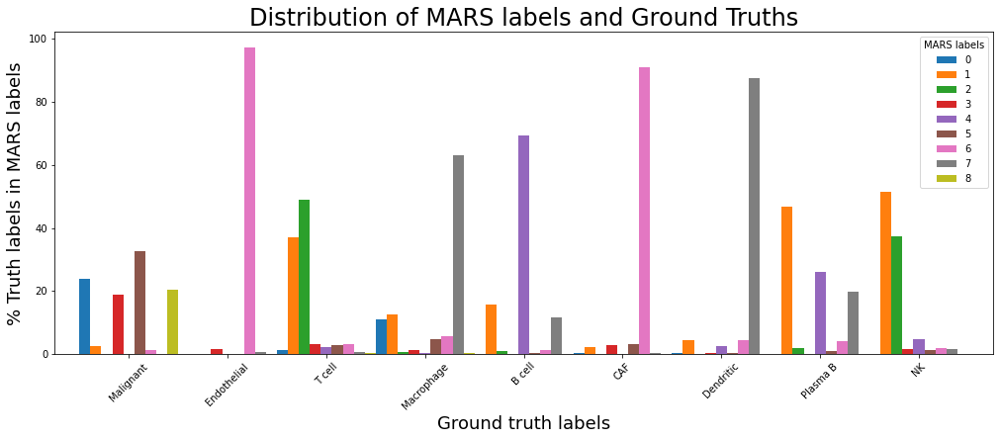

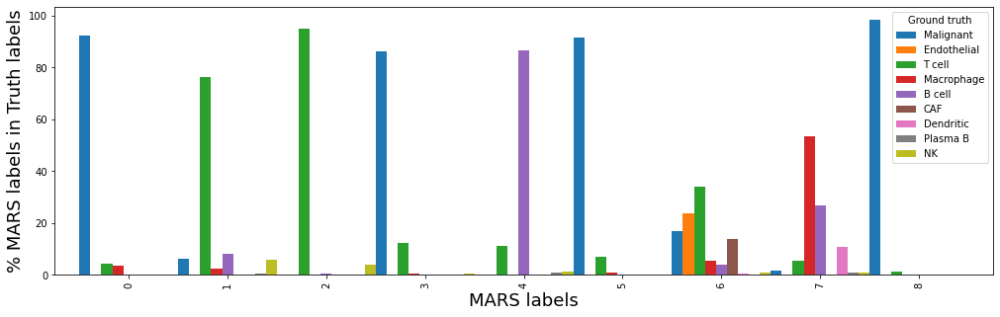

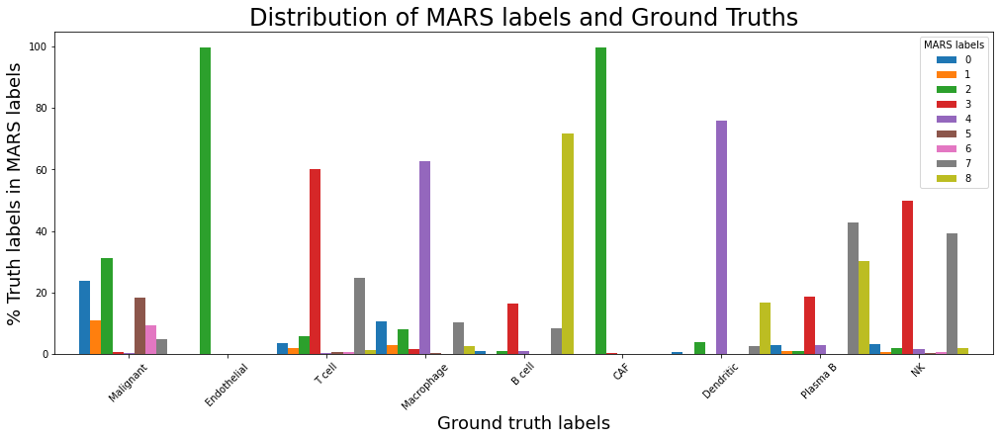

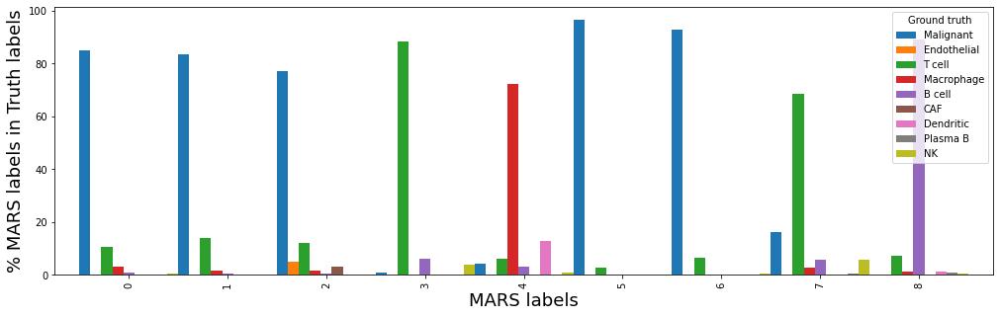

In [56]:
cell_type_assign(vae_merge_adata, save=True)
cell_type_assign(ae_merge_adata, save=True)

### CVAE MARS

In [58]:
import argparse
import torch.utils.data as data
import numpy as np
import torch

def get_parser():
    parser = argparse.ArgumentParser()
    
    parser.add_argument('-pretrain_batch', '--pretrain_batch',
                        type=int,
                        help='Batch size for pretraining. Default: no batch',
                        default=None)
    
    parser.add_argument('-pretrain','--pretrain',
                        type = bool,
                        default = True,
                        help='Pretrain model with autoencoder; otherwise load existing')
    
    parser.add_argument('-nepoch', '--epochs',
                        type=int,
                        help='number of epochs to train for',
                        default=30)

    parser.add_argument('-nepoch_pretrain', '--epochs_pretrain',
                        type=int,
                        help='number of epochs to pretrain for',
                        default=25)

    parser.add_argument('-source_file','--model_file',
                        type = str,
                        default = 'trained_models/source.pt',
                        help='location for storing source model and data')

    parser.add_argument('-lr', '--learning_rate',
                        type=float,
                        help='learning rate for the model, default=0.001',
                        default=0.001)

    parser.add_argument('-lrS', '--lr_scheduler_step',
                        type=int,
                        help='StepLR learning rate scheduler step, default=20',
                        default=20) 

    parser.add_argument('-lrG', '--lr_scheduler_gamma',
                        type=float,
                        help='StepLR learning rate scheduler gamma, default=0.5',
                        default=0.5)
  
    parser.add_argument('-seed', '--manual_seed',
                        type=int,
                        help='input for the manual seeds initializations',
                        default=3)
    
    parser.add_argument('--cuda',
                        action='store_true',
                        help='enables cuda')
    
    return parser


'''
Class representing dataset for an single-cell experiment.
'''

IMG_CACHE = {}


class ExperimentDataset(data.Dataset):
    
    
    def __init__(self, x, cells, genes, metadata, y=[]):
        '''
        x: numpy array of gene expressions of cells (rows are cells)
        cells: cell IDs in the order of appearance
        genes: gene IDs in the order of appearance
        metadata: experiment identifier
        y: numeric labels of cells (empty list if unknown)
        '''
        super(ExperimentDataset, self).__init__()
        
        self.nitems = x.shape[0]
        if len(y)>0:
            print("== Dataset: Found %d items " % x.shape[0])
            print("== Dataset: Found %d classes" % len(np.unique(y)))
                
        if type(x)==torch.Tensor:
            self.x = x
        else:
            shape = x.shape[1]
            self.x = [torch.from_numpy(inst).view(shape).float() for inst in x]
        if len(y)==0:
            y = np.zeros(len(self.x), dtype=np.int64)
        self.y = tuple(y.tolist())
        self.xIDs = cells
        self.yIDs = genes
        self.metadata = metadata
            
    def __getitem__(self, idx):
        return self.x[idx].squeeze(), self.y[idx], self.xIDs[idx], self.metadata[idx].squeeze()
    #, self.yIDs[idx]

    def __len__(self):
        return self.nitems
    
    def get_dim(self):
        return self.x[0].shape[0]

class EpochSampler(object):
    '''
    EpochSampler: yield permuted indexes at each epoch.
   
    __len__ returns the number of episodes per epoch (same as 'self.iterations').
    '''

    def __init__(self, indices):
        '''
        Initialize the EpochSampler object
        Args:
        - labels: an iterable containing all the labels for the current dataset
        samples indexes will be infered from this iterable.
        - iterations: number of epochs
        '''
        super(EpochSampler, self).__init__()
        
        self.indices = indices
        

    def __iter__(self):
        '''
        yield a batch of indexes
        '''
        
    
        while(True):
            shuffled_idx = self.indices[torch.randperm(len(self.indices))]
            
            yield shuffled_idx
            

    def __len__(self):
        '''
        returns the number of iterations (episodes) per epoch
        '''
        return self.iterations
    
import torch
from torch.utils.data import DataLoader ##prefetch by batch
#from model.epoch_sampler import EpochSampler


def init_labeled_loader(data, val_split = 0.8):
    """Initialize loaders for train and validation sets. 
    Class labels are used only
    for stratified sampling between train and validation set.
    
    Validation_split = % keeps in training set 
    
    """
    
    target = torch.tensor(list(data.y))
    uniq = torch.unique(target, sorted=True)
    
    class_idxs = list(map(lambda c: target.eq(c).nonzero(), uniq))
    class_idxs = [idx[torch.randperm(len(idx))] for idx in class_idxs]
    
    train_idx = torch.cat([idx[:int(val_split*len(idx))] for idx in class_idxs])
    val_idx = torch.cat([idx[int(val_split*len(idx)):] for idx in class_idxs])
    
    train_loader = DataLoader(data, 
                              batch_sampler=EpochSampler(train_idx),
                              pin_memory=True)
    
    val_loader = DataLoader(data, 
                            batch_sampler=EpochSampler(val_idx),
                            pin_memory=True)
    
    return train_loader, val_loader


def init_loader(datasets, val_split = 0.8):
    
    train_loader_all = []
    val_loader_all = []
    
    for data in datasets:
        
        curr_load_tr, curr_load_val = init_labeled_loader(data, val_split)
        train_loader_all.append(curr_load_tr)
        val_loader_all.append(curr_load_val)
    
    if val_split==1:
        val_loader_all = None
        
    return train_loader_all, val_loader_all


def init_data_loaders(labeled_data, unlabeled_data, 
                      pretrain_data, pretrain_batch, val_split):
    
    """Initialize loaders for pretraing, 
    training (labeled and unlabeled datasets) and validation. """
    
    train_loader, val_loader = init_loader(labeled_data, val_split)
    
    if not pretrain_data:
        pretrain_data = unlabeled_data
    
    pretrain_loader = torch.utils.data.DataLoader(dataset=pretrain_data,
                                                  shuffle=True,
                                                  batch_size=pretrain_batch if pretrain_batch!=None else len(unlabeled_data.x))        
    test_loader = DataLoader(unlabeled_data, 
                            batch_sampler=EpochSampler(torch.randperm(len(unlabeled_data.x))),
                            pin_memory=True) 
    
    #test_loader,_ = init_loader([unlabeled_data], 1.0) # to reproduce results in the paper
    #test_loader = test_loader[0]
    return train_loader, test_loader, pretrain_loader, val_loader
           
           
def euclidean_dist(x, y):
    '''
    Compute euclidean distance between two tensors
    '''
    # x: N x D
    # y: M x D
    n = x.size(0)
    m = y.size(0)
    d = x.size(1)
    if d != y.size(1):
        raise Exception

    x = x.unsqueeze(1).expand(n, m, d)
    y = y.unsqueeze(0).expand(n, m, d)

    return torch.pow(x - y, 2).sum(2)

import numpy as np
import sklearn.metrics as metrics
from scipy.optimize import linear_sum_assignment 

def compute_scores(y_true, y_pred, scoring={'accuracy','precision','recall','nmi',
                                                'adj_rand','f1_score','adj_mi'}):
    y_true = y_true.cpu().numpy()
    y_pred = y_pred.cpu().numpy()
    
    scores = {}
    y_true, y_pred = hungarian_match(y_true, y_pred)
    set_scores(scores, y_true, y_pred, scoring)
        
    return scores


def set_scores(scores, y_true, y_pred, scoring):
    labels=list(set(y_true))
    
    for metric in scoring:
        if metric=='accuracy':
            scores[metric] = metrics.accuracy_score(y_true, y_pred)
        elif metric=='precision':
            scores[metric] = metrics.precision_score(y_true, y_pred, labels, average='macro')
        elif metric=='recall':
            scores[metric] = metrics.recall_score(y_true, y_pred, labels, average='macro')
        elif metric=='f1_score':
            scores[metric] = metrics.f1_score(y_true, y_pred, labels, average='macro')
        elif metric=='nmi':
            scores[metric] = metrics.normalized_mutual_info_score(y_true, y_pred)
        elif metric=='adj_mi':
            scores[metric] = metrics.adjusted_mutual_info_score(y_true, y_pred)
        elif metric=='adj_rand':
            scores[metric] = metrics.adjusted_rand_score(y_true, y_pred)
                
                
def hungarian_match(y_true, y_pred):
    """Matches predicted labels to original using hungarian algorithm."""
    
    y_true = adjust_range(y_true)
    y_pred = adjust_range(y_pred)
    
    D = max(y_pred.max(), y_true.max()) + 1
    w = np.zeros((D, D), dtype=np.int64)
    # Confusion matrix.
    for i in range(y_pred.size):
        w[y_pred[i], y_true[i]] += 1
    ind = linear_sum_assignment(-w)
    ind = np.asarray(ind)
    ind = np.transpose(ind)
    d = {i:j for i, j in ind}
    y_pred = np.array([d[v] for v in y_pred])
    
    return y_true, y_pred


def adjust_range(y):
    """Assures that the range of indices if from 0 to n-1."""
    y = np.array(y, dtype=np.int64)
    val_set = set(y)
    mapping = {val:i for  i,val in enumerate(val_set)}
    y = np.array([mapping[val] for val in y], dtype=np.int64)
    return y

In [59]:
import torch.nn.functional as F

label = torch.as_tensor (np.concatenate( (np.zeros(raw_rna.shape[0]),np.ones(raw_atac.shape[0]) ), axis=0))
one_hot_label = torch.nn.functional.one_hot(label.to(torch.int64), 2)


In [67]:
cvae_annotated = ExperimentDataset(raw_rna, 
                              mit_data.obs.index, 
                              xy, 
                              one_hot_label[:raw_rna.shape[0]], 
                              rna_y['dbscan'])

cvae_unannotated = ExperimentDataset(raw_atac, 
                                scatac.obs.index, 
                                xy, 
                                one_hot_label[raw_rna.shape[0]:], 
                                atac_y['dbscan'])

cvae_pretrain = ExperimentDataset(raw_atac, 
                             scatac.obs.index, 
                             xy,
                             one_hot_label[raw_rna.shape[0]:])

n_clusters= len(np.unique(unannotated.y))

params, unknown= get_parser().parse_known_args()
if torch.cuda.is_available() and not params.cuda:
        print("WARNING: You have a CUDA device, so you should probably run with --cuda")
device = 'cuda:0' if torch.cuda.is_available() and params.cuda else 'cpu'

params.device = device
params.epochs_pretrain = 30
params.pretrain_batch = 128
params.epochs = 30

== Dataset: Found 46089 items 
== Dataset: Found 9 classes
== Dataset: Found 43956 items 
== Dataset: Found 9 classes


In [61]:
import torch
from torch import nn
from torch.nn import functional as F

class CVAE(nn.Module):
    '''
    '''
    def __init__(self, latent_dim , n_feature , network_architecture , 
                 lambda_reconstruct, lambda_kl , batch_shape=2,
                 p_drop=0.2):
        
        super(CVAE, self).__init__()
        
        self.lambda_reconstruct = lambda_reconstruct
        self.lambda_kl = lambda_kl
        
        self.hidden_encode1=network_architecture['n_hidden_recog_1']
        self.hidden_encode2=network_architecture['n_hidden_recog_2']
        self.hidden_encode3=network_architecture['n_hidden_recog_3']
        
        self.hidden_decode1=network_architecture['n_hidden_gener_1']
        self.hidden_decode2=network_architecture['n_hidden_gener_2']
        self.hidden_decode3=network_architecture['n_hidden_gener_3']
        
        self.latent_dim = latent_dim
        self.n_feature = n_feature
        
        self.batch_shape = batch_shape
        
        self.encoder = nn.Sequential(
            
            nn.Linear(self.n_feature + self.batch_shape , self.hidden_encode1, bias=True),
            
            nn.ELU(alpha=0.2),
            nn.Dropout(p=p_drop),
            nn.Linear(self.hidden_encode1, self.hidden_encode2, bias=True),
            nn.ELU(alpha=0.2),
            nn.Linear(self.hidden_encode2, self.hidden_encode3, bias=True),
            nn.ELU(alpha=0.2)
        )
        
        self.mu = nn.Linear(self.hidden_encode3, self.latent_dim, bias=True)
        self.logvar = nn.Linear(self.hidden_encode3, self.latent_dim, bias=True)
        
        self.decoder = nn.Sequential(
            
            nn.Linear(self.latent_dim + self.batch_shape, self.hidden_decode1, bias=True),
            
            nn.ELU(alpha=0.2),
            nn.Dropout(p=p_drop),
            nn.Linear(self.hidden_decode1, self.hidden_decode2, bias=True),
            nn.ELU(alpha=0.2),
            nn.Linear(self.hidden_decode2, self.hidden_decode3, bias=True),
            nn.ELU(alpha=0.2),
            nn.Linear(self.hidden_decode3, self.n_feature, bias=True)
        )
    
    
    def encode(self, x):
        '''
        Return latent parameters
        '''
        encoded = self.encoder(x)
        
        mu = self.mu(encoded)
        logvar = self.logvar(encoded)
        
        return [mu, logvar]
        
    
    def decode(self, z):
        '''
        Reconstruct
        '''
        decoded = self.decoder(z)
        return decoded
    
    
    def reparameterize(self, mu , logvar):
        ''' 
        Reparametraization sample N(mu, var) from N(0,1) noise
        '''
        std = torch.exp(0.5 * logvar)
        eps = torch.randn_like(std) #std represents the size of the tensor
        
        return eps*std + mu                
      
    def forward(self, x, batch_label):
        
        x = torch.cat((x, batch_label), dim=1)
        
        mu, logvar = self.encode(x)
        
        z = self.reparameterize(mu, logvar)
        
        z = torch.cat((z, batch_label), dim=1)
        
        decoded = self.decode(z)
        
        return decoded, mu, logvar

In [62]:
def loss_task(encoded, prototypes, target, criterion='dist'):
    """Calculate loss.
    criterion: NNLoss - assign to closest prototype and calculate NNLoss
    dist - loss is distance to prototype that example needs to be assigned to
                and -distance to prototypes from other class
    """
    
    uniq = torch.unique(target, sorted=True)
    
    ###index of samples for each class of labels
    class_idxs = list(map(lambda c: target.eq(c).nonzero(), uniq))
    
    # prepare targets so they start from 0,1
    for idx,v in enumerate(uniq):
        target[target==v]=idx
    
    dists = euclidean_dist(encoded, prototypes)
    
    if criterion=='NNLoss':
       
        loss = torch.nn.NLLLoss()
        log_p_y = F.log_softmax(-dists, dim=1)
        
        loss_val = loss(log_p_y, target)
        _, y_hat = log_p_y.max(1)
        
    
    elif criterion=='dist':
        
        loss_val = torch.stack([dists[idx_example, idx_proto].mean(0) for idx_proto,idx_example in enumerate(class_idxs)]).mean()
        #loss_val1 = loss_val1/len(embeddings) 
        y_hat = torch.max(-dists,1)[1]
        
    acc_val = y_hat.eq(target.squeeze()).float().mean()    
        
    return loss_val, acc_val

def loss_test_nn(encoded, prototypes):
    
    dists = euclidean_dist(encoded, prototypes)
    min_dist = torch.min(dists, 1)
    
    y_hat = min_dist[1]
    args_uniq = torch.unique(y_hat, sorted=True)
    args_count = torch.stack([(y_hat==x_u).sum() for x_u in args_uniq])
    print(args_count)
    
    loss = torch.nn.NLLLoss()
    log_p_y = F.log_softmax(-dists, dim=1)
    print(log_p_y.shape)
        
    loss_val = loss(log_p_y, y_hat)
    _, y_hat = log_p_y.max(1)
    
    return loss_val, args_count

###Intra cluster distance
def loss_test_basic(encoded, prototypes):
    
    dists = euclidean_dist(encoded, prototypes)
    min_dist = torch.min(dists, 1)
    
    y_hat = min_dist[1]
    args_uniq = torch.unique(y_hat, sorted=True)
    args_count = torch.stack([(y_hat==x_u).sum() for x_u in args_uniq])
    #print(args_count)
    
    min_dist = min_dist[0] # get_distances
    
    #thr = torch.stack([torch.sort(min_dist[y_hat==idx_class])[0][int(len(min_dist[y_hat==idx_class])*0.9)] for idx_class in args_uniq])
    #loss_val = torch.stack([min_dist[y_hat==idx_class][min_dist[y_hat==idx_class]>=thr[idx_class]].mean(0) for idx_class in args_uniq]).mean()
    
    loss_val = torch.stack([min_dist[y_hat==idx_class].mean(0) for idx_class in args_uniq]).mean()
    
    #loss_val,_ = loss_task(encoded, prototypes, y_hat, criterion='dist') # same
    
    return loss_val, args_count

##For unannotated set 
def loss_test(encoded, prototypes, tau):
    
    #prototypes = torch.stack(prototypes).squeeze() 
    loss_val_test, args_count = loss_test_basic(encoded, prototypes)
    
    ###inter cluster distance 
    if tau>0:
        dists = euclidean_dist(prototypes, prototypes)
        nproto = prototypes.shape[0]
        loss_val2 = - torch.sum(dists)/(nproto*nproto-nproto)
        loss_val_test += tau*loss_val2
        
    return loss_val_test, args_count

def reconstruction_loss(decoded, x):
    
    loss_func = torch.nn.MSELoss()
    loss_rcn = loss_func(decoded, x)
    #print('Reconstruction {}'.format(loss_rcn))
    
    return loss_rcn


def vae_loss(model, decoded, x, mu, logvar):
    
#     loss_func = torch.nn.MSELoss()
#     loss_rcn = loss_func(decoded, x)
    #KL =  torch.mean(-0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp()))
    
    loss_rcn = torch.mean(torch.sum((x - decoded).pow(2),1))
    
    KL_loss = (-0.5)*(1 + logvar - mu.pow(2) - logvar.exp())
    KL = torch.mean(torch.sum(KL_loss, axis=1))
    
    #print(model.lambda_reconstruct, model.lambda_kl)
    total_loss = model.lambda_reconstruct*loss_rcn + model.lambda_kl * KL 
    
    
    #print(f"Reconstruction Loss: {loss_rcn} KL Loss: {KL}")
    
    return total_loss 

In [63]:
import numpy as np
import torch
#from sklearn.cluster import k_means_
from sklearn.cluster import KMeans

## Training set (annotated landmarks)
def compute_landmarks_tr(embeddings, target, prev_landmarks=None, tau=0.2):
    
    """Computing landmarks of each class in the labeled meta-dataset. 
    
    Landmark is a closed form solution of 
    minimizing distance to the mean and maximizing distance to other landmarks. 
    
    If tau=0, landmarks are just mean of data points.
    
    embeddings: embeddings of the labeled dataset
    target: labels in the labeled dataset
    prev_landmarks: landmarks from previous iteration
    tau: regularizer for inter- and intra-cluster distance
    """
    
    uniq = torch.unique(target, sorted=True)
    class_idxs = list(map(lambda c: target.eq(c).nonzero(), uniq))
    
    landmarks_mean = torch.stack([embeddings[idx_class].mean(0) for idx_class in class_idxs]).squeeze()
    
    if prev_landmarks is None or tau==0:
        return landmarks_mean
    
    suma = prev_landmarks.sum(0)
    nlndmk = prev_landmarks.shape[0]
    lndmk_dist_part = (tau/(nlndmk-1))*torch.stack([suma-p for p in prev_landmarks])
    landmarks = 1/(1-tau)*(landmarks_mean-lndmk_dist_part)
    
    return landmarks

In [64]:
def init_landmarks(n_clusters, tr_load, test_load,
                   model, device, mode='kmeans', pretrain=True
                   ):
    """Initialization of landmarks of the labeled and unlabeled meta-dataset.
    nclusters: number of expected clusters in the unlabeled meta-dataset
    tr_load: data loader for labeled meta-dataset
    test_load: data loader for unlabeled meta-dataset
    """
    lndmk_tr = [torch.zeros(size=(len(np.unique(dl.dataset.y)), 
                                  model.latent_dim), 
                            requires_grad=True, device=device) for dl in tr_load]
    
    lndmk_test = [torch.zeros(size=(1, model.latent_dim), 
                              requires_grad=True, device=device) 
                       for _ in range(n_clusters)]
    
    kmeans_init_tr = [init_step(dl.dataset, model, device, pretrained=pretrain, mode=mode) 
                      for dl in tr_load]
    
    kmeans_init_test = init_step(test_load.dataset, model, device, 
                                 pretrained=pretrain, mode=mode, 
                                 n_clusters=n_clusters)
    
    ##No gradient calculation
    with torch.no_grad():
        [lndmk.copy_(kmeans_init_tr[idx])  for idx,lndmk in enumerate(lndmk_tr)]
        [lndmk_test[i].copy_(kmeans_init_test[i,:]) for i in range(kmeans_init_test.shape[0])]
        
    return lndmk_tr, lndmk_test


def init_step(dataset, model, device, pretrained, mode='kmeans',n_clusters=None):
    """Initialization of landmarks with k-means or k-means++ given dataset."""
    
    if n_clusters==None:
        n_clusters = len(np.unique(dataset.y))
    
    nexamples = len(dataset.x)
        
    X =  torch.stack([dataset.x[i] for i in range(nexamples)])
    batch_label = torch.stack([dataset.metadata[i] for i in range(nexamples)])
    
    
    if mode=='kmeans++':
        if not pretrained: # find centroids in original space
            landmarks = k_means_._init_centroids(X.cpu().numpy(), n_clusters, 'k-means++')
            landmarks = torch.tensor(landmarks, device=device)
            landmarks = landmarks.to(device)
            lndmk_encoded,_ = model(landmarks)
            
        else:
            X = X.to(device)
            encoded,_ = model(X)
            landmarks = k_means_._init_centroids(encoded.data.cpu().numpy(), n_clusters, 'k-means++')
            lndmk_encoded = torch.tensor(landmarks, device=device)
    
    elif mode=='kmeans': # run kmeans clustering
        if not pretrained: 
            kmeans = KMeans(n_clusters, random_state=0).fit(X.cpu().numpy())
            landmarks = torch.tensor(kmeans.cluster_centers_, device=device)
            landmarks = landmarks.to(device)
            ##Feed forward net on landmarks  (k means cluster)
            ##landmarks are k means cluster centers = coordinates of cluster center
            #lndmk_encoded,_ = model(landmarks)
            _ , lndmk_encoded, _ = model(landmarks)
        
        ##cluster on lower embedding space
        else:
            X = X.to(device)
            #encoded,_ = model(X)
            decode , encoded, logvar = model(X, batch_label)
            kmeans = KMeans(n_clusters, random_state=0).fit(encoded.data.cpu().numpy())
            lndmk_encoded = torch.tensor(kmeans.cluster_centers_, device=device)
    
    return lndmk_encoded


In [65]:
class CVAE_MARS:
    def __init__(self, n_clusters, params, 
                 labeled_data, unlabeled_data, 
                 pretrain_data=None, 
                 
                 val_split=1.0, hid_dim_1=1000, hid_dim_2=100, p_drop=0.0, tau=0.2,
                 
                 latent_dim = 50, 
                 n_feature = 10, 
                 
                 network_architecture={"n_hidden_recog_1": 250, "n_hidden_recog_2": 100,
                                       "n_hidden_recog_3": 100, "n_hidden_gener_1": 100,
                                       "n_hidden_gener_2": 100, "n_hidden_gener_3": 100},
                 
                 lambda_reconstruct = 1e-4, lambda_kl = 1e-3, batch_shape = 2
                ):
        
        """Initialization of MARS.
        n_clusters: number of clusters in the unlabeled meta-dataset
        params: parameters of the MARS model
        labeled_data: list of labeled datasets. Each dataset needs to be instance of CellDataset.
        unlabeled_data: unlabeled dataset. Instance of CellDataset.
        pretrain_data: dataset for pretraining MARS. Instance of CellDataset. If not specified, unlabeled_data
                        will be used.
        val_split: percentage of data to use for train/val split (default: 1, meaning no validation set)
        hid_dim_1: dimension in the first layer of the network (default: 1000)
        hid_dim_2: dimension in the second layer of the network (default: 100)
        p_drop: dropout probability (default: 0)
        tau: regularizer for inter-cluster distance
        """
        train_load, test_load, pretrain_load, val_load = init_data_loaders(labeled_data, unlabeled_data, 
                                                                           pretrain_data, params.pretrain_batch, 
                                                                           val_split)
        self.train_loader = train_load
        self.test_loader = test_load
        self.pretrain_loader = pretrain_load
        self.val_loader = val_load
        
        ##data file type (string name)
#         self.labeled_metadata = [data.metadata for data in labeled_data]
#         self.unlabeled_metadata = unlabeled_data.metadata
        
        self.labeled_metadata = ["Annotated"]
        self.unlabeled_metadata = "Unannotated"
        
        self.genes = unlabeled_data.yIDs
        
        ##number of genes 
        x_dim = self.test_loader.dataset.get_dim()
        
        ##KNN clusters
        self.n_clusters = n_clusters
        
        ##General Parameters
        self.device = params.device
        self.epochs = params.epochs
        self.epochs_pretrain = params.epochs_pretrain
        self.pretrain_flag = params.pretrain
        self.model_file = params.model_file
        self.lr = params.learning_rate
        self.lr_gamma = params.lr_scheduler_gamma
        self.step_size = params.lr_scheduler_step
        
        self.tau = tau
        
        ##VAE parameter
        self.lambda_reconstruct = lambda_reconstruct
        self.lambda_kl = lambda_kl
        
#         self.hidden_encode1=network_architecture['n_hidden_recog_1']
#         self.hidden_encode2=network_architecture['n_hidden_recog_2']
#         self.hidden_encode3=network_architecture['n_hidden_recog_3']
        
#         self.hidden_decode1=network_architecture['n_hidden_gener_1']
#         self.hidden_decode2=network_architecture['n_hidden_gener_2']
#         self.hidden_decode3=network_architecture['n_hidden_gener_3']
        
        self.latent_dim = latent_dim
        self.n_feature = n_feature
        
        self.batch_shape = batch_shape
        
        self.init_model(self.latent_dim, self.n_feature, network_architecture, 
                        self.lambda_reconstruct, self.lambda_kl, params.device, self.batch_shape)
        
        #print(self.lambda_reconstruct)
        
    ###################################################################
    ###################################################################    
    ###### With the fine tuned hyper parameter     
    ###### Change the implementation of AE to VAE     
    def init_model(self, 
                   latent_dim , 
                   n_feature, 
                   network_architecture, 
                   lambda_reconstruct, lambda_kl,
                   device, batch_shape
                  ):
        """
        Initialize the model.
        """
        #self.model = FullNet(x_dim, hid_dim, z_dim, p_drop).to(device)
        self.model = CVAE(latent_dim = latent_dim, 
                         n_feature = n_feature, 
                         network_architecture= network_architecture,
                         lambda_reconstruct = lambda_reconstruct, 
                         lambda_kl = lambda_kl,
                         batch_shape = batch_shape
                        ).to(device)
        
        
    ###################################################################
    ###################################################################
    
    def init_optim(self, param1, param2, learning_rate):
        """Initializing optimizers."""
        
        optim = torch.optim.Adam(params=param1, lr=learning_rate)
        optim_landmk_test = torch.optim.Adam(params=param2, lr=learning_rate)
        
        return optim, optim_landmk_test
    
    ###################################################################
    ###################################################################
    ########VAE (KL + reconstruction loss + regularized)
    def pretrain(self, optim):
        """
        Pretraining model with variational autoencoder.
        only on unannotated dataset 
        optim: optimizer
        """
        print('Pretraining..')
        
        pretrain_loss =[]
        
        for e in range(self.epochs_pretrain):
            
            start = time.time()
            
            
            for _, batch in enumerate(self.pretrain_loader):
                
                x, y, cell_name, batch_label = batch
                
                x = x.to(self.device)
                batch_label = batch_label.to(self.device)
                
#                 print(batch_label.shape)
#                 print(x.shape)
                
                #_, decoded = self.model(x)
                decoded, mu, logvar = self.model(x , batch_label )
                
                #loss = reconstruction_loss(decoded, x) 
                loss = vae_loss(self.model, decoded, x, mu, logvar)
                
                optim.zero_grad()              
                loss.backward()                    
                optim.step() 
                
                
            pretrain_loss.append(loss) 
            
            print(f"Pretraining Epoch {e}, Loss: {loss}")
            print("Time: ", time.time()-start)
        
        print("Pretraining done")
        return mu, pretrain_loss
    ###################################################################
    ###################################################################
    
    
    def train(self, evaluation_mode=True, save_all_embeddings=True):
        """Train model.
        evaluation_mode: if True, validates model on the unlabeled dataset. 
        In the evaluation mode, ground truth labels of the unlabeled dataset must be 
        provided to validate model
        
        save_all_embeddings: if True, MARS embeddings for annotated and unannotated 
        experiments will be saved in an anndata object,
        otherwise only unnanotated will be saved. 
        If naming is called after, all embeddings need to be saved
        
        return: adata: anndata object containing labeled and unlabeled meta-dataset 
        with MARS embeddings and estimated labels on the unlabeled dataset
                landmk_all: landmarks of the labeled and unlabeled meta-dataset in the 
                order given for training. Landmarks on the unlabeled
                            dataset are provided last
                metrics: clustering metrics if evaluation_mode is True
                
        """
        tr_iter = [iter(dl) for dl in self.train_loader]
        
        if self.val_loader is not None:
            val_iter = [iter(dl) for dl in self.val_loader]
        
        ##############################
        ####Pre train step 
        ##############################
        optim_pretrain = torch.optim.Adam(params=list(self.model.parameters()), lr=self.lr)
        
        if self.pretrain_flag:
            pretrain_latent , pretrain_loss = self.pretrain(optim_pretrain)
        else:
            self.model.load_state_dict(torch.load(self.MODEL_FILE))    
        ##############################
        
        
        test_iter = iter(self.test_loader)
        
        
        ##initialize training (annotated landmark) and testing (unannotated landmark)
        landmk_tr, landmk_test = init_landmarks(self.n_clusters, 
                                                self.train_loader, 
                                                self.test_loader, 
                                                self.model, self.device)
        
        optim, optim_landmk_test = self.init_optim(list(self.model.encoder.parameters()), 
                                                   landmk_test, self.lr)
        
        lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer=optim,
                                                       gamma=self.lr_gamma,
                                                       step_size=self.step_size)
        
        latent_tracker = []
        training_history = {'Loss':[],'Accuracy':[],'Loss_tracker':[]}
        best_acc = 0
        
        for epoch in range(1, self.epochs+1):
            
            start = time.time()
            
            #########################
            #####   Model training 
            #########################
            self.model.train()
            
            ##Do_epoch train over each minibatch return
            ##training loss, accuracy, updated landmarks (annoated and unannotated)
            ##latent_history returns latents space for 1) training 2) testing 3) training landmark 4) testing landmark
            loss_tr, acc_tr, landmk_tr, landmk_test, latent_history, loss_tracker = self.do_epoch(tr_iter, test_iter,
                                                                                    optim, 
                                                                                    optim_landmk_test,
                                                                                    landmk_tr, 
                                                                                    landmk_test)
            
            ##Loss training includes 1 - VAE loss 2- embedding and landmark distance 
            print(f'Epoch {epoch} Loss training: {loss_tr}, Accuracy training: {acc_tr}')
            
            print("Time: ", time.time()-start)
        
            ###Track model training 
            training_history['Loss'].append(loss_tr)
            training_history['Accuracy'].append(acc_tr)
            training_history['Loss_tracker'].append(loss_tracker)
            latent_tracker.append(latent_history)
            
            ##only print out the last epoch result indicating end of training
            if epoch==self.epochs: 
                print('\n=== Epoch: {} ==='.format(epoch))
                print('Train acc: {}'.format(acc_tr))
            
            if self.val_loader is None:
                continue
            
            #########################
            #####   Model evaluation 
            #########################
            self.model.eval()
            
            with torch.no_grad():
                
                loss_val, acc_val = self.do_val_epoch(val_iter, landmk_tr)
                
                if acc_val > best_acc:
                    print('Saving model...')
                    best_acc = acc_val
                    best_state = self.model.state_dict()
                    #torch.save(model.state_dict(), self.model_file)
                postfix = ' (Best)' if acc_val >= best_acc else ' (Best: {})'.format(best_acc)
                print('Val loss: {}, acc: {}{}'.format(loss_val, acc_val, postfix))
            lr_scheduler.step()
            
           
            
            
        if self.val_loader is None:
            best_state = self.model.state_dict() # best is last
        
        landmk_all = landmk_tr + [torch.stack(landmk_test).squeeze()]
        
        ##Test time (assign labels to unlabaled data)
        adata_test, eval_results = self.assign_labels(landmk_all[-1], evaluation_mode)
        
        adata = self.save_result(tr_iter, adata_test, save_all_embeddings)
        
        if evaluation_mode:
            return adata, landmk_all, eval_results, training_history, latent_tracker, pretrain_latent , pretrain_loss
        
        return adata, landmk_all, training_history, latent_tracker, pretrain_latent , pretrain_loss
    
    def save_result(self, tr_iter, adata_test, save_all_embeddings):
        """Saving embeddings from labeled and unlabeled dataset, ground truth labels and 
        predictions to joint anndata object."""
        
        adata_all = []

        if save_all_embeddings:
            for task in range(len(tr_iter)): # saving embeddings from labeled dataset
                
                task = int(task)
                
                x, y, cells, batch_label = next(tr_iter[task])
                x, y = x.to(self.device), y.to(self.device)
                
                #encoded,_ = self.model(x)
                decoded, mu, logvar = self.model(x , batch_label)
                #adata_all.append(self.pack_anndata(x, cells, encoded, gtruth=y))
                adata_all.append(self.pack_anndata(x, cells, mu, gtruth=y))
            
        adata_all.append(adata_test)    
        
        if save_all_embeddings:
            adata = adata_all[0].concatenate(adata_all[1:], 
                                             batch_key='experiment',
                                             batch_categories=self.labeled_metadata+[self.unlabeled_metadata])
        else:
            adata = adata_all[0]

        adata.obsm['MARS_embedding'] = np.concatenate([a.uns['MARS_embedding'] for a in adata_all])
        #adata.write('result_adata.h5ad')
        
        return adata
    
    def assign_labels(self, landmk_test, evaluation_mode):
        """Assigning cluster labels to the unlabeled meta-dataset.
        test_iter: iterator over unlabeled dataset
        landmk_test: landmarks in the unlabeled dataset
        evaluation mode: computes clustering metrics if True
        """
          
        torch.no_grad()
        self.model.eval() # eval mode
        
        test_iter = iter(self.test_loader)
        
        x_test, y_true, cells, batch_label = next(test_iter) # cells are needed because dataset is in random order
        x_test = x_test.to(self.device)
        
        #encoded_test,_ = self.model(x_test)
        decoded, encoded_test, logvar = self.model(x_test, batch_label)
        
        ###Embedding space eucledian distance 
        dists = euclidean_dist(encoded_test, landmk_test)
        
        ###Prediction based on the minimal distance to learned landmark
        y_pred = torch.min(dists, 1)[1]
        
        adata = self.pack_anndata(x_test, cells, encoded_test, y_true, y_pred)
        
        eval_results = None
        if evaluation_mode:
            eval_results = compute_scores(y_true, y_pred)
            
        return adata, eval_results
    
    
    def pack_anndata(self, x_input, cells, embedding, gtruth=[], estimated=[]):
        """Pack results in anndata object.
        x_input: gene expressions in the input space
        cells: cell identifiers
        embedding: resulting embedding of x_test using MARS
        landmk: MARS estimated landmarks
        gtruth: ground truth labels if available (default: empty list)
        estimated: MARS estimated clusters if available (default: empty list)
        """
        adata = anndata.AnnData(x_input.data.cpu().numpy())
        adata.obs_names = cells
        adata.var_names = self.genes
        if len(estimated)!=0:
            adata.obs['MARS_labels'] = pd.Categorical(values=estimated.cpu().numpy())
        if len(gtruth)!=0:
            adata.obs['truth_labels'] = pd.Categorical(values=gtruth.cpu().numpy())
        adata.uns['MARS_embedding'] = embedding.data.cpu().numpy()
        
        return adata
    
    
    ####Originally, MARS does not care about reconstruction loss, it only minimizes embedding to landmark distances
    ####We can alter this by adding reconstruction and KL term to the total loss being regularized 
    
    def do_epoch(self, tr_iter, test_iter, optim, optim_landmk_test, landmk_tr, landmk_test):
        """
        One training epoch.
        tr_iter: iterator over labeled meta-data
        test_iter: iterator over unlabeled meta-data
        
        optim: optimizer for embedding
        optim_landmk_test: optimizer for test landmarks
        
        landmk_tr: landmarks of labeled meta-data from previous epoch
        landmk_test: landmarks of unlabeled meta-data from previous epoch
        """
        
        latent_history = {'Train_latent':[], 'Train_label':[],
                          'Test_latent':[], 'Test_label':[], 
                          'Train_landmark':[], 'Test_landmark':[]
                         }
        loss_tracker = {'Test_anno':0,
                        'Train_latent_loss':0, 'Train_reconstr_loss': 0, 
                        'Test_latent_loss':0, 'Test_reconstr_loss': 0}
        
        self.set_requires_grad(False)
        
        ##Partially freeze landmark_test
        for landmk in landmk_test:
            landmk.requires_grad=False
            
        ##Initialize gradient of landmakr_test
        optim_landmk_test.zero_grad()
        
        ##########################################################################
        ##########################################################################
        # Update centroids    
        ##########################################################################
        ##########################################################################
        
        task_idx = torch.randperm(len(tr_iter)) ##shuffle per epoch
        ###Annotated landmark (No gradient descent needed)
        for task in task_idx:
            
            ##Training set through the VAE to generate latent space
            task = int(task)
            x, y, cell, batch_label = next(tr_iter[task])
            x, y, batch_label = x.to(self.device), y.to(self.device), batch_label.to(self.device)
            #encoded,_ = self.model(x)
            decoded, encoded, logvar = self.model(x, batch_label)
            
            curr_landmk_tr = compute_landmarks_tr(encoded, y, landmk_tr[task], tau=self.tau)
            landmk_tr[task] = curr_landmk_tr.data # save landmarks
            
            latent_history['Train_landmark'].append(encoded)
            latent_history['Train_label'].append(y)
        
        ###Unannotated landmark (Use gradient descent to minimize)
        
        ##Unfreeze landmark_test --> autograd update centroids
        for landmk in landmk_test:
            landmk.requires_grad=True
            
        x, y_test, cell , batch_label = next(test_iter)
        x = x.to(self.device)
        #encoded,_ = self.model(x)
        decoded, encoded, logvar = self.model(x, batch_label)
        
        ###minimize intra cluster difference and maximize inter cluster difference 
        loss, args_count = loss_test(encoded, 
                                     torch.stack(landmk_test).squeeze(), 
                                     self.tau)
        loss.backward()
        optim_landmk_test.step()
        
        latent_history['Test_landmark'].append(encoded)
        latent_history['Test_label'].append(y_test)
        loss_tracker['Test_anno']=loss
        
        ##########################################################################
        ##########################################################################
        # Update embedding
        ##########################################################################
        ##########################################################################
        
        self.set_requires_grad(True)
        for landmk in landmk_test:
            landmk.requires_grad=False
            
        optim.zero_grad()
        total_accuracy = 0
        total_loss = 0
        ntasks = 0
        mean_accuracy = 0
        
        ###Annotated set
        task_idx = torch.randperm(len(tr_iter))
        
        for task in task_idx:
            task = int(task)
            x, y, cell, batch_label = next(tr_iter[task])
            x, y, batch_label = x.to(self.device), y.to(self.device), batch_label.to(self.device)
            #encoded,_ = self.model(x)
            decoded, encoded, logvar = self.model(x, batch_label)
            
            ###Eucledian distance between embedding and landmark
            loss, acc = loss_task(encoded, landmk_tr[task], y, criterion='dist')
            
            ##Add VAE reconstruction loss to the model 
            annotated_vae_loss = vae_loss(self.model, decoded, x, encoded, logvar)
            
            ##Record latent space
            latent_history['Train_latent'].append(encoded)
            
            loss_tracker['Train_latent_loss']=loss
            loss_tracker['Train_reconstr_loss']=annotated_vae_loss
            
            total_loss += loss
            #total_loss += annotated_vae_loss
            
            total_accuracy += acc.item()
            
            ntasks += 1
        
        if ntasks>0:
            mean_accuracy = total_accuracy / ntasks
        
        ##Un-Annotated
        # test part
        x,y, cell, batch_label = next(test_iter)
        x = x.to(self.device)
        #encoded,_ = self.model(x)
        decoded, encoded, logvar = self.model(x, batch_label)
        
        loss,_ = loss_test(encoded, torch.stack(landmk_test).squeeze(), self.tau)
        
        ##Add VAE reconstruction loss to the model 
        unannotated_vae_loss = vae_loss(self.model, decoded, x, encoded, logvar)
        latent_history['Test_latent'].append(encoded)
        
        loss_tracker['Test_latent_loss']=(loss)
        loss_tracker['Test_reconstr_loss']=(unannotated_vae_loss)
            
        total_loss += loss
        #total_loss += unannotated_vae_loss
        ntasks += 1
    
        mean_loss = total_loss / ntasks
        
        mean_loss.backward()
        optim.step()
        
        return mean_loss, mean_accuracy, landmk_tr, landmk_test, latent_history, loss_tracker
    
    def do_val_epoch(self, val_iter, prev_landmk):
        """One epoch of validation.
        val_iter: iterator over validation set
        prev_landmk: landmarks from previous epoch
        """
        ntasks = len(val_iter)
        task_idx = torch.randperm(ntasks)
        
        total_loss = 0
        total_accuracy = 0
        
        for task in task_idx:
            x, y, cell, batch_label = next(val_iter[task])
            x, y, batch_label = x.to(self.device), y.to(self.device), batch_label.to(self.device)
            #encoded = self.model(x)
            decoded, encoded, logvar = self.model(x, batch_label)
            
            ###Eucledian distance between embedding and landmark
            loss, acc = loss_task(encoded, prev_landmk[task], y, criterion='dist')
            val_vae_loss = vae_loss(self.model, decoded, x, encoded, logvar)
            
            #total_loss += val_vae_loss
            total_loss += loss
            total_accuracy += acc.item()
        
        mean_accuracy = total_accuracy / ntasks
        mean_loss = total_loss / ntasks
        
        return mean_loss, mean_accuracy
    
    
    def set_requires_grad(self, requires_grad):
        for param in self.model.parameters():
            param.requires_grad = requires_grad
    
    def name_cell_types(self, adata, landmk_all, cell_name_mappings, 
                        top_match=5, umap_reduce_dim=True, ndim=10):
        """For each test cluster, estimate sigma and mean. 
        Fit Gaussian distribution with that mean and sigma
        and calculate the probability of each of the train landmarks 
        to be the neighbor to the mean data point.
        Normalization is performed with regards to all other landmarks in train."""
        
        experiments = list(OrderedDict.fromkeys(list(adata.obs['experiment'])))
        
        ###only get labels from labeled data
        encoded_tr = []
        landmk_tr = []
        landmk_tr_labels = []
        for idx, exp in enumerate(experiments[:-1]):
            tiss = adata[adata.obs['experiment'] == exp,:]
            
            if exp==self.unlabeled_metadata: 
                raise ValueError("Error: Unlabeled dataset needs to be last one in the input anndata object.")
                
            encoded_tr.append(tiss.obsm['MARS_embedding'])
            landmk_tr.append(landmk_all[idx])
            landmk_tr_labels.append(np.unique(tiss.obs['truth_labels']))
            
        tiss = adata[adata.obs['experiment'] == self.unlabeled_metadata,:]
        ypred_test = tiss.obs['MARS_labels']
        uniq_ytest = np.unique(ypred_test)
        encoded_test = tiss.obsm['MARS_embedding']
        
        landmk_tr_labels = np.concatenate(landmk_tr_labels)
        encoded_tr = np.concatenate(encoded_tr)
        landmk_tr = np.concatenate([p.cpu() for p in landmk_tr])
        
        if  umap_reduce_dim:
            encoded_extend = np.concatenate((encoded_tr, encoded_test, landmk_tr))
            adata = anndata.AnnData(encoded_extend)
            sc.pp.neighbors(adata, n_neighbors=15, use_rep='X')
            sc.tl.umap(adata, n_components=ndim)
            encoded_extend = adata.obsm['X_umap']
            n1 = len(encoded_tr)
            n2 = n1 + len(encoded_test)
            
            ##UMAP embedding space
            encoded_tr = encoded_extend[:n1,:]
            encoded_test = encoded_extend[n1:n2,:]
            landmk_tr = encoded_extend[n2:,:]
        
        interp_names = defaultdict(list)
        for ytest in uniq_ytest:
            print('\nCluster label: {}'.format(str(ytest)))
            idx = np.where(ypred_test==ytest)
            subset_encoded = encoded_test[idx[0],:]
            
            mean = np.expand_dims(np.mean(subset_encoded, axis=0),0)
            
            sigma  = self.estimate_sigma(subset_encoded)
            
            prob = np.exp(-np.power(distance.cdist(mean, landmk_tr, metric='euclidean'),2)/(2*sigma*sigma))
            prob = np.squeeze(prob, 0)
            normalizat = np.sum(prob)
            
            if normalizat==0:
                print('Unassigned')
                interp_names[ytest].append("unassigned")
                continue
            
            prob = np.divide(prob, normalizat)
            
            uniq_tr = np.unique(landmk_tr_labels)
            prob_unique = []
            
            for cell_type in uniq_tr: # sum probabilities of same landmarks
                prob_unique.append(np.sum(prob[np.where(landmk_tr_labels==cell_type)]))
            
            sorted = np.argsort(prob_unique, axis=0)
            best = uniq_tr[sorted[-top_match:]]
            sortedv = np.sort(prob_unique, axis=0)
            sortedv = sortedv[-top_match:]
            for idx, b in enumerate(best):
                interp_names[ytest].append((cell_name_mappings[b], sortedv[idx]))
                print('{}: {}'.format(cell_name_mappings[b], sortedv[idx]))
                
        return interp_names
    
    
    def estimate_sigma(self, dataset):
        nex = dataset.shape[0]
        dst = []
        for i in range(nex):
            for j in range(i+1, nex):
                dst.append(distance.euclidean(dataset[i,:],dataset[j,:]))
        return np.std(dst)

In [68]:
cvae_mars = CVAE_MARS( n_clusters, params, [cvae_annotated], cvae_unannotated, cvae_pretrain, 
                        val_split=1.0, hid_dim_1=1000, hid_dim_2=100, p_drop=0.0, tau=0.2,
                        latent_dim = 50, n_feature = xy.shape[0], 
                        network_architecture={"n_hidden_recog_1": 250, "n_hidden_recog_2": 100,
                                       "n_hidden_recog_3": 100, "n_hidden_gener_1": 100,
                                       "n_hidden_gener_2": 100, "n_hidden_gener_3": 100},
                        lambda_reconstruct = 1, lambda_kl = 4, batch_shape = 2)

#adata, landmarks, scores , training_history, latent_tracker, 
cvae_adata, cvae_landmarks, cvae_scores, cvae_training_history, cvae_latent_tracker, cvae_pretrain_latent , cave_pretrain_loss = cvae_mars.train(evaluation_mode=True,save_all_embeddings=True)

Pretraining..
Pretraining Epoch 0, Loss: 386.8680419921875
Time:  3.2398366928100586
Pretraining Epoch 1, Loss: 348.1111755371094
Time:  3.8659424781799316
Pretraining Epoch 2, Loss: 359.331787109375
Time:  3.2687175273895264
Pretraining Epoch 3, Loss: 336.2635498046875
Time:  3.233062505722046
Pretraining Epoch 4, Loss: 356.0621337890625
Time:  3.195507526397705
Pretraining Epoch 5, Loss: 348.8504333496094
Time:  3.2074451446533203
Pretraining Epoch 6, Loss: 375.2145690917969
Time:  3.1527202129364014
Pretraining Epoch 7, Loss: 315.1657409667969
Time:  3.8107523918151855
Pretraining Epoch 8, Loss: 365.34375
Time:  3.2911694049835205
Pretraining Epoch 9, Loss: 381.31231689453125
Time:  3.0948779582977295
Pretraining Epoch 10, Loss: 309.55975341796875
Time:  3.041426658630371
Pretraining Epoch 11, Loss: 347.5932312011719
Time:  3.5485787391662598
Pretraining Epoch 12, Loss: 364.85198974609375
Time:  3.211394786834717
Pretraining Epoch 13, Loss: 339.49249267578125
Time:  3.19677352905273

/home/estelle860530/anaconda3/lib/python3.8/site-packages/sklearn/utils/validation.py:67: FutureWarning: Pass labels=[0, 1, 2, 3, 4, 5, 6, 7, 8] as keyword args. From version 0.25 passing these as positional arguments will result in an error
  warnings.warn("Pass {} as keyword args. From version 0.25 "
/home/estelle860530/anaconda3/lib/python3.8/site-packages/sklearn/utils/validation.py:67: FutureWarning: Pass labels=[0, 1, 2, 3, 4, 5, 6, 7, 8] as keyword args. From version 0.25 passing these as positional arguments will result in an error
  warnings.warn("Pass {} as keyword args. From version 0.25 "


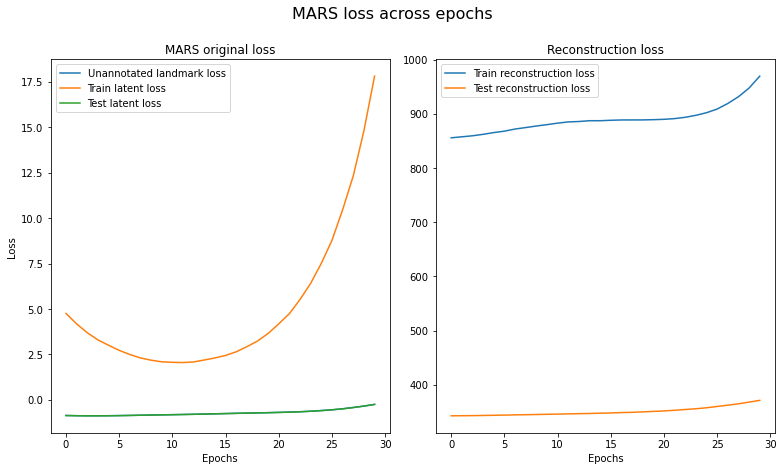

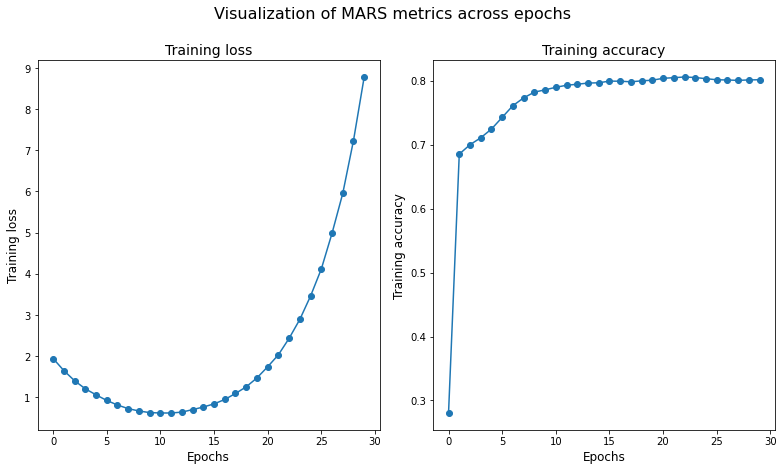

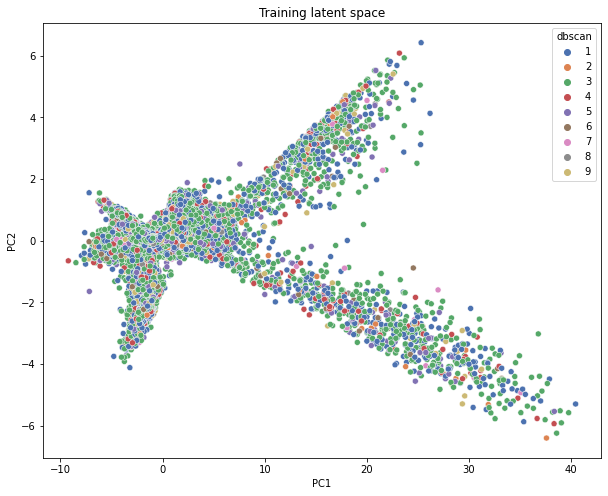

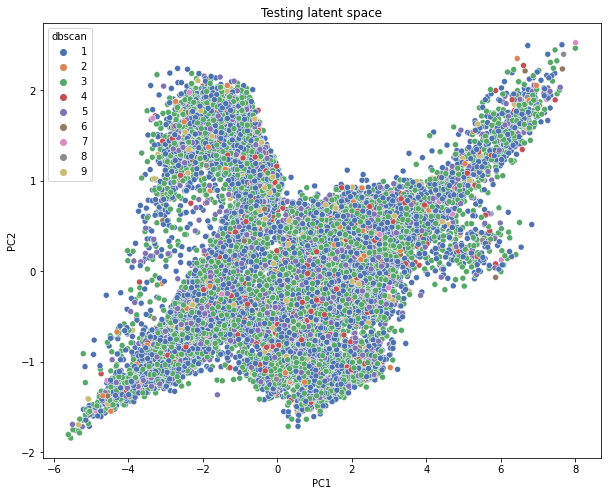

In [69]:
MARS_loss_tracker (cvae_training_history, save =True)
MARS_history(cvae_training_history, save=True)
MARS_latent_pca(cvae_latent_tracker , 29)

... storing 'MARS_labels' as categorical


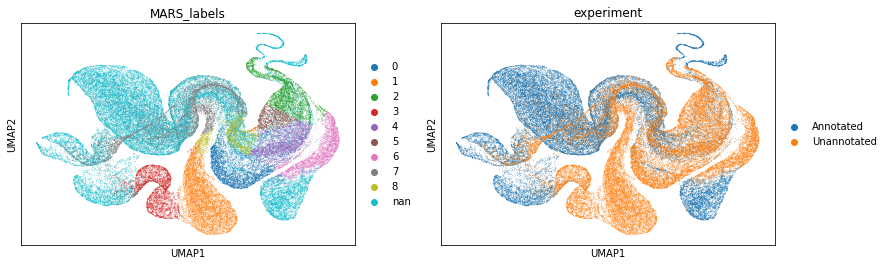

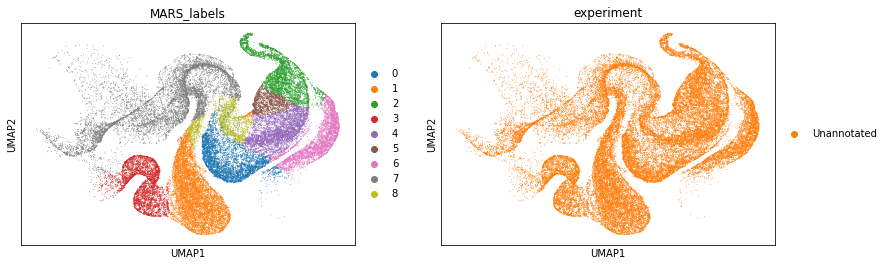

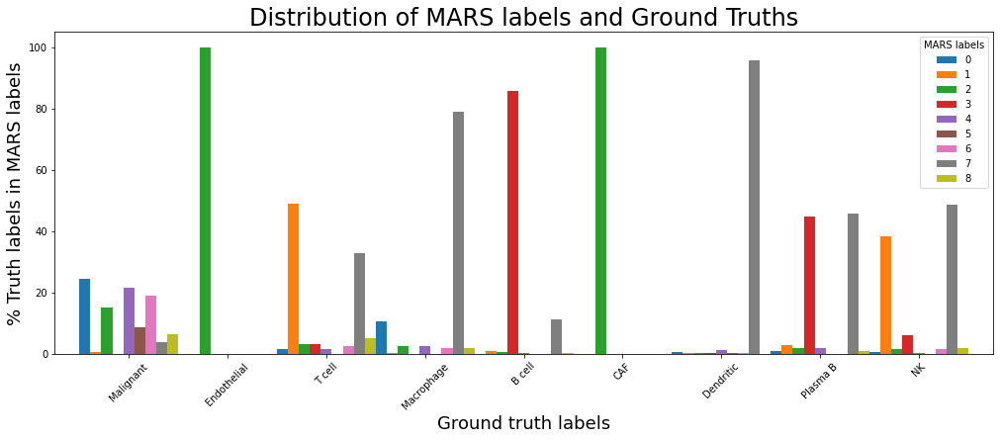

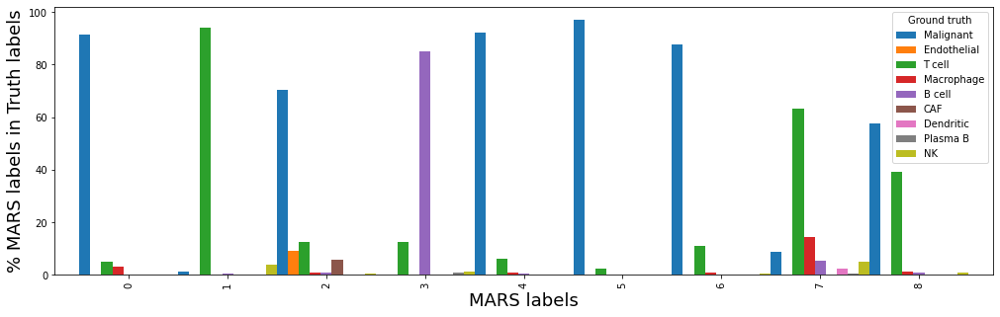

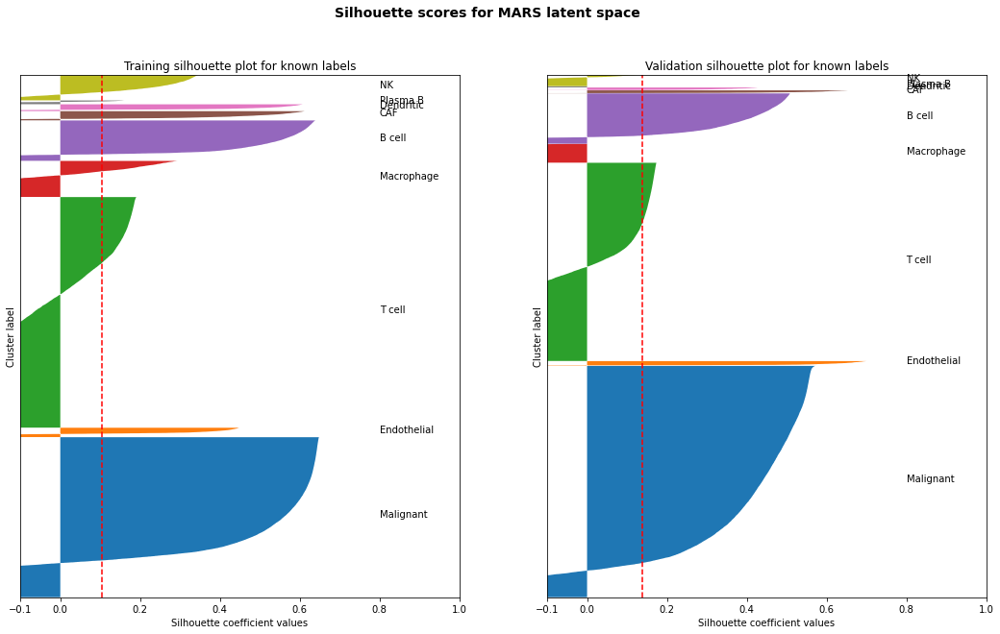

In [70]:
MARS_latent_umap( cvae_adata, plot_gene_list = ['MARS_labels','experiment'], save=True)
cell_type_assign(cvae_adata, save=True)
MARS_silhouette(cvae_adata, save=True)

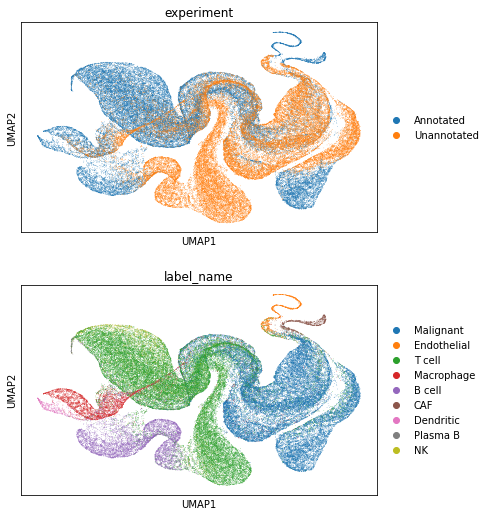

In [332]:
sc.pl.umap(cvae_adata, 
           color=['experiment','label_name'], ncols=1, save=".png")

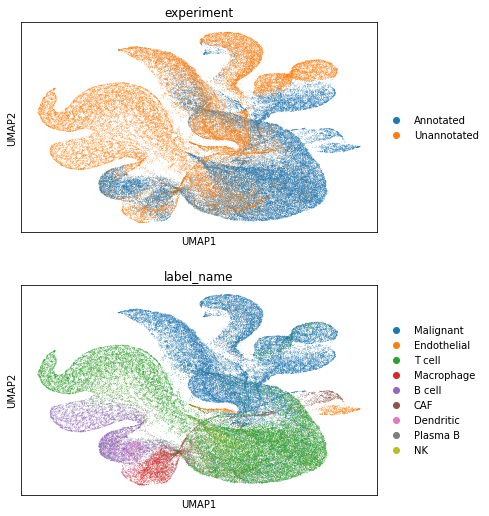

In [333]:
sc.pl.umap(vae_merge_adata, 
           color=['experiment','label_name'], ncols=1, save=".png")

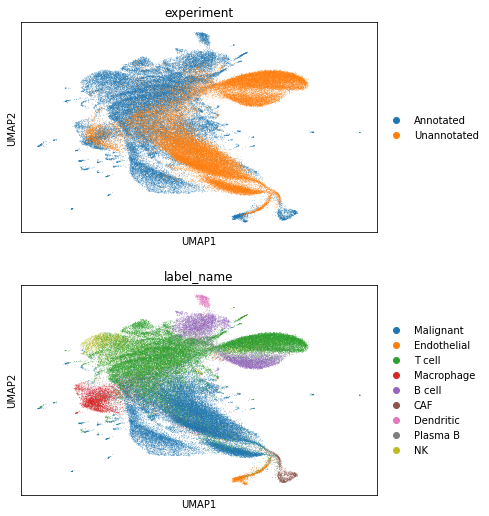

In [334]:
sc.pl.umap(ae_merge_adata, 
           color=['experiment','label_name'], ncols=1, save=".png")

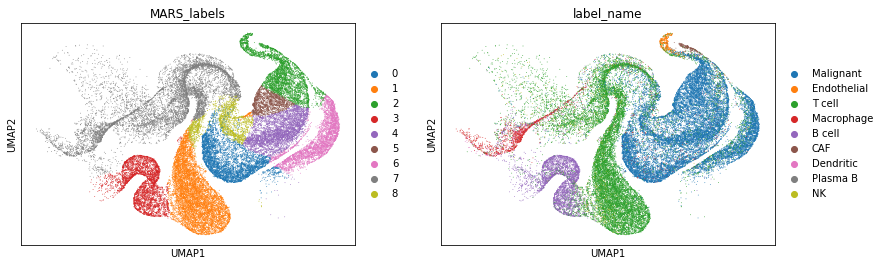

In [87]:
sc.pl.umap(cvae_adata[cvae_adata.obs.experiment=="Unannotated"], 
           color=['MARS_labels', 'label_name'], ncols=2, save=".png")

Trying to set attribute `.uns` of view, copying.


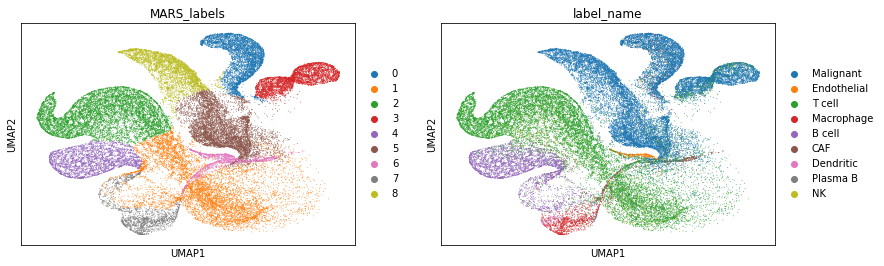

In [88]:
sc.pl.umap(vae_merge_adata[vae_merge_adata.obs.experiment=="Unannotated"], 
           color=['MARS_labels', 'label_name'], ncols=2, save='.png')

Trying to set attribute `.uns` of view, copying.


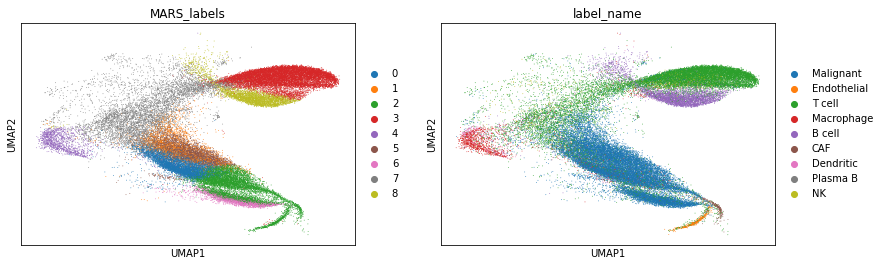

In [89]:
sc.pl.umap(ae_merge_adata[ae_merge_adata.obs.experiment=="Unannotated"], 
           color=['MARS_labels', 'label_name'], ncols=2, save='.png')

Trying to set attribute `.uns` of view, copying.


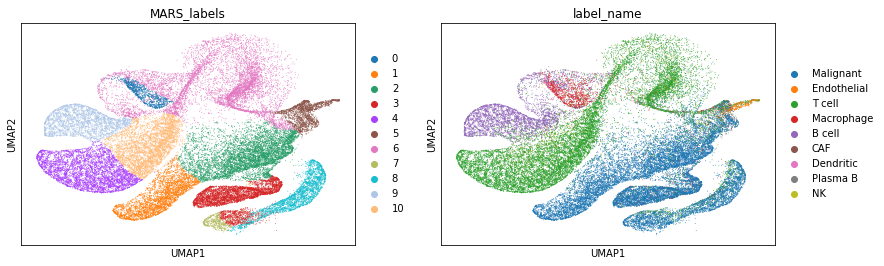

In [326]:
sc.pl.umap(vae_merge_adata11[vae_merge_adata11.obs.experiment=="Unannotated"], 
           color=['MARS_labels', 'label_name'], ncols=2, save='.png')

### Distribution of accuracy metrics

In [328]:
pd.DataFrame([ae_merge_scores,vae_merge_scores,cvae_scores, vae_merge_scores11], index=['AE','VAE','CVAE','VAE11'])

,adj_rand,f1_score,accuracy,adj_mi,recall,precision,nmi
AE,0.280054,0.303364,0.468173,0.398922,0.298035,0.369655,0.399191
VAE,0.303723,0.329141,0.440258,0.454051,0.406157,0.395547,0.454291
CVAE,0.238690,0.256552,0.415939,0.391239,0.379165,0.327488,0.391505
VAE11,0.236687,0.290935,0.359200,0.412558,0.343932,0.375514,0.412868


In [149]:
def MARS_silhouette_score(adata):
    
    
    anno_data = adata[adata.obs['experiment'] == "Annotated", :]
    unanno_data = adata[adata.obs['experiment'] == "Unannotated", :]
    
    anno_obs = anno_data.obs
    unanno_obs = unanno_data.obs
    
    ###Silhouette
    train_latent = anno_data.obsm['MARS_embedding']
    train_sil=silhouette_samples(train_latent, anno_obs['truth_labels'].values)
    
    val_latent = unanno_data.obsm['MARS_embedding']
    val_sil=silhouette_samples(val_latent, unanno_obs['truth_labels'].values)
    
    n_clusters=len(Counter(adata.obs['truth_labels'].values).keys())
    
    train_avg=silhouette_score(train_latent, anno_obs['truth_labels'].values)
    val_avg=silhouette_score(val_latent, unanno_obs['truth_labels'].values)
    
    return train_sil , val_sil, train_avg , val_avg
    
    
#     ###Plot silhouette score for train and test 
#     fig, (ax1, ax2) = plt.subplots(1, 2)
#     fig.set_size_inches(18, 10)
        
#     ax1.set_xlim([-0.1, 1])
#     ax1.set_ylim([0, len(train_latent) + (n_clusters + 1) * 10])
    
#     ax2.set_xlim([-0.1, 1])
#     ax2.set_ylim([0, len(val_latent) + (n_clusters + 1) * 10])
         
#     y_lower = 10
#     val_y_lower = 10
    
    
#     name2num={'Malignant':1, 'Endothelial':2, 'T cell':3, 
#           'Macrophage':4, 'B cell':5,'CAF':6, 
#           'Dendritic':7 ,'Plasma B':8, 'NK':9}

#     cluster_list = list(name2num.keys())
    
#     for i in range(n_clusters):
        
        
#         #cluster_label = list(Counter(adata.obs['truth_labels']).keys())[i]
#         cluster_label = cluster_list[i]
        
#         #############################################################
#         ###############Training 
#         # Aggregate the silhouette scores for samples belonging to
#         # cluster i, and sort them
#         train_ith_cluster_silhouette_values = train_sil[anno_obs['label_name'] == cluster_label]
#         train_ith_cluster_silhouette_values.sort()
        
#         size_cluster_i = train_ith_cluster_silhouette_values.shape[0]
#         y_upper = y_lower + size_cluster_i

#         #color = cm.nipy_spectral(float(i) / n_clusters)
#         ax1.fill_betweenx(np.arange(y_lower, y_upper),
#                           0, train_ith_cluster_silhouette_values) 
#         #edgecolor=color, facecolor=color

#         # Label the silhouette plots with their cluster numbers at the middle
#         ax1.text(0.8, y_lower + 0.5 * size_cluster_i, str(cluster_label))

#         # Compute the new y_lower for next plot
#         y_lower = y_upper + 10  # 10 for the 0 samples
        
#         #############################################################
#         ###############Validation 
#         val_ith_cluster_silhouette_values = val_sil[unanno_obs['label_name'] == cluster_label]
#         val_ith_cluster_silhouette_values.sort()
        
#         val_size_cluster_i = val_ith_cluster_silhouette_values.shape[0]
#         val_y_upper = val_y_lower + val_size_cluster_i

#         #color = cm.nipy_spectral(float(i) / n_clusters)
#         ax2.fill_betweenx(np.arange(val_y_lower, val_y_upper),
#                           0, val_ith_cluster_silhouette_values)
#         # edgecolor=color, facecolor=color

#         # Label the silhouette plots with their cluster numbers at the middle
#         ax2.text(0.8, val_y_lower + 0.5 * val_size_cluster_i, str(cluster_label))

#         # Compute the new y_lower for next plot
#         val_y_lower = val_y_upper + 10  # 10 for the 0 samples
     
#     ax1.set_title("Training silhouette plot for known labels")
#     ax1.set_xlabel("Silhouette coefficient values")
#     ax1.set_ylabel("Cluster label")
    
#     ax2.set_title("Validation silhouette plot for known labels")
#     ax2.set_xlabel("Silhouette coefficient values")
#     ax2.set_ylabel("Cluster label")
    
#     # The vertical line for average silhouette score of all the values
#     train_avg=silhouette_score(train_latent, anno_obs['truth_labels'].values)
#     val_avg=silhouette_score(val_latent, unanno_obs['truth_labels'].values)
    
#     ax1.axvline(x=train_avg, color="red", linestyle="--")
#     ax1.set_yticks([])  # Clear the yaxis labels / ticks
#     ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])
    
#     ax2.axvline(x=val_avg, color="red", linestyle="--")
#     ax2.set_yticks([])  # Clear the yaxis labels / ticks
#     ax2.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])
    
#     plt.suptitle("Silhouette scores for MARS latent space", fontsize=14, fontweight='bold')
#     plt.show()  
    
#     if save ==True:
#         fig.savefig("MARS_silhouette.png")

In [150]:
ae_train_sil , ae_val_sil, ae_train_avg , ae_val_avg = MARS_silhouette_score(ae_merge_adata)

In [151]:
vae_train_sil , vae_val_sil, vae_train_avg , vae_val_avg = MARS_silhouette_score(vae_merge_adata)

In [152]:
cvae_train_sil , cvae_val_sil, cvae_train_avg , cvae_val_avg = MARS_silhouette_score(cvae_adata)

In [156]:
ae_train_avg, vae_train_avg , cvae_train_avg

(0.06210379, -0.0040251184, 0.104644194)

In [157]:
ae_val_avg, vae_val_avg, cvae_val_avg

(0.014520071, 0.07677459, 0.1391623)

In [223]:
ae_train_sil=pd.concat([ae_merge_adata.obs[ae_merge_adata.obs['experiment']=="Annotated"], 
                        pd.DataFrame(ae_train_sil, columns=["Sil"], 
                                     index =  ae_merge_adata.obs[ae_merge_adata.obs['experiment']=="Annotated"].index ) ],
                       axis=1)
ae_train_sil['type']="Annotated AE MARS"
ae_test_sil=pd.concat([ae_merge_adata.obs[ae_merge_adata.obs['experiment']=="Unannotated"], 
                        pd.DataFrame(ae_val_sil, columns=["Sil"], 
                                     index =  ae_merge_adata.obs[ae_merge_adata.obs['experiment']=="Unannotated"].index ) ],
                       axis=1)
ae_test_sil['type']="Unannotated AE MARS"

ae_sil = pd.concat([ae_train_sil ,ae_test_sil],axis=0 )

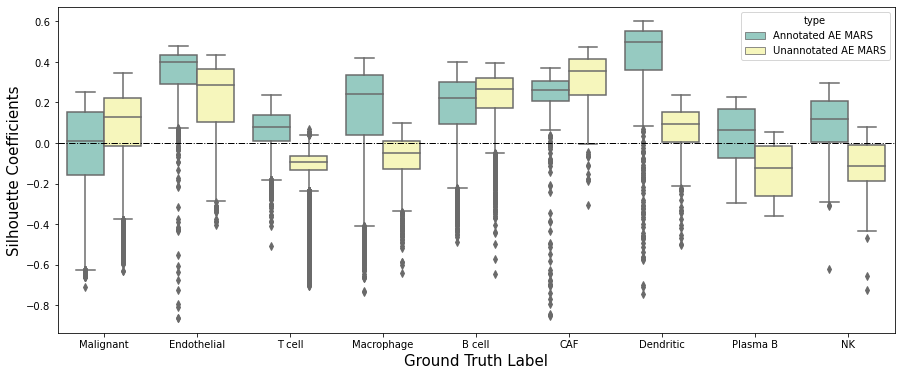

In [224]:
plt.subplots(1,1, figsize=(15,6))
plot = sns.boxplot(x="label_name", y="Sil",hue="type",data=ae_sil, palette="Set3")
plot.set_xlabel("Ground Truth Label", fontsize=15)
plot.set_ylabel("Silhouette Coefficients", fontsize=15)
plot.axhline(linewidth=1, color='black', linestyle="dashdot")
plt.show()

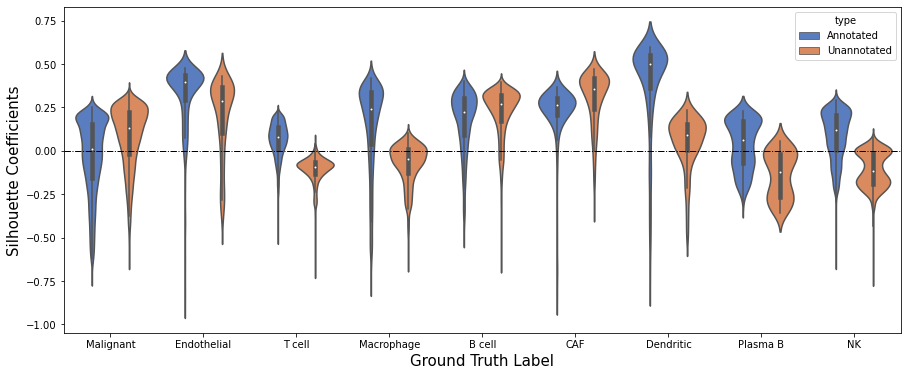

In [214]:
plt.subplots(1,1, figsize=(15,6))
plot = sns.violinplot(x="label_name", y="Sil",hue="type",data=ae_sil, palette="muted")
plot.set_xlabel("Ground Truth Label", fontsize=15)
plot.set_ylabel("Silhouette Coefficients", fontsize=15)
plot.axhline(linewidth=1, color='black', linestyle="dashdot")
plt.show()

In [225]:
vae_train_sil=pd.concat([vae_merge_adata.obs[vae_merge_adata.obs['experiment']=="Annotated"], 
                        pd.DataFrame(vae_train_sil, columns=["Sil"], 
                                     index =  vae_merge_adata.obs[vae_merge_adata.obs['experiment']=="Annotated"].index ) ],
                       axis=1)
vae_train_sil['type']="Annotated VAE MARS"
vae_test_sil=pd.concat([vae_merge_adata.obs[vae_merge_adata.obs['experiment']=="Unannotated"], 
                        pd.DataFrame(vae_val_sil, columns=["Sil"], 
                                     index =  vae_merge_adata.obs[vae_merge_adata.obs['experiment']=="Unannotated"].index ) ],
                       axis=1)
vae_test_sil['type']="Unannotated VAE MARS"

vae_sil = pd.concat([vae_train_sil ,vae_test_sil],axis=0 )

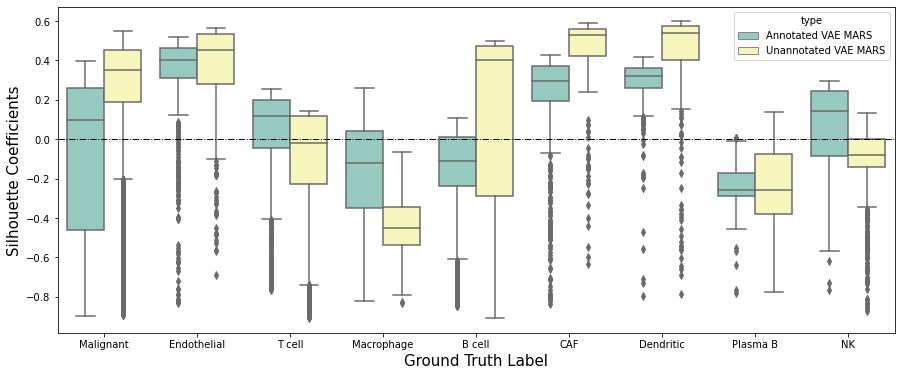

In [226]:
plt.subplots(1,1, figsize=(15,6))
plot = sns.boxplot(x="label_name", y="Sil",hue="type",data=vae_sil, palette="Set3")
plot.set_xlabel("Ground Truth Label", fontsize=15)
plot.set_ylabel("Silhouette Coefficients", fontsize=15)
plot.axhline(linewidth=1, color='black', linestyle="dashdot")
plt.show()

In [227]:
cvae_train_sil=pd.concat([cvae_adata.obs[cvae_adata.obs['experiment']=="Annotated"], 
                        pd.DataFrame(cvae_train_sil, columns=["Sil"], 
                                     index =  cvae_adata.obs[cvae_adata.obs['experiment']=="Annotated"].index ) ],
                       axis=1)
cvae_train_sil['type']="Annotated CVAE MARS"
cvae_test_sil=pd.concat([cvae_adata.obs[cvae_adata.obs['experiment']=="Unannotated"], 
                        pd.DataFrame(cvae_val_sil, columns=["Sil"], 
                                     index =  cvae_adata.obs[cvae_adata.obs['experiment']=="Unannotated"].index ) ],
                       axis=1)
cvae_test_sil['type']="Unannotated CVAE MARS"

cvae_sil = pd.concat([cvae_train_sil ,cvae_test_sil],axis=0 )

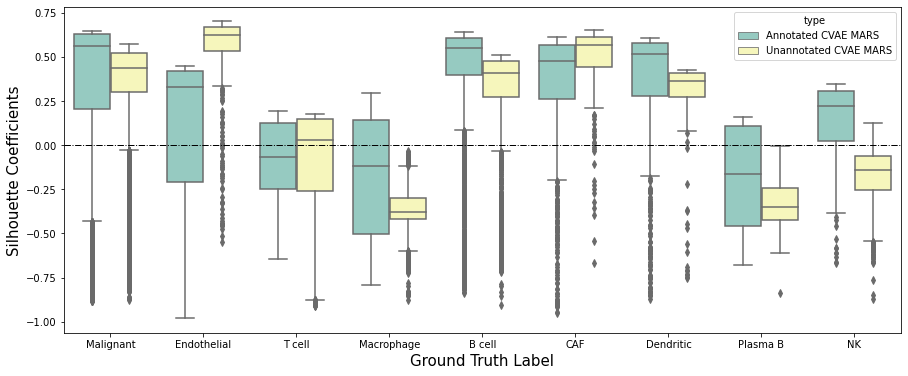

In [231]:
plt.subplots(1,1, figsize=(15,6))
plot = sns.boxplot(x="label_name", y="Sil",hue="type",data=cvae_sil, palette="Set3")
plot.set_xlabel("Ground Truth Label", fontsize=15)
plot.set_ylabel("Silhouette Coefficients", fontsize=15)
plot.axhline(linewidth=1, color='black', linestyle="dashdot")
plt.show()

In [234]:
! pip install statannot

In [255]:
cvae_sil

,truth_labels,MARS_labels,experiment,label_name,Sil,type
PT1227_TACAACGTCGGACCAC-1-Annotated,1,nan,Annotated,Malignant,-0.677864,Annotated CVAE MARS
PT856A_GTAATCGCATCCGAGC-1-Annotated,1,nan,Annotated,Malignant,-0.753904,Annotated CVAE MARS
PT1227_CAGGGCTCACAAAGTA-1-Annotated,3,nan,Annotated,T cell,0.057572,Annotated CVAE MARS
PT856B_TTCTTGACATCCTTGC-1-Annotated,1,nan,Annotated,Malignant,-0.209523,Annotated CVAE MARS
PT1130_TGTGATGAGGGTTAGC-2-Annotated,3,nan,Annotated,T cell,0.039254,Annotated CVAE MARS
...,...,...,...,...,...,...
pt856_B_AGTTTGGAGATTCCGT-1-Unannotated,1,4,Unannotated,Malignant,0.527394,Unannotated CVAE MARS
pt856_B_CTGGCAGGTATTCACG-1-Unannotated,3,1,Unannotated,T cell,0.139623,Unannotated CVAE MARS
pt1227_CTGGGACGTTCTTTGT-1-Unannotated,4,7,Unannotated,Macrophage,-0.136851,Unannotated CVAE MARS
pt1224_post_Cln_GGTACCGCACTTATGG-1-Unannotated,1,0,Unannotated,Malignant,0.502520,Unannotated CVAE MARS


In [260]:
list(Counter(cvae_sil.label_name).keys())

['Malignant',
 'T cell',
 'Macrophage',
 'NK',
 'B cell',
 'CAF',
 'Plasma B',
 'Dendritic',
 'Endothelial']

In [262]:
box_pair = []
for name in list(Counter(cvae_sil.label_name).keys()):
    box_pair.append(((name,'Annotated CVAE MARS'),(name,'Unannotated CVAE MARS') ) )

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

NK_Annotated CVAE MARS v.s. NK_Unannotated CVAE MARS: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=6.373e-251 U_stat=1.800e+06
Endothelial_Annotated CVAE MARS v.s. Endothelial_Unannotated CVAE MARS: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=2.172e-103 U_stat=3.810e+04
Malignant_Annotated CVAE MARS v.s. Malignant_Unannotated CVAE MARS: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=0.000e+00 U_stat=1.822e+08
T cell_Annotated CVAE MARS v.s. T cell_Unannotated CVAE MARS: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.284e-01 U_stat=1.680e+08
Macrophage_Annotated CVAE MARS v.s. Macrophage_Unannotated CVAE MARS: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=6.189e-94 U_stat=3.460e+06
B cell_Annotated C

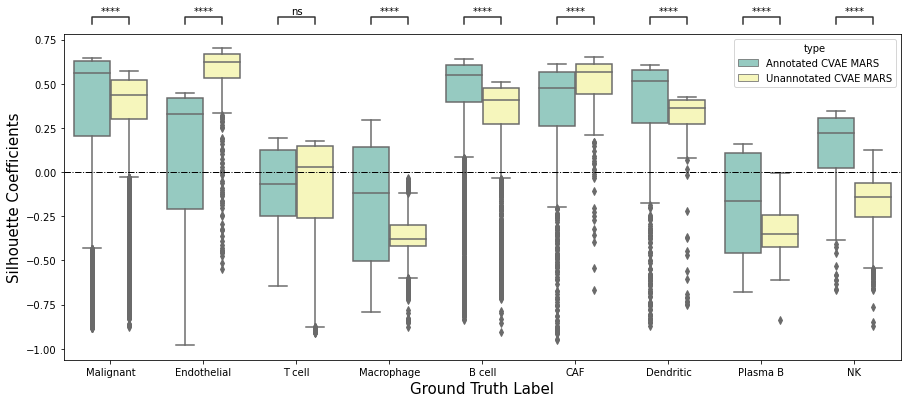

In [265]:
from statannot import add_stat_annotation
plt.subplots(1,1, figsize=(15,6))
plot = sns.boxplot(x="label_name", y="Sil",hue="type",data=cvae_sil, palette="Set3")

plot.set_xlabel("Ground Truth Label", fontsize=15)
plot.set_ylabel("Silhouette Coefficients", fontsize=15)
plot.axhline(linewidth=1, color='black', linestyle="dashdot")

plot= add_stat_annotation(plot, data=cvae_sil, x="label_name", y='Sil', hue='type',
                    box_pairs= box_pair,
                    test='Mann-Whitney', text_format='star', loc='outside', verbose=2)
plt.show()

In [290]:
box_pair = []
for name in list(Counter(cvae_sil.label_name).keys()):
    box_pair.append(((name,'Unannotated AE MARS'),(name,'Unannotated VAE MARS')))
    box_pair.append(((name,'Unannotated AE MARS'),(name,'Unannotated CVAE MARS')))
    box_pair.append(((name,'Unannotated VAE MARS'),(name,'Unannotated CVAE MARS')))

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

T cell_Unannotated AE MARS v.s. T cell_Unannotated VAE MARS: Kruskal-Wallis paired samples with Bonferroni correction, P_val=2.884e-136 stat=6.239e+02
T cell_Unannotated VAE MARS v.s. T cell_Unannotated CVAE MARS: Kruskal-Wallis paired samples with Bonferroni correction, P_val=1.228e-126 stat=5.796e+02
Macrophage_Unannotated AE MARS v.s. Macrophage_Unannotated VAE MARS: Kruskal-Wallis paired samples with Bonferroni correction, P_val=0.000e+00 stat=2.073e+03
Macrophage_Unannotated VAE MARS v.s. Macrophage_Unannotated CVAE MARS: Kruskal-Wallis paired samples with Bonferroni correction, P_val=2.805e-43 stat=1.968e+02
NK_Unannotated AE MARS v.s. NK_Unannotated VAE MARS: Kruskal-Wallis paired samples with Bonferroni correction, P_val=1.808e-02 stat=1.157e+01
B cell_Unannotated AE MARS v.s. B cell_Unannotated VAE MARS: Kruskal-Wal

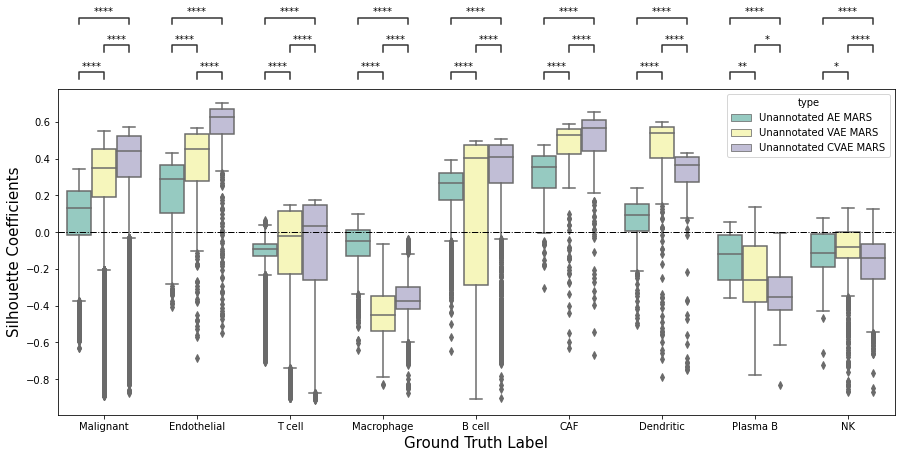

In [291]:
test_sil = pd.concat([ae_test_sil ,vae_test_sil ,cvae_test_sil],axis=0 )
plt.subplots(1,1, figsize=(15,6))
plot = sns.boxplot(x="label_name", y="Sil",hue="type",data=test_sil, palette="Set3")
plot.set_xlabel("Ground Truth Label", fontsize=15)
plot.set_ylabel("Silhouette Coefficients", fontsize=15)
plot.axhline(linewidth=1, color='black', linestyle="dashdot")

plot, test_results = add_stat_annotation(plot, data=test_sil, x="label_name", y='Sil', hue='type',
                    box_pairs= box_pair,
                    test='Kruskal', text_format='star', loc='outside', verbose=2)

plt.show()

In [286]:
plot.get_figure().savefig("test_sil.png",dpi=300, bbox_inches='tight')

In [288]:
box_pair = []
for name in list(Counter(cvae_sil.label_name).keys()):
    box_pair.append(((name,'Annotated AE MARS'),(name,'Annotated VAE MARS')))
    box_pair.append(((name,'Annotated AE MARS'),(name,'Annotated CVAE MARS')))
    box_pair.append(((name,'Annotated VAE MARS'),(name,'Annotated CVAE MARS')))

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

T cell_Annotated AE MARS v.s. T cell_Annotated VAE MARS: Kruskal-Wallis paired samples with Bonferroni correction, P_val=1.529e-129 stat=5.930e+02
T cell_Annotated VAE MARS v.s. T cell_Annotated CVAE MARS: Kruskal-Wallis paired samples with Bonferroni correction, P_val=0.000e+00 stat=5.831e+03
Macrophage_Annotated AE MARS v.s. Macrophage_Annotated VAE MARS: Kruskal-Wallis paired samples with Bonferroni correction, P_val=0.000e+00 stat=2.082e+03
Macrophage_Annotated VAE MARS v.s. Macrophage_Annotated CVAE MARS: Kruskal-Wallis paired samples with Bonferroni correction, P_val=1.615e-01 stat=7.556e+00
NK_Annotated AE MARS v.s. NK_Annotated VAE MARS: Kruskal-Wallis paired samples with Bonferroni correction, P_val=1.440e-01 stat=7.763e+00
B cell_Annotated AE MARS v.s. B cell_Annotated VAE MARS: Kruskal-Wallis paired samples with B

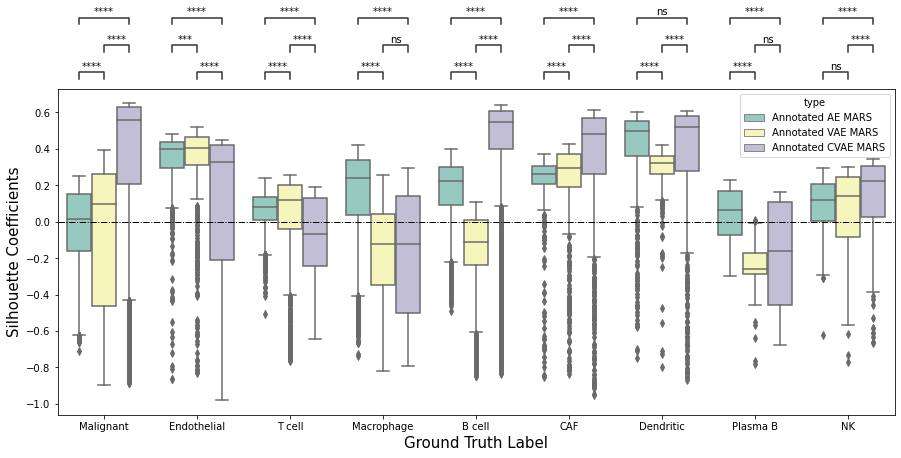

In [289]:
train_sil = pd.concat([ae_train_sil ,vae_train_sil ,cvae_train_sil],axis=0 )
plt.subplots(1,1, figsize=(15,6))
plot = sns.boxplot(x="label_name", y="Sil",hue="type",data=train_sil, palette="Set3")
plot.set_xlabel("Ground Truth Label", fontsize=15)
plot.set_ylabel("Silhouette Coefficients", fontsize=15)
plot.axhline(linewidth=1, color='black', linestyle="dashdot")

plot , test_result= add_stat_annotation(plot, data=train_sil, x="label_name", y='Sil', hue='type',
                    box_pairs= box_pair,
                    test='Kruskal', text_format='star', loc='outside', verbose=2)

plt.show()

plot.get_figure().savefig("train_sil.png",dpi=300, bbox_inches='tight')

### Past exploration 

Pretraining..
Pretraining Epoch 0, Loss: 6958.93994140625
Time:  1.4795761108398438
Pretraining Epoch 1, Loss: 6522.14404296875
Time:  1.43638014793396
Pretraining Epoch 2, Loss: 7327.05517578125
Time:  1.4043807983398438
Pretraining Epoch 3, Loss: 5152.65234375
Time:  1.4452650547027588
Pretraining Epoch 4, Loss: 4193.806640625
Time:  1.4358766078948975
Pretraining Epoch 5, Loss: 12959.029296875
Time:  1.4235429763793945
Pretraining Epoch 6, Loss: 14717.0205078125
Time:  1.641174077987671
Pretraining Epoch 7, Loss: 4302.0126953125
Time:  1.5285654067993164
Pretraining Epoch 8, Loss: 3237.72705078125
Time:  1.5575478076934814
Pretraining Epoch 9, Loss: 5497.04931640625
Time:  1.4356145858764648
Pretraining Epoch 10, Loss: 4304.95556640625
Time:  1.3976471424102783
Pretraining Epoch 11, Loss: 4098.62451171875
Time:  1.4657399654388428
Pretraining Epoch 12, Loss: 3632.001953125
Time:  1.53173828125
Pretraining Epoch 13, Loss: 13110.0615234375
Time:  1.8902459144592285
Pretraining Epoch 1

/home/estelle860530/anaconda3/lib/python3.8/site-packages/sklearn/utils/validation.py:67: FutureWarning: Pass labels=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9] as keyword args. From version 0.25 passing these as positional arguments will result in an error
  warnings.warn("Pass {} as keyword args. From version 0.25 "
/home/estelle860530/anaconda3/lib/python3.8/site-packages/sklearn/utils/validation.py:67: FutureWarning: Pass labels=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9] as keyword args. From version 0.25 passing these as positional arguments will result in an error
  warnings.warn("Pass {} as keyword args. From version 0.25 "


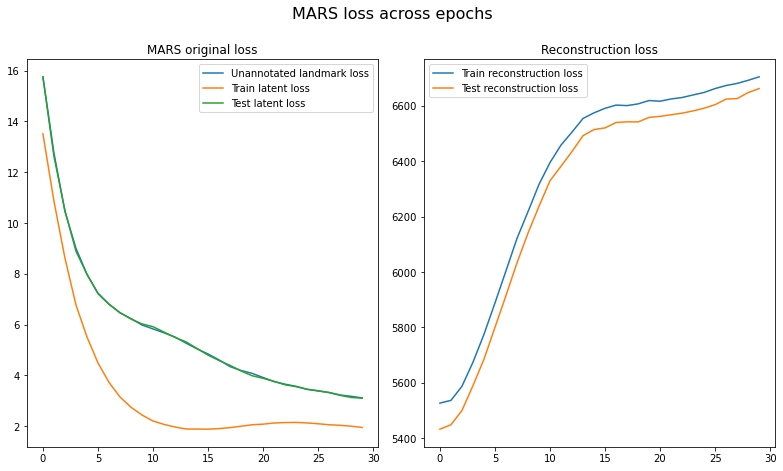

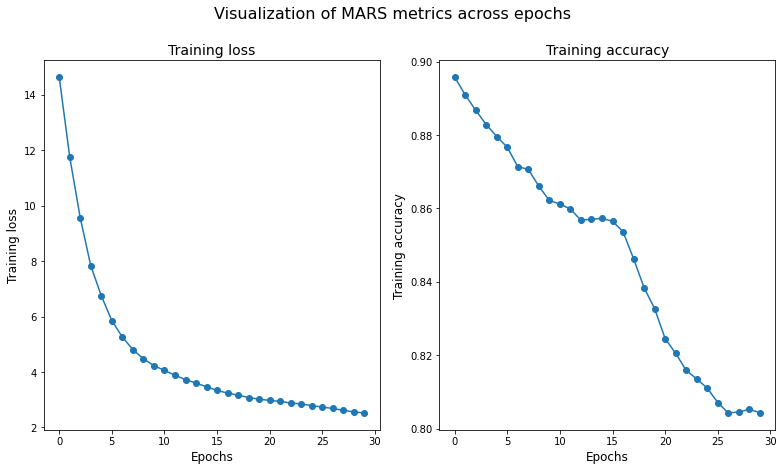

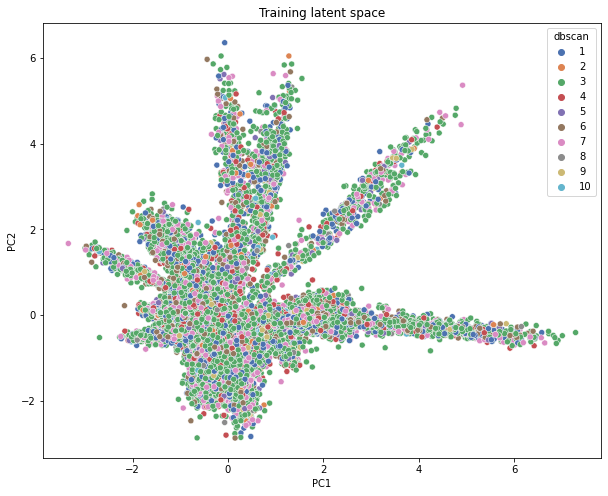

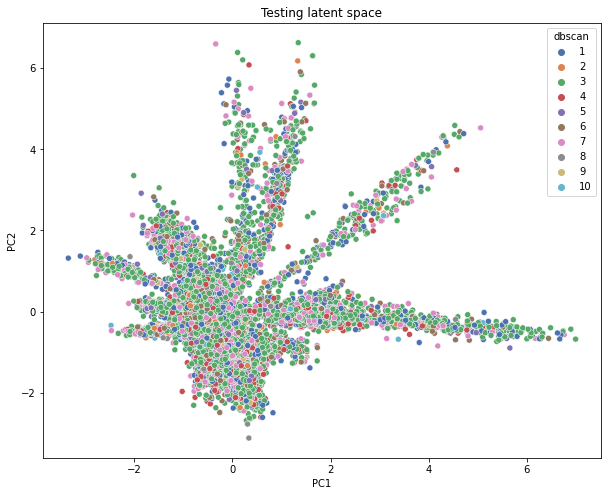

In [29]:
mars_neg3_4 = VAE_MARS(n_clusters, params, [annotated] , unannotated, pretrain, 
                
                ##These are roll over parametesr form original model 
                hid_dim_1=1000, hid_dim_2=100, p_drop=0.0, tau=1e-3,
                
                ##VAE MARS specific parameters
                latent_dim = 50 , n_feature = len(mit_data.var_names), 
                
                network_architecture={"n_hidden_recog_1": 250, "n_hidden_recog_2": 100,
                           "n_hidden_recog_3": 100, "n_hidden_gener_1": 100,
                           "n_hidden_gener_2": 100, "n_hidden_gener_3": 100},
                
                lambda_reconstruct = 1, lambda_kl = 4)

adata_neg3_4, landmarks_neg3_4, scores_neg3_4 , training_history_neg3_4, latent_tracker_neg3_4, pretrain_latent_neg3_4 , pretrain_loss_neg3_4= mars_neg3_4.train(evaluation_mode=True,
save_all_embeddings=True)

MARS_loss_tracker (training_history_neg3_4)
MARS_history(training_history_neg3_4)
MARS_latent_pca(latent_tracker_neg3_4 , 29)

... storing 'MARS_labels' as categorical


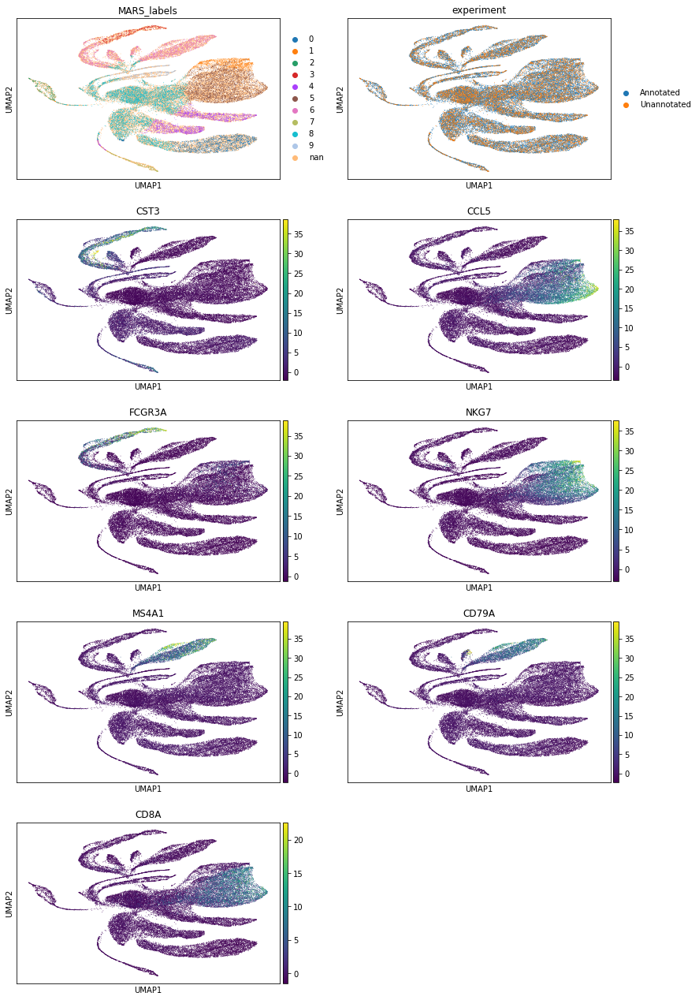

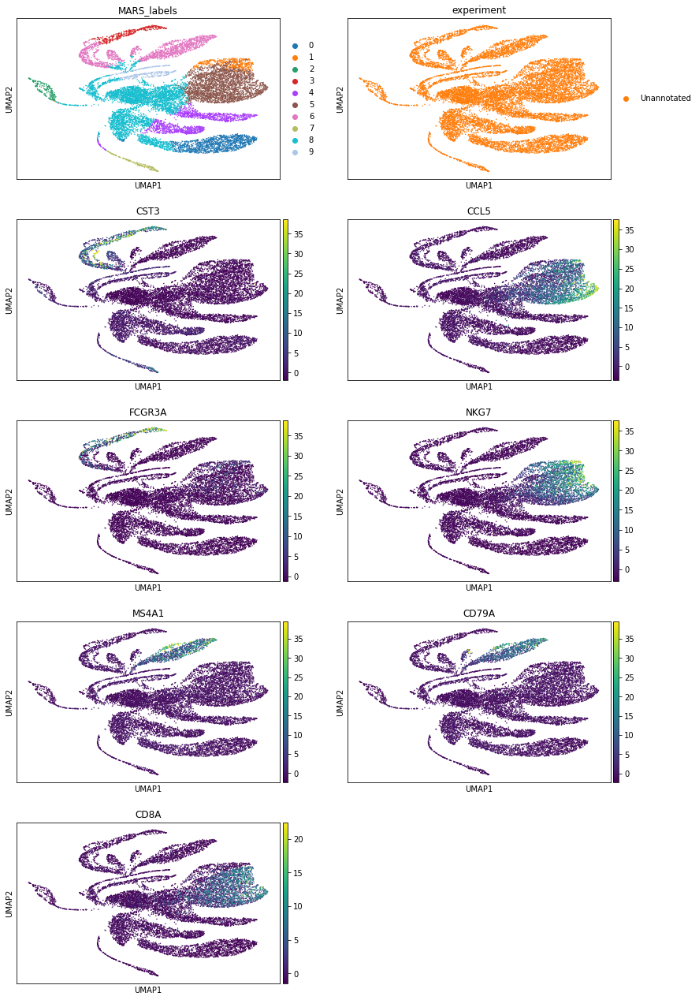

In [30]:
MARS_latent_umap(adata_neg3_4, plot_gene_list = ['MARS_labels','experiment',
                                              'CST3','CCL5','FCGR3A','NKG7','MS4A1','CD79A','CD8A'])

Pretraining..
Pretraining Epoch 0, Loss: 5422.00048828125
Time:  2.34669828414917
Pretraining Epoch 1, Loss: 9190.03125
Time:  1.5680129528045654
Pretraining Epoch 2, Loss: 2021.4112548828125
Time:  1.3776013851165771
Pretraining Epoch 3, Loss: 2838.090576171875
Time:  1.4790189266204834
Pretraining Epoch 4, Loss: 3178.71826171875
Time:  1.4082131385803223
Pretraining Epoch 5, Loss: 11678.591796875
Time:  1.431241750717163
Pretraining Epoch 6, Loss: 3118.401611328125
Time:  1.731307029724121
Pretraining Epoch 7, Loss: 4915.70849609375
Time:  1.3810014724731445
Pretraining Epoch 8, Loss: 8848.6953125
Time:  1.4609191417694092
Pretraining Epoch 9, Loss: 20161.6171875
Time:  1.4287893772125244
Pretraining Epoch 10, Loss: 11188.189453125
Time:  1.4398918151855469
Pretraining Epoch 11, Loss: 5190.08447265625
Time:  1.3614275455474854
Pretraining Epoch 12, Loss: 6831.86279296875
Time:  1.9750709533691406
Pretraining Epoch 13, Loss: 7760.00830078125
Time:  1.448911428451538
Pretraining Epoch 

/home/estelle860530/anaconda3/lib/python3.8/site-packages/sklearn/utils/validation.py:67: FutureWarning: Pass labels=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9] as keyword args. From version 0.25 passing these as positional arguments will result in an error
  warnings.warn("Pass {} as keyword args. From version 0.25 "
/home/estelle860530/anaconda3/lib/python3.8/site-packages/sklearn/utils/validation.py:67: FutureWarning: Pass labels=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9] as keyword args. From version 0.25 passing these as positional arguments will result in an error
  warnings.warn("Pass {} as keyword args. From version 0.25 "


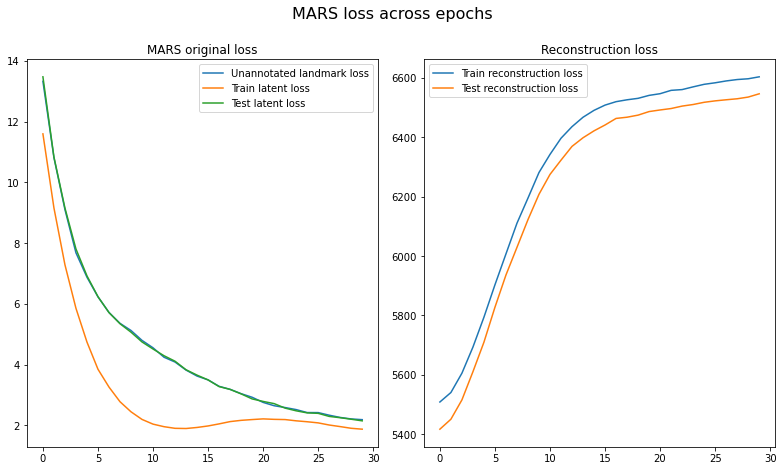

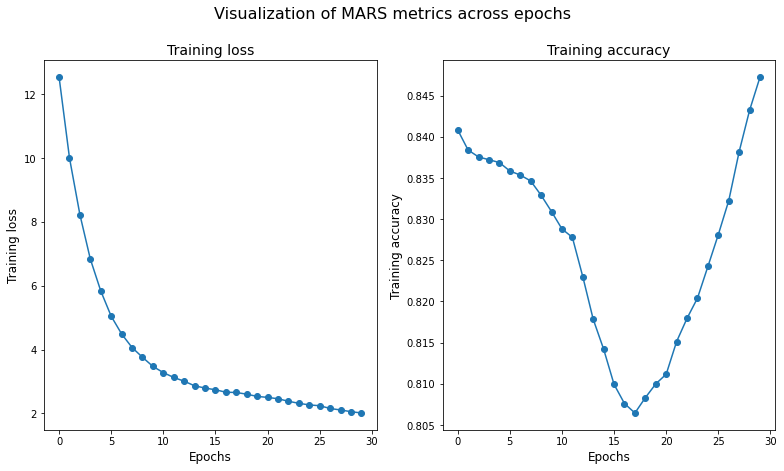

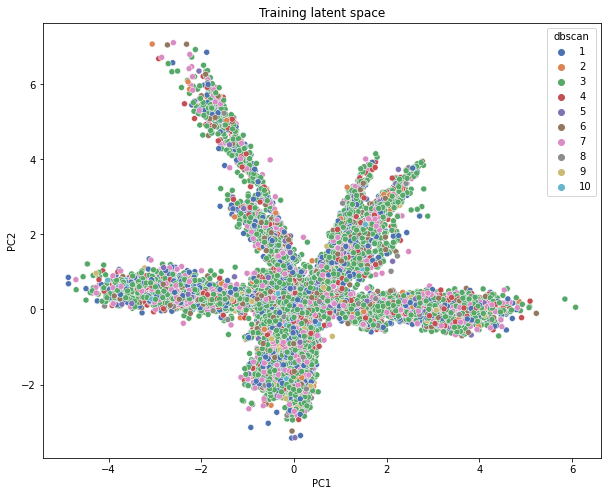

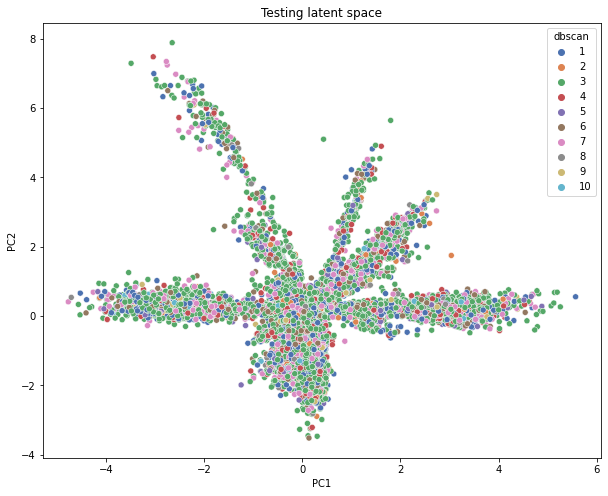

In [27]:
mars_smalltau4 = VAE_MARS(n_clusters, params, [annotated] , unannotated, pretrain, 
                
                ##These are roll over parametesr form original model 
                hid_dim_1=1000, hid_dim_2=100, p_drop=0.0, tau=0.01,
                
                ##VAE MARS specific parameters
                latent_dim = 50 , n_feature = len(mit_data.var_names), 
                
                network_architecture={"n_hidden_recog_1": 250, "n_hidden_recog_2": 100,
                           "n_hidden_recog_3": 100, "n_hidden_gener_1": 100,
                           "n_hidden_gener_2": 100, "n_hidden_gener_3": 100},
                
                lambda_reconstruct = 1, lambda_kl = 4)

adata_smalltau4, landmarks_smalltau4, scores_smalltau4 , training_history_smalltau4, latent_tracker_smalltau4, pretrain_latent_smalltau4 , pretrain_loss_smalltau4 = mars_smalltau4.train(evaluation_mode=True,
save_all_embeddings=True)

MARS_loss_tracker (training_history_smalltau4)
MARS_history(training_history_smalltau4)
MARS_latent_pca(latent_tracker_smalltau4 , 29)

... storing 'MARS_labels' as categorical


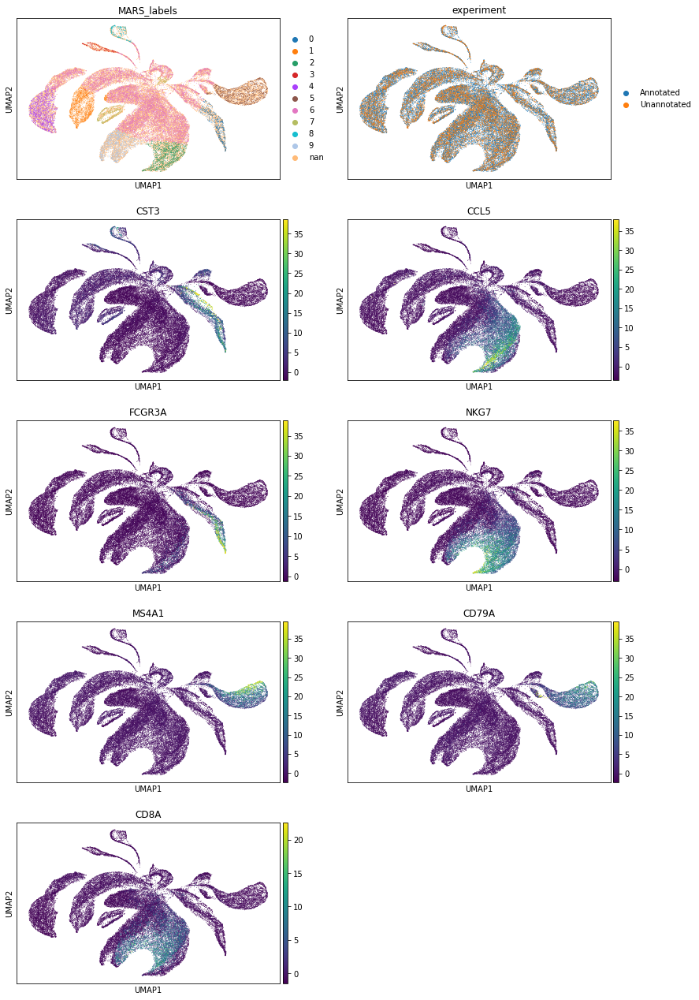

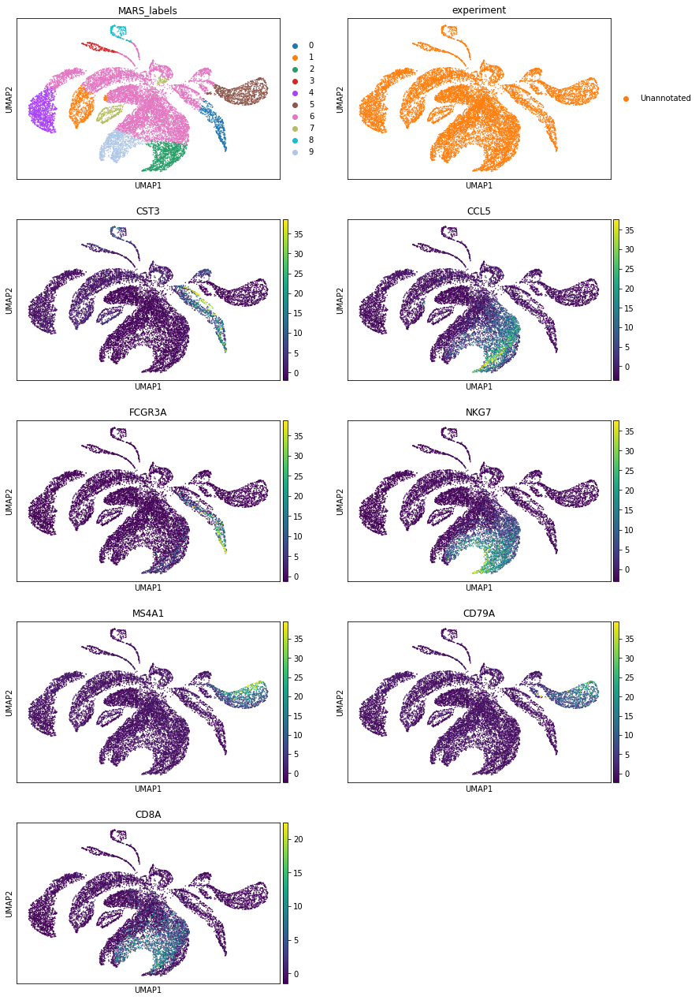

In [28]:
MARS_latent_umap(adata_smalltau4, plot_gene_list = ['MARS_labels','experiment',
                                              'CST3','CCL5','FCGR3A','NKG7','MS4A1','CD79A','CD8A'])

In [19]:
mars_smalltau = VAE_MARS(n_clusters, params, [annotated] , unannotated, pretrain, 
                
                ##These are roll over parametesr form original model 
                hid_dim_1=1000, hid_dim_2=100, p_drop=0.0, tau=0.01,
                
                ##VAE MARS specific parameters
                latent_dim = 50 , n_feature = len(mit_data.var_names), 
                
                network_architecture={"n_hidden_recog_1": 250, "n_hidden_recog_2": 100,
                           "n_hidden_recog_3": 100, "n_hidden_gener_1": 100,
                           "n_hidden_gener_2": 100, "n_hidden_gener_3": 100},
                
                lambda_reconstruct = 1, lambda_kl = 1e-3)

adata_smalltau, landmarks_smalltau, scores_smalltau , training_history_smalltau, latent_tracker_smalltau, pretrain_latent_smalltau , pretrain_loss_smalltau = mars_smalltau.train(evaluation_mode=True,
save_all_embeddings=True)

Pretraining..
Pretraining Epoch 0, Loss: 2556.629150390625
Time:  1.036365032196045
Pretraining Epoch 1, Loss: 4230.29736328125
Time:  1.0418121814727783
Pretraining Epoch 2, Loss: 5266.5830078125
Time:  1.1590759754180908
Pretraining Epoch 3, Loss: 11397.38671875
Time:  1.2544565200805664
Pretraining Epoch 4, Loss: 7265.583984375
Time:  1.2740015983581543
Pretraining Epoch 5, Loss: 7165.07666015625
Time:  1.224851369857788
Pretraining Epoch 6, Loss: 3822.02001953125
Time:  1.0582518577575684
Pretraining Epoch 7, Loss: 6260.81982421875
Time:  1.0128791332244873
Pretraining Epoch 8, Loss: 4765.84423828125
Time:  1.1035652160644531
Pretraining Epoch 9, Loss: 5129.873046875
Time:  1.302459478378296
Pretraining Epoch 10, Loss: 5573.896484375
Time:  1.2371792793273926
Pretraining Epoch 11, Loss: 12901.95703125
Time:  1.2808938026428223
Pretraining Epoch 12, Loss: 3558.957275390625
Time:  1.0663585662841797
Pretraining Epoch 13, Loss: 4876.45654296875
Time:  1.0766537189483643
Pretraining Ep

/home/estelle860530/anaconda3/lib/python3.8/site-packages/sklearn/utils/validation.py:67: FutureWarning: Pass labels=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9] as keyword args. From version 0.25 passing these as positional arguments will result in an error
  warnings.warn("Pass {} as keyword args. From version 0.25 "
/home/estelle860530/anaconda3/lib/python3.8/site-packages/sklearn/utils/validation.py:67: FutureWarning: Pass labels=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9] as keyword args. From version 0.25 passing these as positional arguments will result in an error
  warnings.warn("Pass {} as keyword args. From version 0.25 "


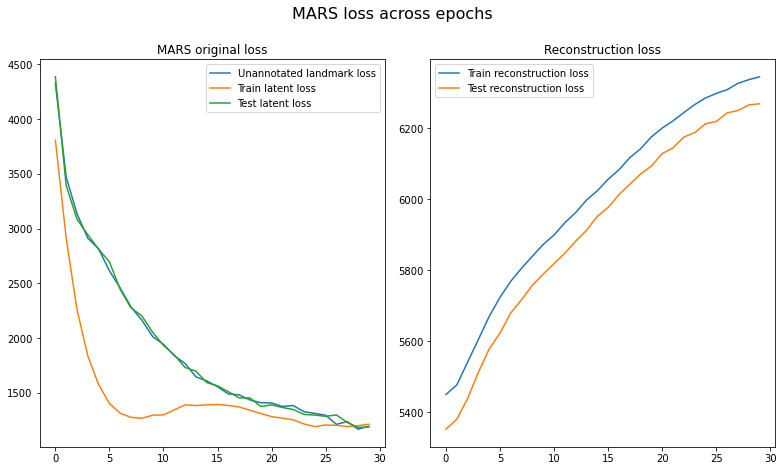

In [20]:
MARS_loss_tracker (training_history_smalltau)

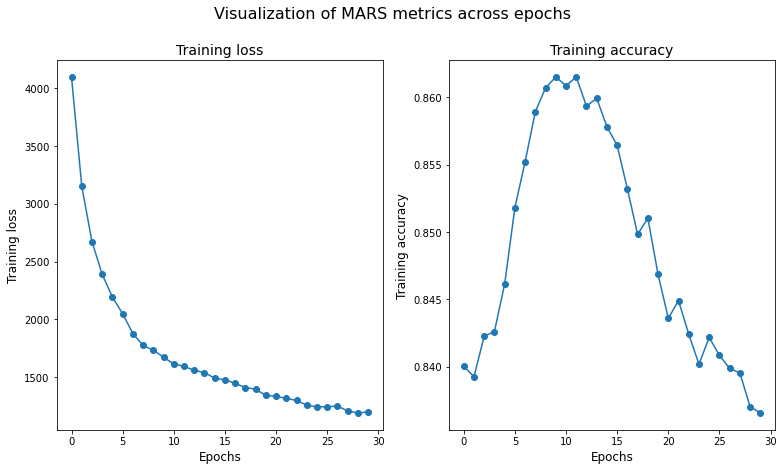

In [21]:
MARS_history(training_history_smalltau)

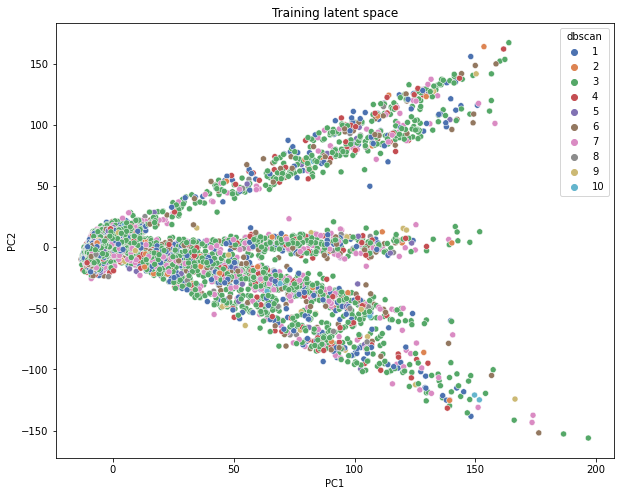

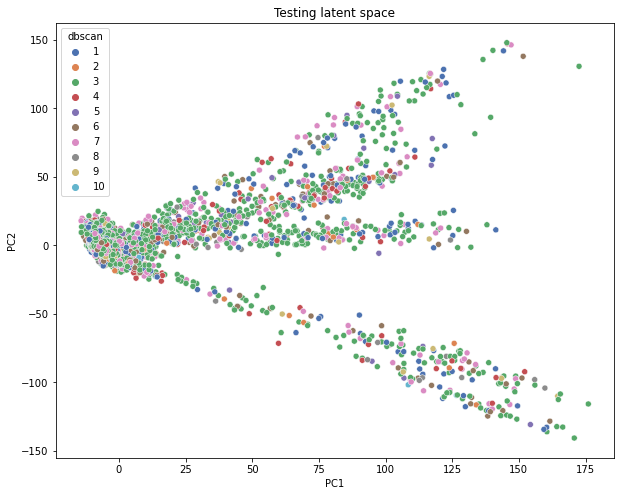

In [22]:
MARS_latent_pca(latent_tracker_smalltau , 29)

... storing 'MARS_labels' as categorical


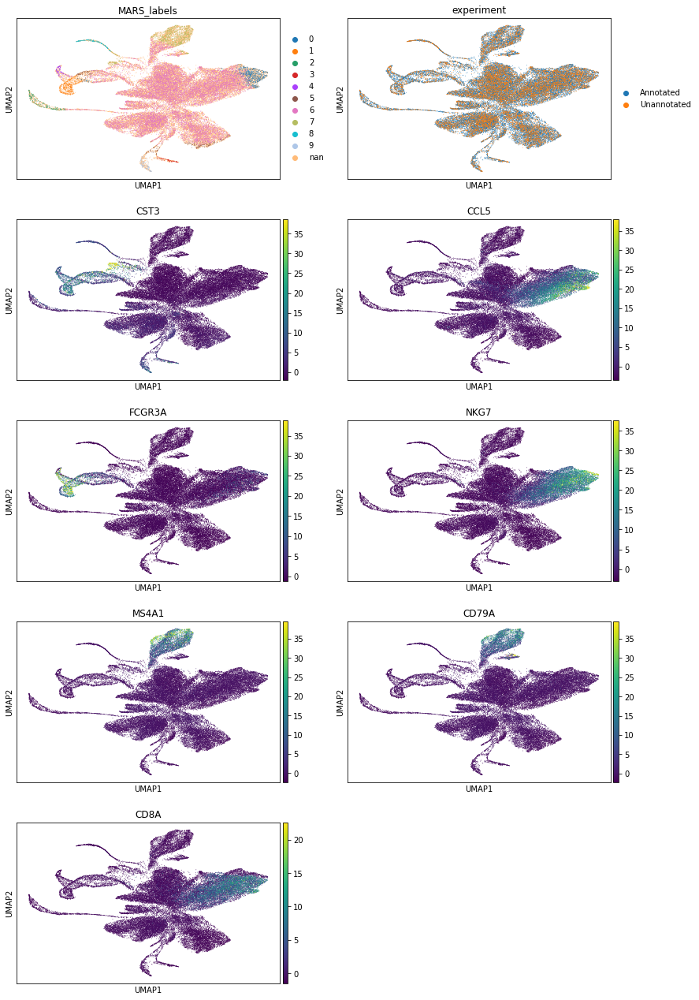

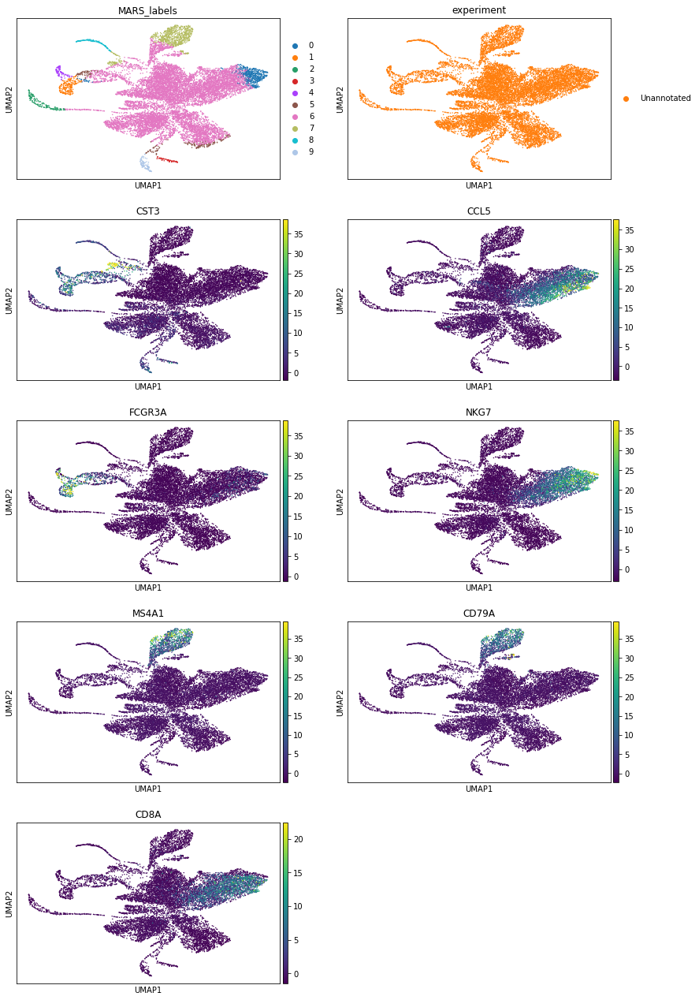

In [23]:
MARS_latent_umap(adata_smalltau, plot_gene_list = ['MARS_labels','experiment',
                                              'CST3','CCL5','FCGR3A','NKG7','MS4A1','CD79A','CD8A'])

In [24]:
mars_smalltau_largekl = VAE_MARS(n_clusters, params, [annotated] , unannotated, pretrain, 
                
                ##These are roll over parametesr form original model 
                hid_dim_1=1000, hid_dim_2=100, p_drop=0.0, tau=0.01,
                
                ##VAE MARS specific parameters
                latent_dim = 50 , n_feature = len(mit_data.var_names), 
                
                network_architecture={"n_hidden_recog_1": 250, "n_hidden_recog_2": 100,
                           "n_hidden_recog_3": 100, "n_hidden_gener_1": 100,
                           "n_hidden_gener_2": 100, "n_hidden_gener_3": 100},
                
                lambda_reconstruct = 1, lambda_kl = 0.1)

adata_smalltau_largekl, landmarks_smalltau_largekl, scores_smalltau_largekl , training_history_smalltau_largekl, latent_tracker_smalltau_largekl, pretrain_latent_smalltau_largekl , pretrain_loss_smalltau_largekl = mars_smalltau_largekl.train(evaluation_mode=True,
save_all_embeddings=True)

Pretraining..
Pretraining Epoch 0, Loss: 16534.01171875
Time:  1.503309965133667
Pretraining Epoch 1, Loss: 17899.369140625
Time:  1.4935011863708496
Pretraining Epoch 2, Loss: 4389.13330078125
Time:  1.5038673877716064
Pretraining Epoch 3, Loss: 9241.57421875
Time:  1.4771640300750732
Pretraining Epoch 4, Loss: 6228.78173828125
Time:  1.5527348518371582
Pretraining Epoch 5, Loss: 6270.955078125
Time:  1.4549806118011475
Pretraining Epoch 6, Loss: 11486.3251953125
Time:  1.5306780338287354
Pretraining Epoch 7, Loss: 4084.508544921875
Time:  1.6300196647644043
Pretraining Epoch 8, Loss: 3440.713623046875
Time:  1.5691757202148438
Pretraining Epoch 9, Loss: 3436.664794921875
Time:  1.6205167770385742
Pretraining Epoch 10, Loss: 4043.329345703125
Time:  1.5346739292144775
Pretraining Epoch 11, Loss: 4403.67529296875
Time:  1.5975780487060547
Pretraining Epoch 12, Loss: 1948.7330322265625
Time:  1.5109941959381104
Pretraining Epoch 13, Loss: 3910.69287109375
Time:  1.423004388809204
Pretra

/home/estelle860530/anaconda3/lib/python3.8/site-packages/sklearn/utils/validation.py:67: FutureWarning: Pass labels=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9] as keyword args. From version 0.25 passing these as positional arguments will result in an error
  warnings.warn("Pass {} as keyword args. From version 0.25 "
/home/estelle860530/anaconda3/lib/python3.8/site-packages/sklearn/utils/validation.py:67: FutureWarning: Pass labels=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9] as keyword args. From version 0.25 passing these as positional arguments will result in an error
  warnings.warn("Pass {} as keyword args. From version 0.25 "


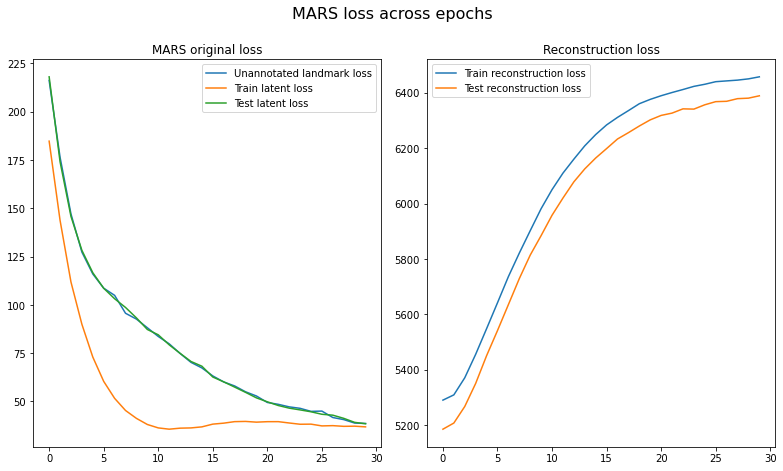

In [25]:
MARS_loss_tracker (training_history_smalltau_largekl)

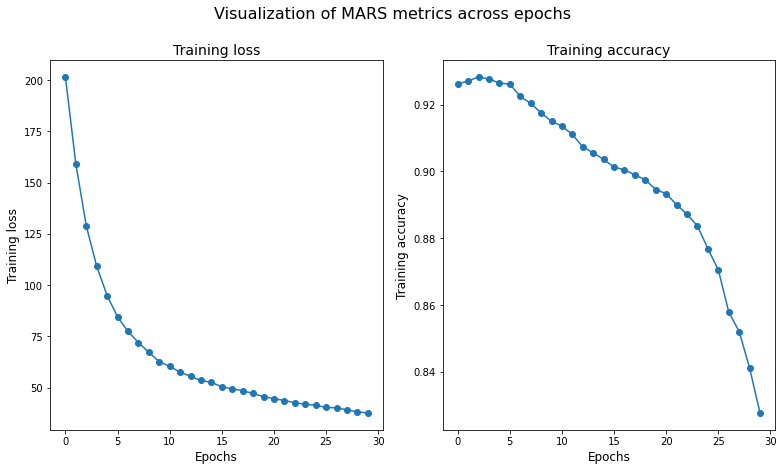

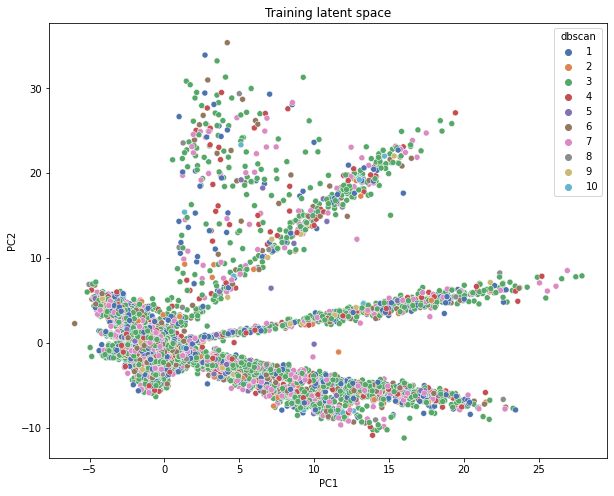

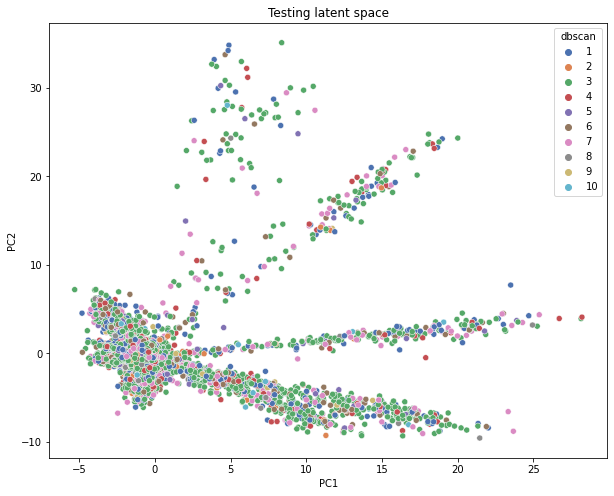

... storing 'MARS_labels' as categorical


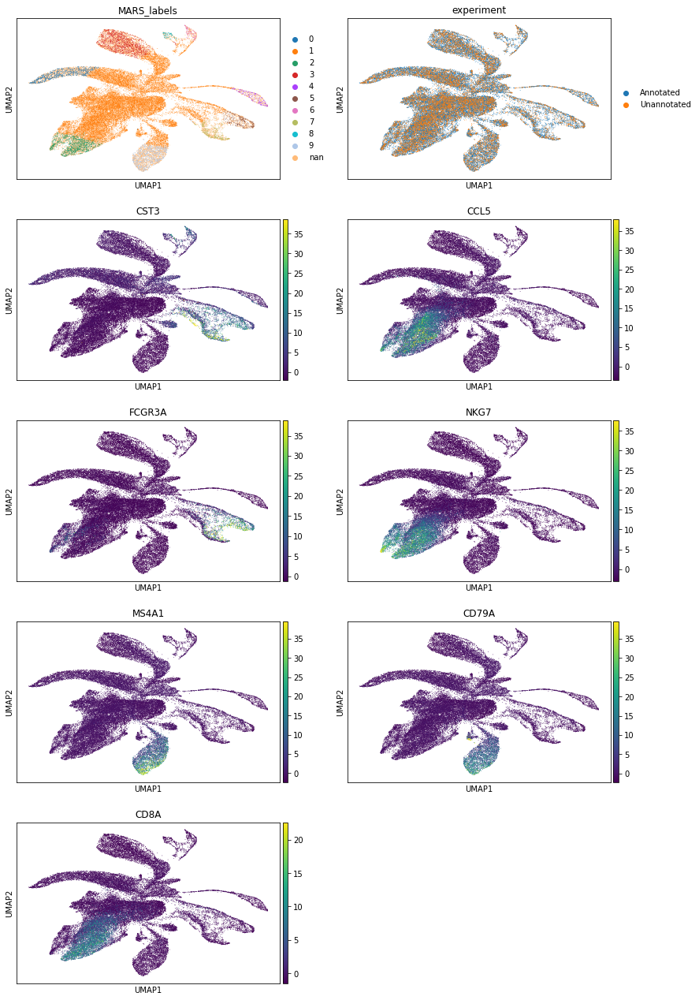

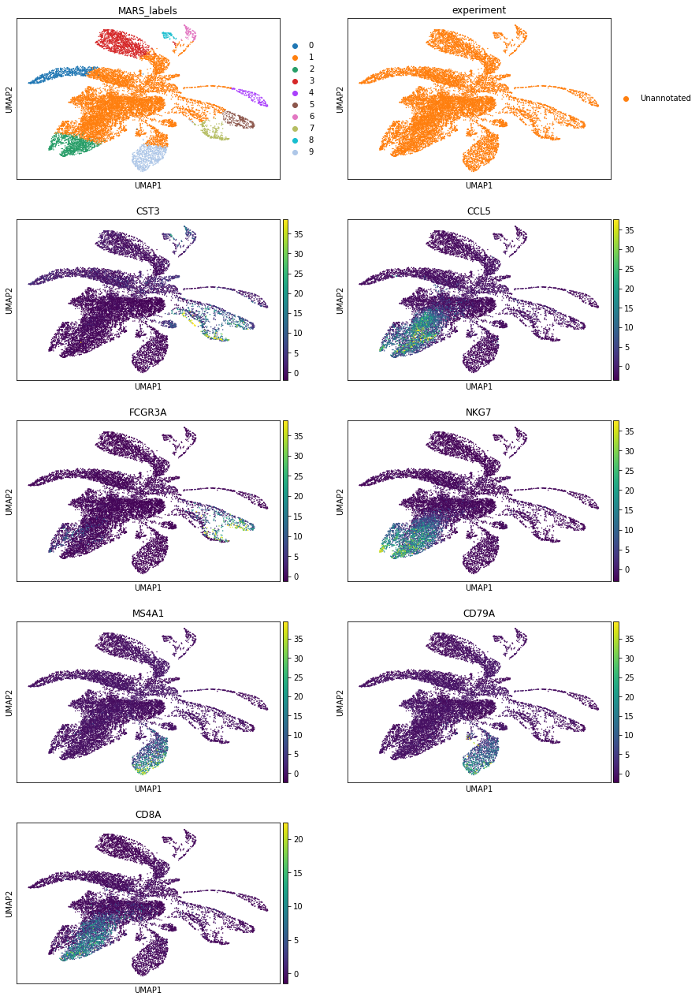

In [26]:
MARS_history(training_history_smalltau_largekl)
MARS_latent_pca(latent_tracker_smalltau_largekl , 29)
MARS_latent_umap(adata_smalltau_largekl, plot_gene_list = ['MARS_labels','experiment',
                                              'CST3','CCL5','FCGR3A','NKG7','MS4A1','CD79A','CD8A'])

In [13]:
mars = VAE_MARS(n_clusters, params, [annotated] , unannotated, pretrain, 
                
                ##These are roll over parametesr form original model 
                hid_dim_1=1000, hid_dim_2=100, p_drop=0.0, tau=0.2,
                
                ##VAE MARS specific parameters
                latent_dim = 50 , n_feature = len(mit_data.var_names), 
                
                network_architecture={"n_hidden_recog_1": 250, "n_hidden_recog_2": 100,
                           "n_hidden_recog_3": 100, "n_hidden_gener_1": 100,
                           "n_hidden_gener_2": 100, "n_hidden_gener_3": 100},
                
                lambda_reconstruct = 1, lambda_kl = 4)

adata, landmarks, scores , training_history, latent_tracker, pretrain_latent , pretrain_loss = mars.train(evaluation_mode=True, 
                                                                                                          save_all_embeddings=True)

Pretraining..
Pretraining Epoch 0, Loss: 1498.7635498046875
Time:  2.18672251701355
Pretraining Epoch 1, Loss: 333.28289794921875
Time:  2.289793014526367
Pretraining Epoch 2, Loss: 320.56182861328125
Time:  2.464048147201538
Pretraining Epoch 3, Loss: 317.9301452636719
Time:  2.6011712551116943
Pretraining Epoch 4, Loss: 317.47296142578125
Time:  2.3130908012390137
Pretraining Epoch 5, Loss: 315.8866882324219
Time:  2.5296900272369385
Pretraining Epoch 6, Loss: 318.5193786621094
Time:  2.794390916824341
Pretraining Epoch 7, Loss: 322.1216735839844
Time:  2.544921398162842
Pretraining Epoch 8, Loss: 317.6060485839844
Time:  2.1227457523345947
Pretraining Epoch 9, Loss: 313.8947448730469
Time:  2.395045757293701
Pretraining Epoch 10, Loss: 316.8215637207031
Time:  2.0701489448547363
Pretraining Epoch 11, Loss: 315.01513671875
Time:  2.179347038269043
Pretraining Epoch 12, Loss: 315.65081787109375
Time:  2.000282049179077
Pretraining Epoch 13, Loss: 314.102783203125
Time:  1.911762475967

/home/estelle860530/anaconda3/lib/python3.8/site-packages/sklearn/utils/validation.py:67: FutureWarning: Pass labels=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9] as keyword args. From version 0.25 passing these as positional arguments will result in an error
  warnings.warn("Pass {} as keyword args. From version 0.25 "
/home/estelle860530/anaconda3/lib/python3.8/site-packages/sklearn/utils/validation.py:67: FutureWarning: Pass labels=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9] as keyword args. From version 0.25 passing these as positional arguments will result in an error
  warnings.warn("Pass {} as keyword args. From version 0.25 "
/home/estelle860530/anaconda3/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1221: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


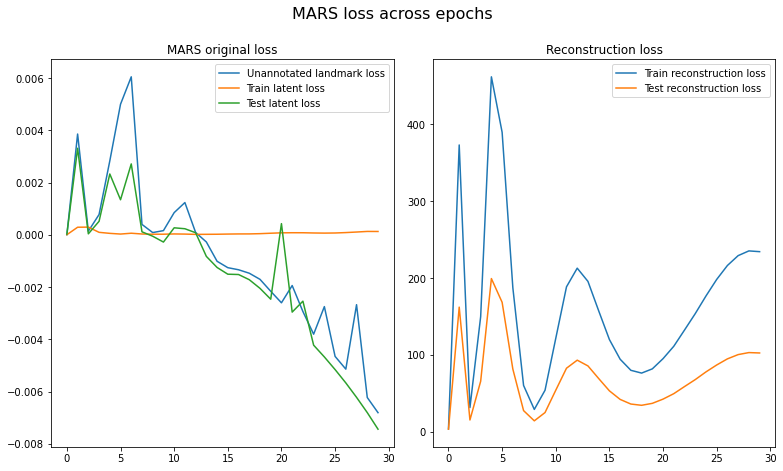

In [14]:
MARS_loss_tracker (training_history)

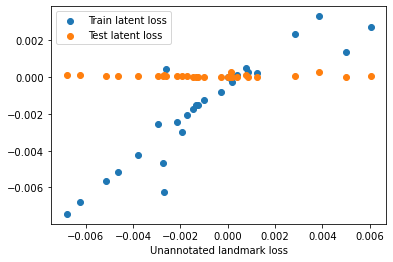

In [43]:
temp = pd.DataFrame(training_history['Loss_tracker'])
plt.scatter(temp['Test_anno'], temp['Test_latent_loss'], label ="Train latent loss")
plt.scatter(temp['Test_anno'], temp['Train_latent_loss'], label= "Test latent loss")
plt.xlabel("Unannotated landmark loss")
plt.legend()

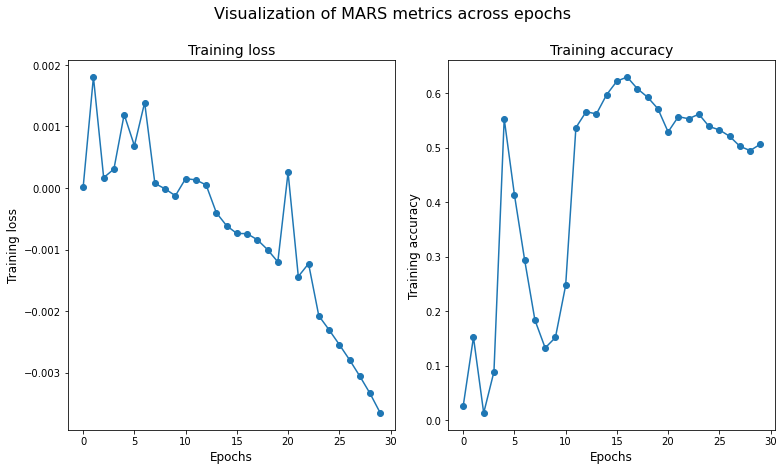

In [15]:
MARS_history(training_history)

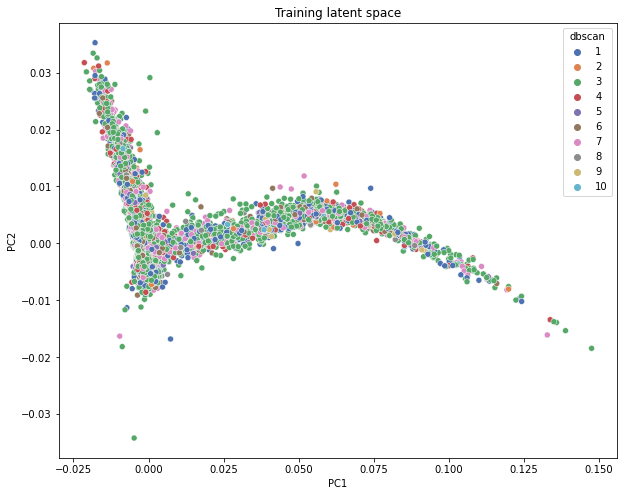

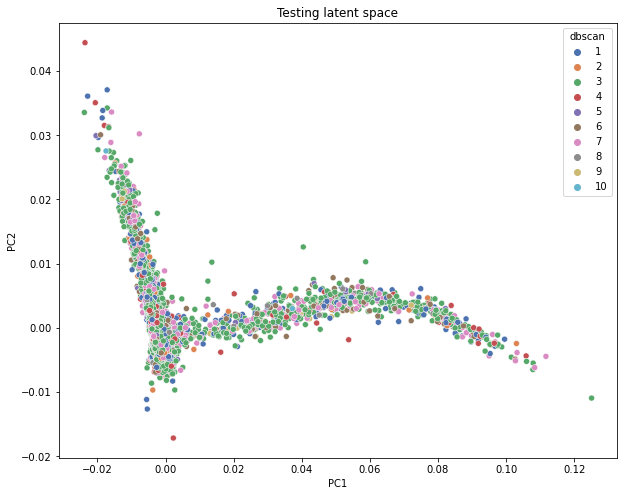

In [16]:
MARS_latent_pca(latent_tracker , 29)

... storing 'MARS_labels' as categorical


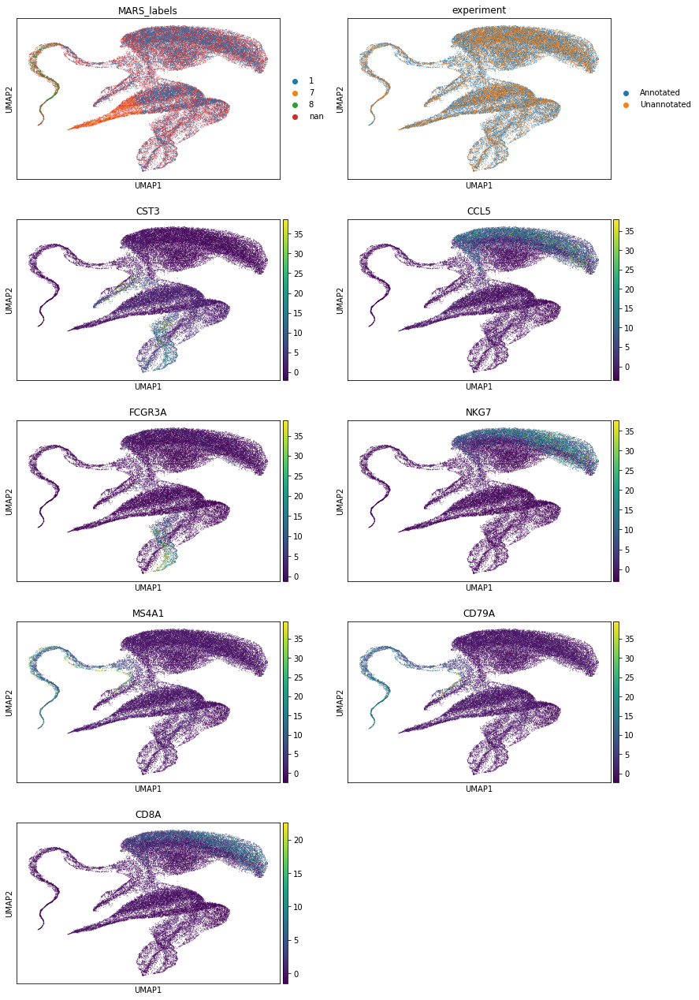

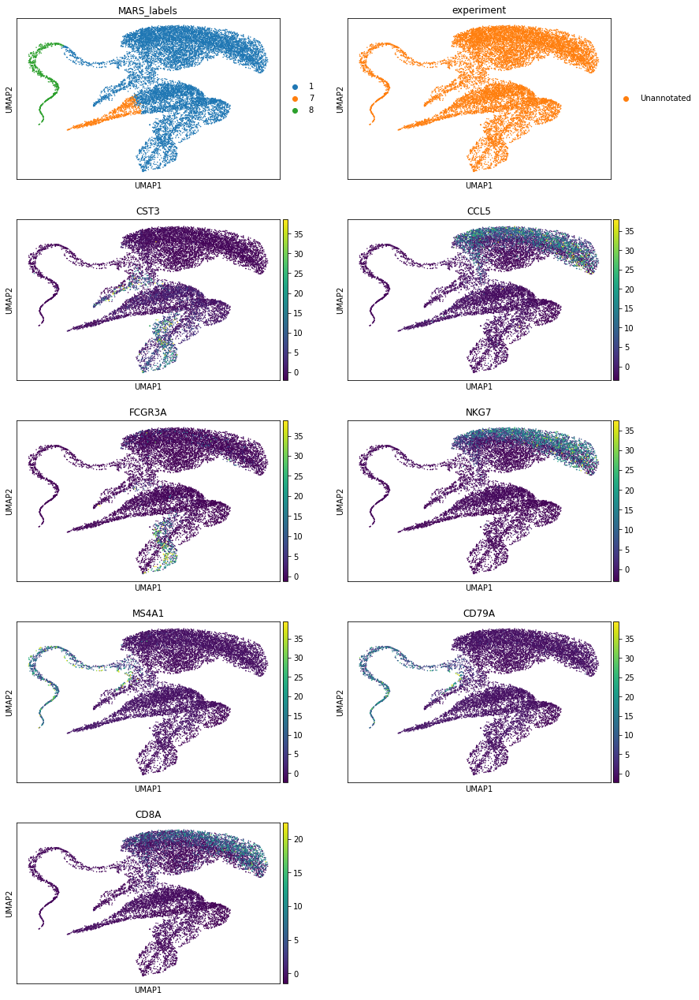

In [17]:
MARS_latent_umap(adata, plot_gene_list = ['MARS_labels','experiment',
                                              'CST3','CCL5','FCGR3A','NKG7','MS4A1','CD79A','CD8A'])

In [13]:
mars = VAE_MARS(n_clusters, params, [annotated] , unannotated, pretrain, 
                
                ##These are roll over parametesr form original model 
                hid_dim_1=1000, hid_dim_2=100, p_drop=0.0, tau=0.2,
                
                ##VAE MARS specific parameters
                latent_dim = 50 , n_feature = len(mit_data.var_names), 
                
                network_architecture={"n_hidden_recog_1": 250, "n_hidden_recog_2": 100,
                           "n_hidden_recog_3": 100, "n_hidden_gener_1": 100,
                           "n_hidden_gener_2": 100, "n_hidden_gener_3": 100},
                
                lambda_reconstruct = 1, lambda_kl = 1e-3)

adata, landmarks, scores , training_history, latent_tracker, pretrain_latent , pretrain_loss = mars.train(evaluation_mode=True, 
                                                                                                          save_all_embeddings=True)

Pretraining..
Pretraining Epoch 0, Loss: 311.7762451171875
Time:  1.3695015907287598
Pretraining Epoch 1, Loss: 311.4972839355469
Time:  1.1227595806121826
Pretraining Epoch 2, Loss: 314.10748291015625
Time:  1.042219638824463
Pretraining Epoch 3, Loss: 312.3345031738281
Time:  1.0903010368347168
Pretraining Epoch 4, Loss: 312.83026123046875
Time:  1.0493767261505127
Pretraining Epoch 5, Loss: 311.800048828125
Time:  1.0450408458709717
Pretraining Epoch 6, Loss: 312.3423767089844
Time:  1.0676374435424805
Pretraining Epoch 7, Loss: 314.4017333984375
Time:  1.0997648239135742
Pretraining Epoch 8, Loss: 314.4751892089844
Time:  1.098292350769043
Pretraining Epoch 9, Loss: 311.6427307128906
Time:  1.0436322689056396
Pretraining Epoch 10, Loss: 321.7815246582031
Time:  1.06868314743042
Pretraining Epoch 11, Loss: 312.46002197265625
Time:  1.0501677989959717
Pretraining Epoch 12, Loss: 314.7911682128906
Time:  1.0484263896942139
Pretraining Epoch 13, Loss: 311.60858154296875
Time:  1.070401

/home/estelle860530/anaconda3/lib/python3.8/site-packages/sklearn/utils/validation.py:67: FutureWarning: Pass labels=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9] as keyword args. From version 0.25 passing these as positional arguments will result in an error
  warnings.warn("Pass {} as keyword args. From version 0.25 "
/home/estelle860530/anaconda3/lib/python3.8/site-packages/sklearn/utils/validation.py:67: FutureWarning: Pass labels=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9] as keyword args. From version 0.25 passing these as positional arguments will result in an error
  warnings.warn("Pass {} as keyword args. From version 0.25 "
/home/estelle860530/anaconda3/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1221: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


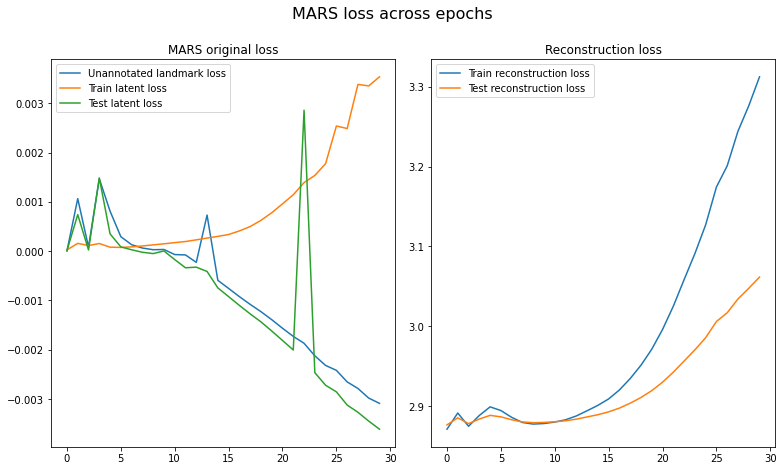

In [14]:
MARS_loss_tracker (training_history)

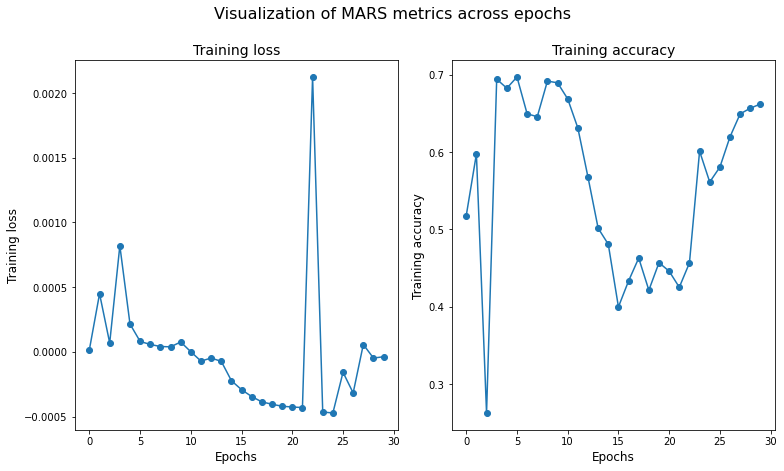

In [15]:
MARS_history(training_history)

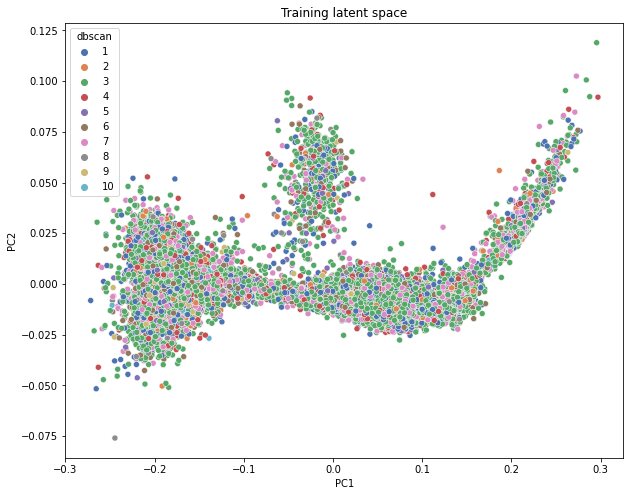

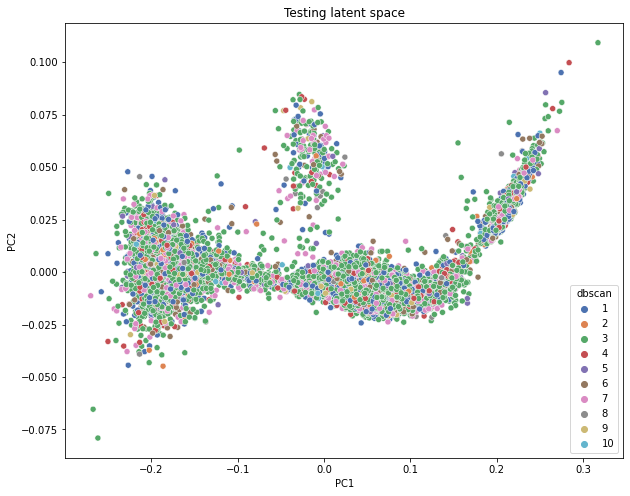

In [16]:
MARS_latent_pca(latent_tracker , 29)

... storing 'MARS_labels' as categorical


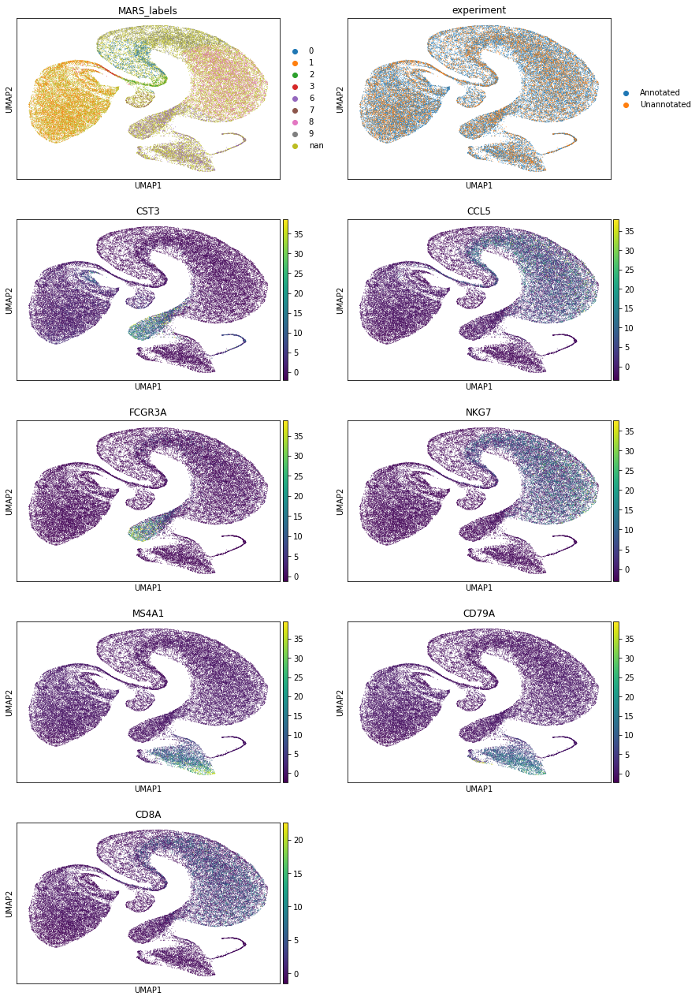

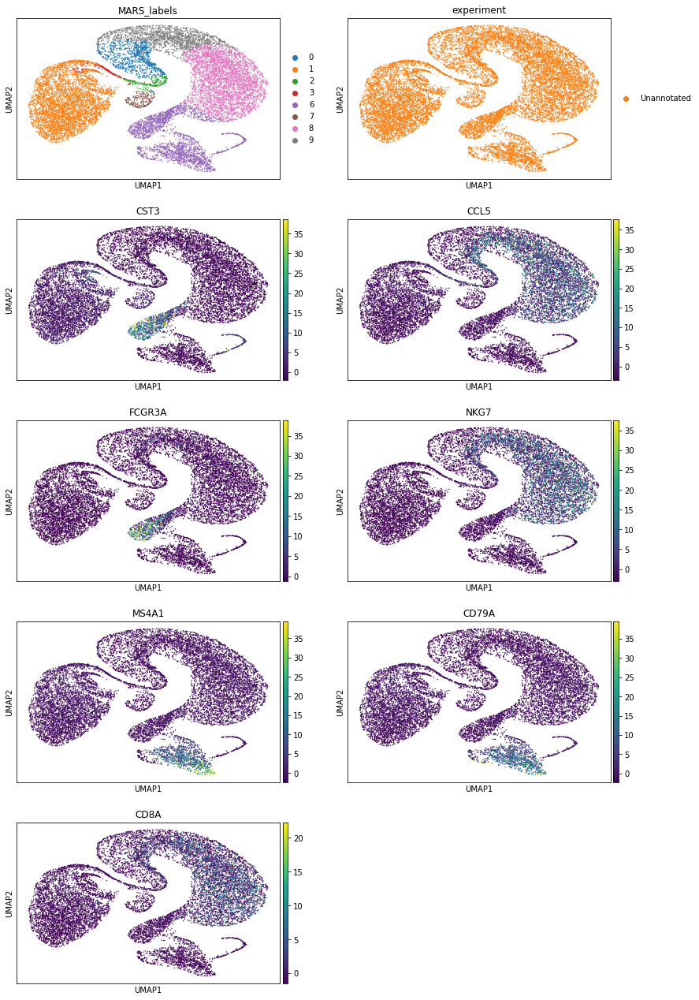

In [17]:
MARS_latent_umap(adata, plot_gene_list = ['MARS_labels','experiment',
                                              'CST3','CCL5','FCGR3A','NKG7','MS4A1','CD79A','CD8A'])

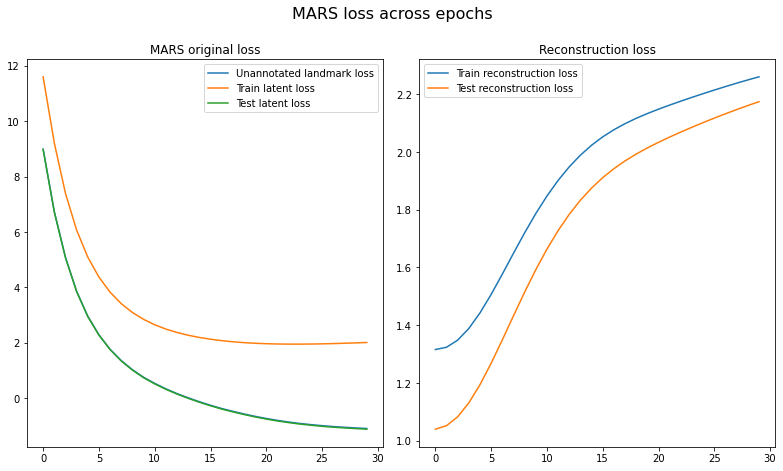

In [14]:
MARS_loss_tracker (ae_training_history)

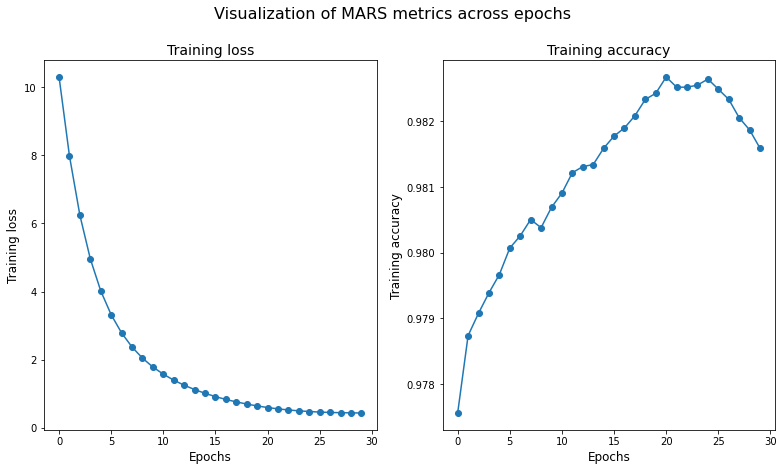

In [16]:
MARS_history(ae_training_history)

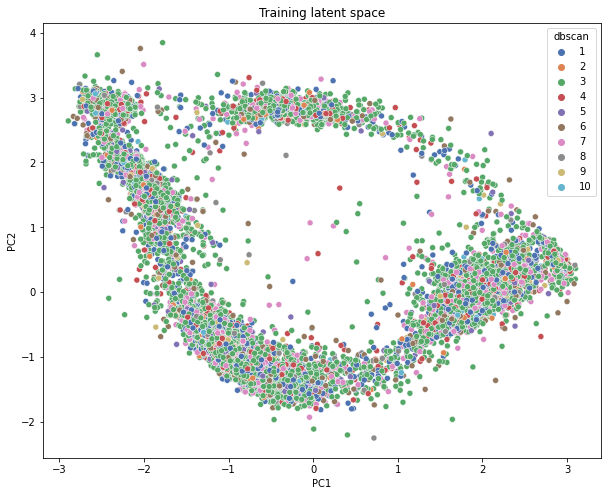

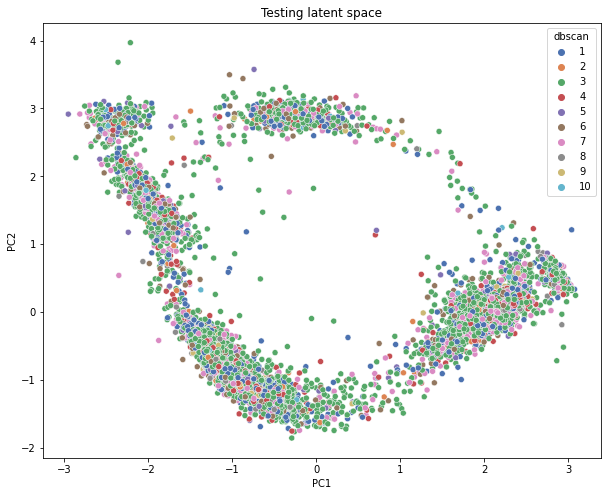

In [17]:
MARS_latent_pca(ae_latent_tracker , 29)

... storing 'MARS_labels' as categorical


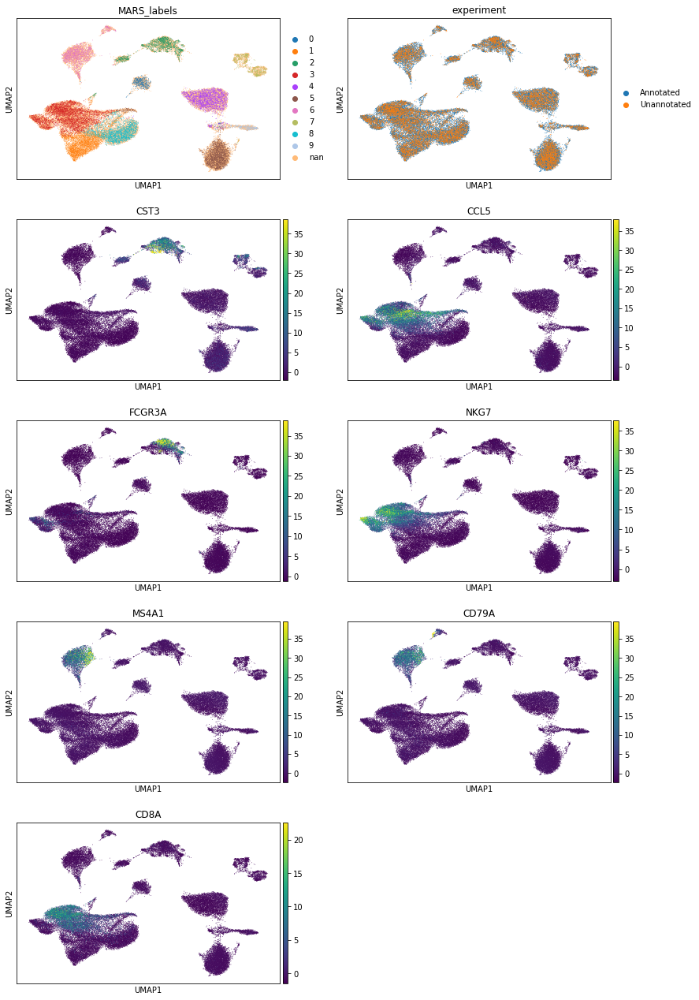

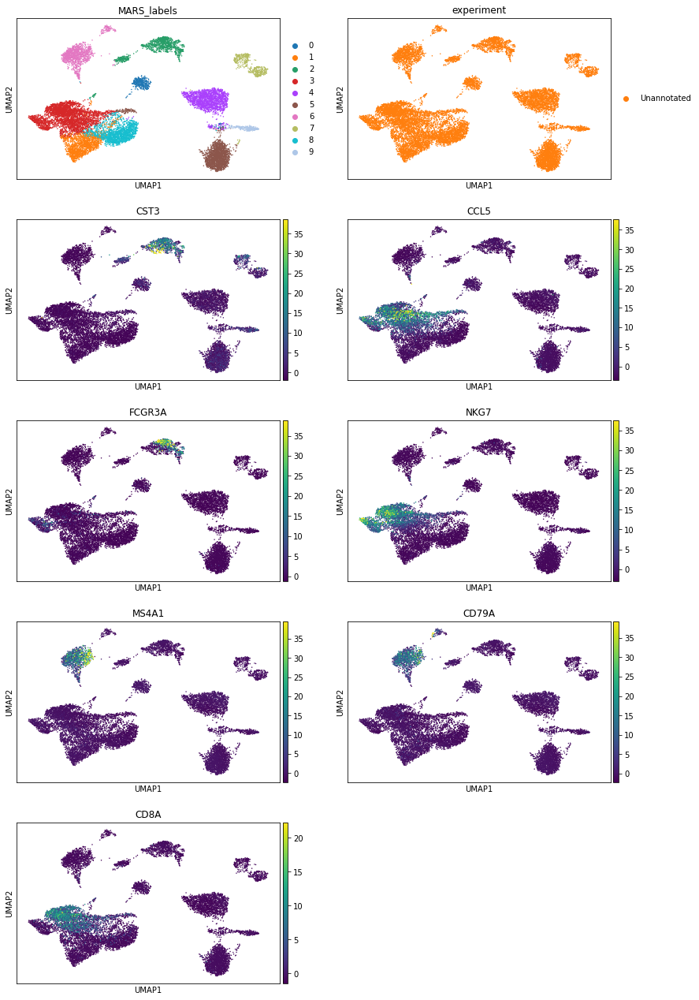

In [18]:
MARS_latent_umap(ae_adata, plot_gene_list = ['MARS_labels','experiment',
                                              'CST3','CCL5','FCGR3A','NKG7','MS4A1','CD79A','CD8A'])